In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.7/35.7 MB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 4.5 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4.25.3 which is incompatible.


In [ ]:
# Import Important Libraries
import cv2
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow

In [ ]:
# Import Mediapipe libraries
import mediapipe as mp
from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

In [ ]:
mp_hands = mp.solutions.hands
hands = mp_hands.Hands(static_image_mode=True, max_num_hands=2, min_detection_confidence=0.5)
mp_drawing = mp.solutions.drawing_utils

In [ ]:
# Function to process an image
def draw_landmarks(image_path):
  image = cv2.imread(image_path)
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  results = hands.process(image_rgb)

  # Draw landmarks
  if results.multi_hand_landmarks:
    for hand_landmarks in results.multi_hand_landmarks:
      mp_drawing.draw_landmarks(image, hand_landmarks, mp_hands.HAND_CONNECTIONS)
  return image

##**Using all keypoints**

In [ ]:
def extract_all_landmarks(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = hands.process(image_rgb)

    indices_to_extract = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
    landmark_names = {
          0: 'wrist',
          1: 'thumb_cmc',
          2: 'thumb_mcp',
          3: 'thumb_ip',
          4: 'thumb_tip',
          5: 'index_finger_mcp',
          6: 'index_finger_pip',
          7: 'index_finger_dip',
          8: 'index_finger_tip',
          9: 'middle_finger_mcp',
          10: 'middle_finger_pip',
          11: 'middle_finger_dip',
          12: 'middle_finger_tip',
          13: 'ring_finger_mcp',
          14: 'ring_finger_pip',
          15: 'ring_finger_dip',
          16: 'ring_finger_tip',
          17: 'pinky_mcp',
          18: 'pinky_pip',
          19: 'pinky_dip',
          20: 'pink_tip'
    }

    landmarks_data = []
    if results.multi_hand_landmarks:
        num_hands = min(2, len(results.multi_hand_landmarks))  # Maximum 2 hands
        for hand_idx in range(num_hands):
            landmarks = {}
            hand_landmarks = results.multi_hand_landmarks[hand_idx]
            for idx, landmark in enumerate(hand_landmarks.landmark):
                if idx in indices_to_extract:
                    landmark_name = landmark_names[idx]
                    landmarks[f'hand_{hand_idx}_{landmark_name}'] = {
                        'X': landmark.x,
                        'Y': landmark.y,
                        'Z': landmark.z if hasattr(landmark, 'z') else None
                    }
            landmarks_data.append(landmarks)
    return landmarks_data

###**Line Plot**

####**Correct Hand Postures**

In [ ]:
sample_correct1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/CORRECT/Correct2_frame_0001.jpg'

In [ ]:
sample_correct1_landmarks = extract_all_landmarks(sample_correct1)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.224325,0.323606,3.360456e-07,0
1,hand_0_thumb_cmc,0.317318,0.284994,-1.561467e-02,0
2,hand_0_thumb_mcp,0.380711,0.362670,-2.175540e-02,0
3,hand_0_thumb_ip,0.414357,0.479578,-2.202252e-02,0
4,hand_0_thumb_tip,0.443843,0.561872,-2.078318e-02,0
5,hand_0_index_finger_mcp,0.351751,0.534611,-3.185405e-02,0
6,hand_0_index_finger_pip,0.405550,0.665702,-4.125535e-02,0
7,hand_0_index_finger_dip,0.433288,0.731836,-4.251039e-02,0
8,hand_0_index_finger_tip,0.454765,0.774829,-4.095697e-02,0
9,hand_0_middle_finger_mcp,0.297401,0.587112,-2.990964e-02,0


In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

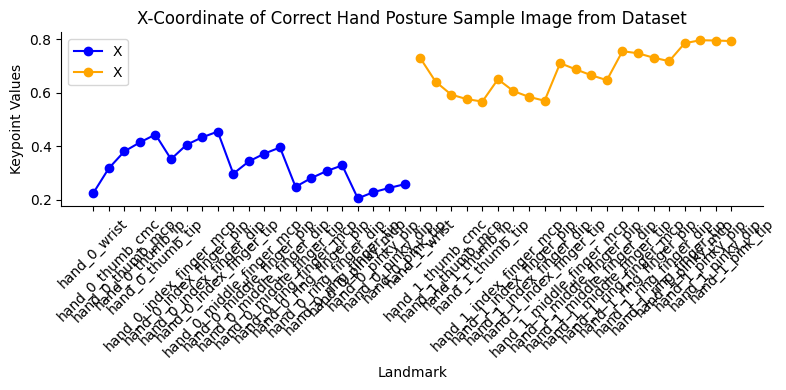

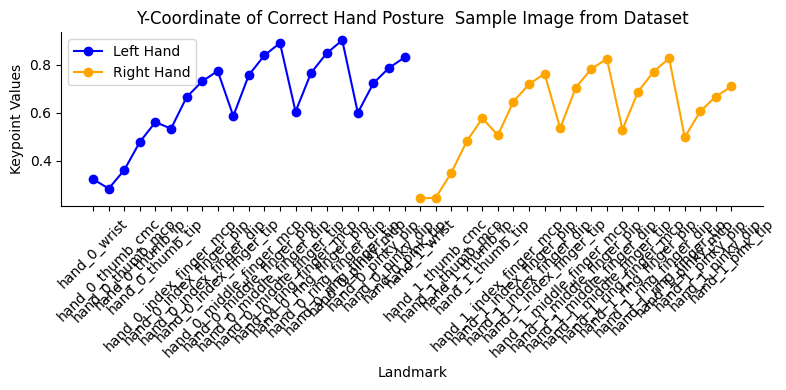

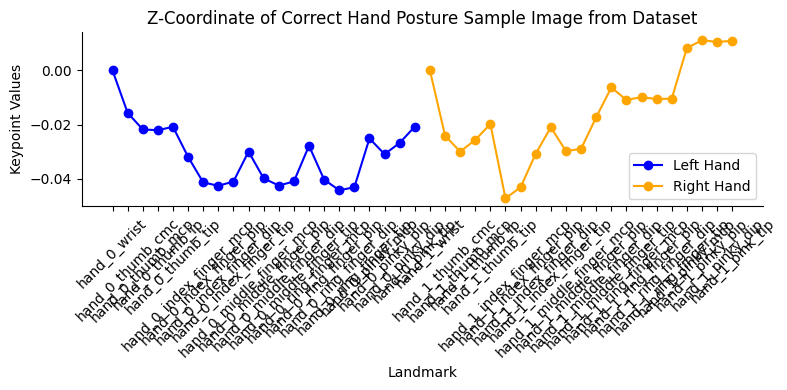

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Correct Hand Posture Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Correct Hand Posture  Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Correct Hand Posture Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

###**Incorrect Hand Postures**

In [ ]:
sample_incorrect1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/INCORRECT/Incorrect1_frame_0001.jpg'

In [ ]:
sample_incorrect1_landmarks = extract_all_landmarks(sample_incorrect1)

In [ ]:
import pandas as pd
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.821956,0.355293,7.258707e-07,0
1,hand_0_thumb_cmc,0.750419,0.323031,-3.557569e-02,0
2,hand_0_thumb_mcp,0.682500,0.360015,-5.882220e-02,0
3,hand_0_thumb_ip,0.628163,0.444230,-6.991024e-02,0
4,hand_0_thumb_tip,0.596290,0.535047,-7.988273e-02,0
5,hand_0_index_finger_mcp,0.709672,0.515423,-9.599959e-02,0
6,hand_0_index_finger_pip,0.619774,0.634747,-1.111995e-01,0
7,hand_0_index_finger_dip,0.576076,0.688991,-1.054513e-01,0
8,hand_0_index_finger_tip,0.547679,0.718047,-9.572124e-02,0
9,hand_0_middle_finger_mcp,0.750104,0.578166,-7.785048e-02,0


In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

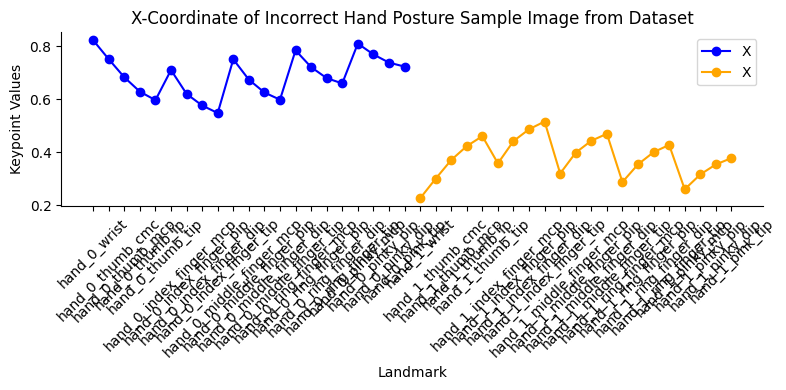

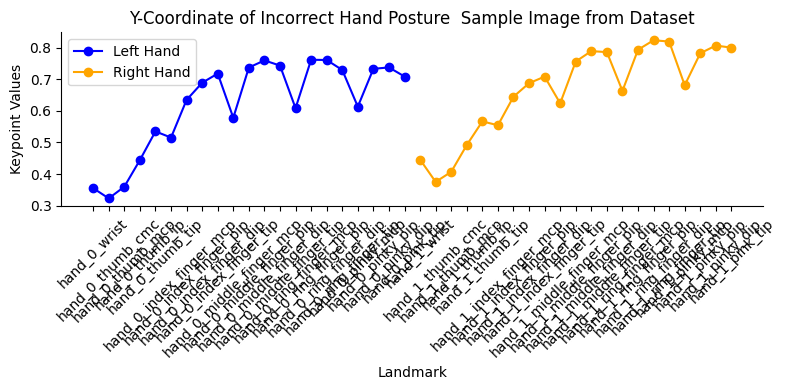

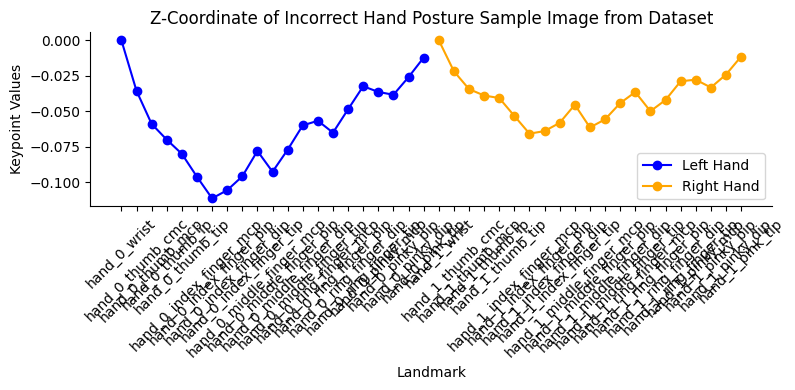

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Incorrect Hand Posture Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Incorrect Hand Posture  Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Incorrect Hand Posture Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.legend()
plt.tight_layout()
plt.show()

###**Heatmap**

####**Correct Hand Postures**

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/CORRECT/Correct2_frame_0001.jpg'
sample_correct5_landmarks = extract_all_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.224325,0.323606,3.360456e-07,0
1,hand_0_thumb_cmc,0.317318,0.284994,-1.561467e-02,0
2,hand_0_thumb_mcp,0.380711,0.362670,-2.175540e-02,0
3,hand_0_thumb_ip,0.414357,0.479578,-2.202252e-02,0
4,hand_0_thumb_tip,0.443843,0.561872,-2.078318e-02,0
5,hand_0_index_finger_mcp,0.351751,0.534611,-3.185405e-02,0
6,hand_0_index_finger_pip,0.405550,0.665702,-4.125535e-02,0
7,hand_0_index_finger_dip,0.433288,0.731836,-4.251039e-02,0
8,hand_0_index_finger_tip,0.454765,0.774829,-4.095697e-02,0
9,hand_0_middle_finger_mcp,0.297401,0.587112,-2.990964e-02,0


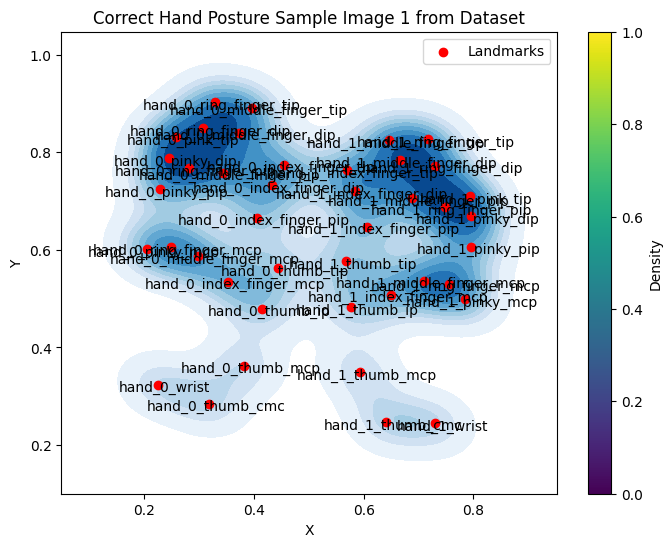

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Sample Image 1 from Dataset')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()


####**Correct Hand 2 Postures**

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/CORRECT/Correct2_frame_0009.jpg'
sample_correct5_landmarks = extract_all_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.247146,0.333349,4.462345e-07,0
1,hand_0_thumb_cmc,0.341137,0.289910,-1.275238e-02,0
2,hand_0_thumb_mcp,0.403734,0.370418,-1.914009e-02,0
3,hand_0_thumb_ip,0.438794,0.489702,-1.913262e-02,0
4,hand_0_thumb_tip,0.474040,0.559863,-1.808258e-02,0
5,hand_0_index_finger_mcp,0.382538,0.534044,-4.096295e-02,0
6,hand_0_index_finger_pip,0.435686,0.668371,-4.964020e-02,0
7,hand_0_index_finger_dip,0.462794,0.734954,-4.799353e-02,0
8,hand_0_index_finger_tip,0.483197,0.774907,-4.452519e-02,0
9,hand_0_middle_finger_mcp,0.327163,0.589105,-4.061226e-02,0


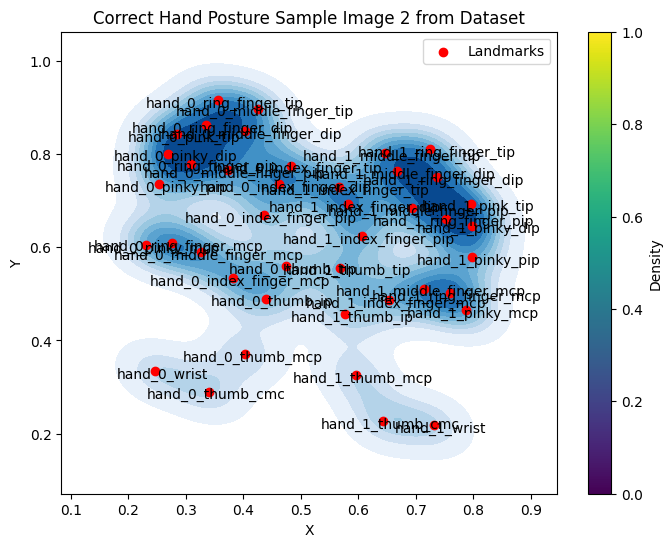

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Sample Image 2 from Dataset')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

####**Incorrect Hand Postures**

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/INCORRECT/Incorrect1_frame_0001.jpg'
sample_correct5_landmarks = extract_all_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.821956,0.355293,7.258707e-07,0
1,hand_0_thumb_cmc,0.750419,0.323031,-3.557569e-02,0
2,hand_0_thumb_mcp,0.682500,0.360015,-5.882220e-02,0
3,hand_0_thumb_ip,0.628163,0.444230,-6.991024e-02,0
4,hand_0_thumb_tip,0.596290,0.535047,-7.988273e-02,0
5,hand_0_index_finger_mcp,0.709672,0.515423,-9.599959e-02,0
6,hand_0_index_finger_pip,0.619774,0.634747,-1.111995e-01,0
7,hand_0_index_finger_dip,0.576076,0.688991,-1.054513e-01,0
8,hand_0_index_finger_tip,0.547679,0.718047,-9.572124e-02,0
9,hand_0_middle_finger_mcp,0.750104,0.578166,-7.785048e-02,0


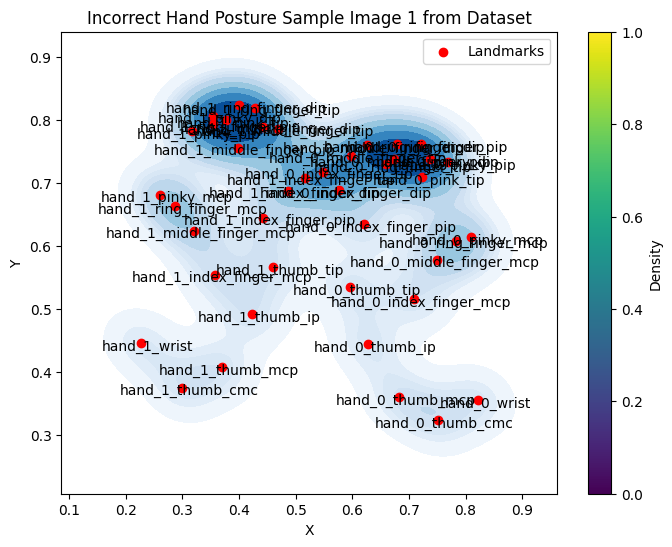

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Sample Image 1 from Dataset')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

####**Incorrect Hand 2 Postures**

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/FINAL HAND POSTURES DATASET/INCORRECT/Incorrect1_frame_0002.jpg'
sample_correct5_landmarks = extract_all_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.824244,0.359004,7.424126e-07,0
1,hand_0_thumb_cmc,0.752265,0.327080,-3.183498e-02,0
2,hand_0_thumb_mcp,0.685022,0.365783,-5.377545e-02,0
3,hand_0_thumb_ip,0.630441,0.446646,-6.475923e-02,0
4,hand_0_thumb_tip,0.601085,0.537694,-7.490981e-02,0
5,hand_0_index_finger_mcp,0.711991,0.520940,-9.008984e-02,0
6,hand_0_index_finger_pip,0.623007,0.635990,-1.046807e-01,0
7,hand_0_index_finger_dip,0.577273,0.686057,-9.850551e-02,0
8,hand_0_index_finger_tip,0.547682,0.710288,-8.799914e-02,0
9,hand_0_middle_finger_mcp,0.750839,0.582038,-7.377198e-02,0


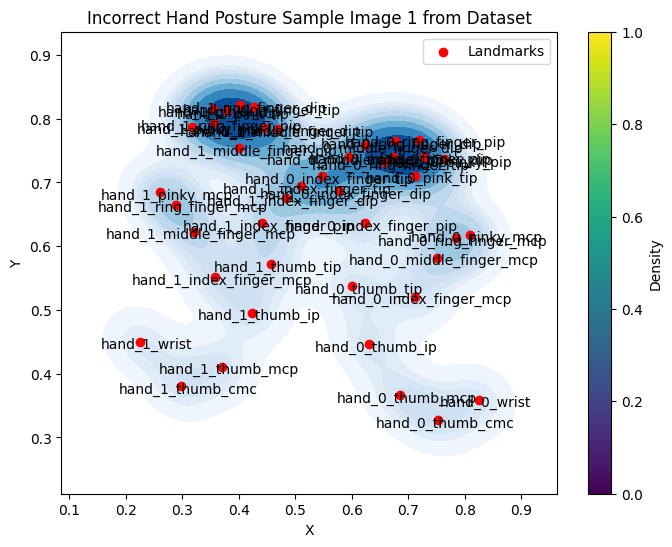

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Sample Image 1 from Dataset')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

#**Not all keypoints**

In [ ]:
def extract_landmarks(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = hands.process(image_rgb)

    indices_to_extract = [0, 1, 2, 5, 9, 13, 17]
    landmark_names = {
        0: 'wrist',
        1: 'thumb_cmc',
        2: 'thumb_mcp',
        5: 'index_finger_mcp',
        9: 'middle_finger_mcp',
        13: 'ring_finger_mcp',
        17: 'pinky_mcp',
    }
    # indices_to_extract = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
    # landmark_names = {
    #       0: 'wrist',
    #       1: 'thumb_cmc',
    #       2: 'thumb_mcp',
    #       3: 'thumb_ip',
    #       4: 'thumb_tip',
    #       5: 'index_finger_mcp',
    #       6: 'index_finger_pip',
    #       7: 'index_finger_dip',
    #       8: 'index_finger_tip',
    #       9: 'middle_finger_mcp',
    #       10: 'middle_finger_pip',
    #       11: 'middle_finger_dip',
    #       12: 'middle_finger_tip',
    #       13: 'ring_finger_mcp',
    #       14: 'ring_finger_pip',
    #       15: 'ring_finger_dip',
    #       16: 'ring_finger_tip',
    #       17: 'pinky_mcp',
    #       18: 'pinky_pip',
    #       19: 'pinky_dip',
    #       20: 'pink_tip'
    # }

    landmarks_data = []
    if results.multi_hand_landmarks:
        num_hands = min(2, len(results.multi_hand_landmarks))  # Maximum 2 hands
        for hand_idx in range(num_hands):
            landmarks = {}
            hand_landmarks = results.multi_hand_landmarks[hand_idx]
            for idx, landmark in enumerate(hand_landmarks.landmark):
                if idx in indices_to_extract:
                    landmark_name = landmark_names[idx]
                    landmarks[f'hand_{hand_idx}_{landmark_name}'] = {
                        'X': landmark.x,
                        'Y': landmark.y,
                        'Z': landmark.z if hasattr(landmark, 'z') else None
                    }
            landmarks_data.append(landmarks)
    return landmarks_data

# **Line Plot**

##**Correct Hand Postures**

###**Trial 1**

In [ ]:
correct_trial1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct1.png'
sample_correct1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/Dataset/Correct/correct 1.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial1)
sample_correct1_landmarks = extract_landmarks(sample_correct1)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.673473,0.757369,2.487139e-07,0
1,hand_0_thumb_cmc,0.598464,0.720091,-1.020750e-03,0
2,hand_0_thumb_mcp,0.558884,0.651862,-6.470237e-03,0
3,hand_0_index_finger_mcp,0.609882,0.577005,-4.761128e-02,0
4,hand_0_middle_finger_mcp,0.659385,0.565584,-4.296366e-02,0
5,hand_0_ring_finger_mcp,0.698515,0.570909,-3.310161e-02,0
6,hand_0_pinky_mcp,0.725505,0.585879,-2.022570e-02,0
7,hand_1_wrist,0.169701,0.757937,6.905858e-07,1
8,hand_1_thumb_cmc,0.233129,0.727115,-2.719184e-02,1
9,hand_1_thumb_mcp,0.273456,0.663256,-4.302248e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.724401,0.743751,1.570757e-07,0
1,hand_0_thumb_cmc,0.636886,0.696204,-3.834844e-03,0
2,hand_0_thumb_mcp,0.597064,0.582337,-1.713754e-03,0
3,hand_0_index_finger_mcp,0.654863,0.450459,-1.826064e-02,0
4,hand_0_middle_finger_mcp,0.708961,0.436267,-9.097598e-03,0
5,hand_0_ring_finger_mcp,0.748349,0.452099,2.231736e-03,0
6,hand_0_pinky_mcp,0.776966,0.485346,1.485993e-02,0
7,hand_1_wrist,0.208526,0.826967,6.200676e-07,1
8,hand_1_thumb_cmc,0.288024,0.778632,-2.659674e-02,1
9,hand_1_thumb_mcp,0.335631,0.667204,-3.923969e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

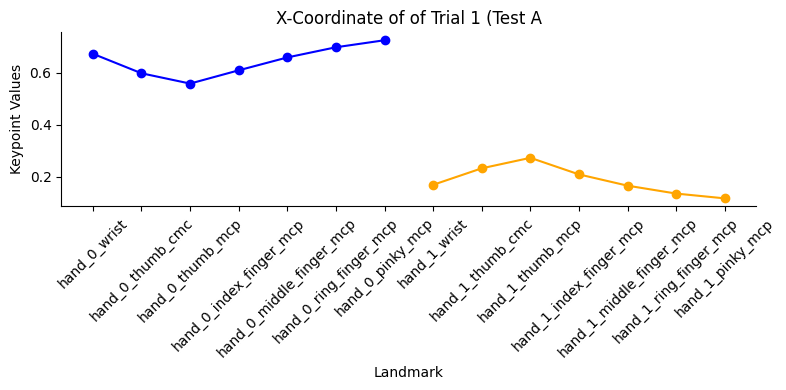

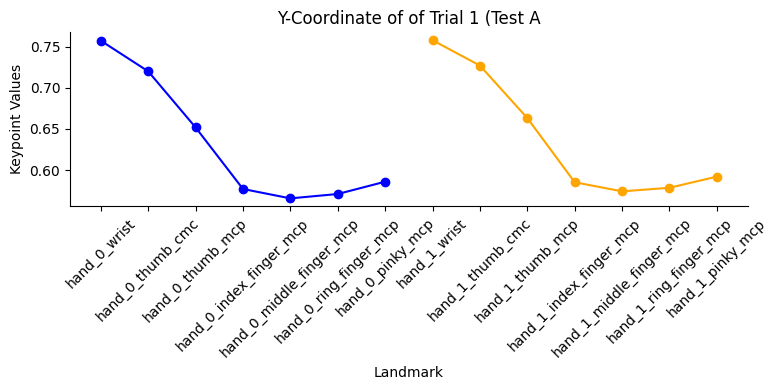

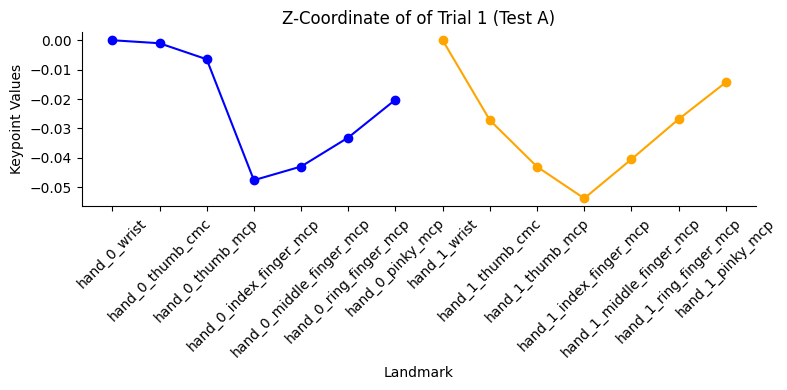

In [ ]:
# @title Test A - Trial 1
# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of of Trial 1 (Test A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of of Trial 1 (Test A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of of Trial 1 (Test A)")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

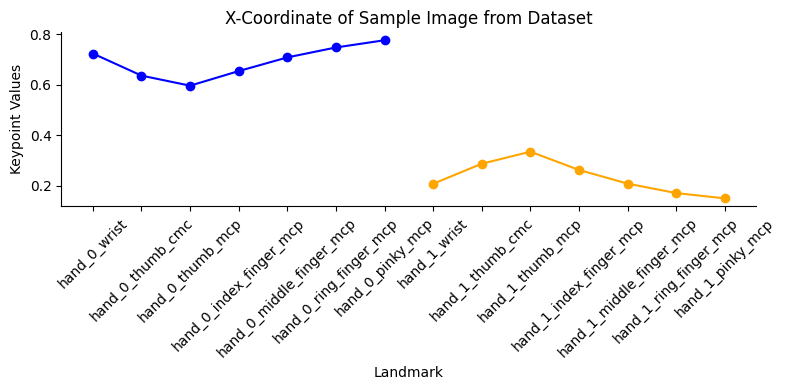

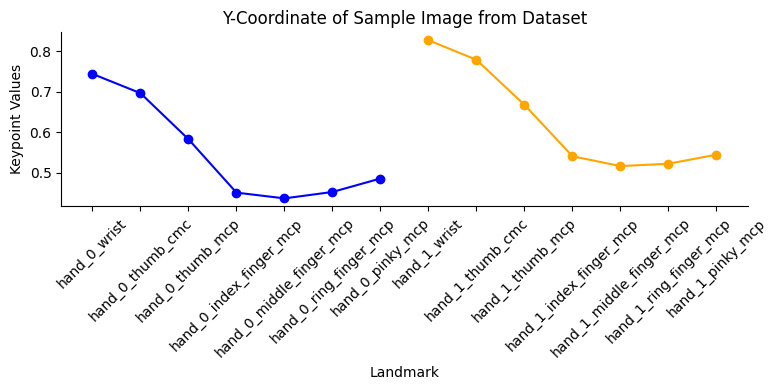

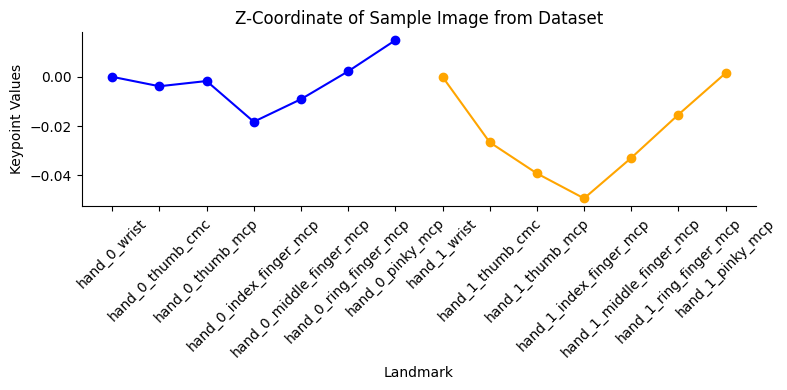

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 2**

In [ ]:
correct_trial2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct2.png'
sample_correct2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 2 (Test A).jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial2)
sample_correct1_landmarks = extract_landmarks(sample_correct2)

Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.679193,0.762995,1.802213e-07,0
1,hand_0_thumb_cmc,0.604270,0.724763,6.563610e-04,0
2,hand_0_thumb_mcp,0.568021,0.652996,-3.273834e-03,0
3,hand_0_index_finger_mcp,0.616926,0.582634,-4.456588e-02,0
4,hand_0_middle_finger_mcp,0.665214,0.572065,-3.953501e-02,0
5,hand_0_ring_finger_mcp,0.702160,0.577031,-3.010884e-02,0
6,hand_0_pinky_mcp,0.727019,0.589581,-1.788889e-02,0
7,hand_1_wrist,0.164827,0.754273,6.186135e-07,1
8,hand_1_thumb_cmc,0.227863,0.727524,-2.501698e-02,1
9,hand_1_thumb_mcp,0.265550,0.662460,-3.931094e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.724401,0.743751,1.570757e-07,0
1,hand_0_thumb_cmc,0.636886,0.696204,-3.834844e-03,0
2,hand_0_thumb_mcp,0.597064,0.582337,-1.713754e-03,0
3,hand_0_index_finger_mcp,0.654863,0.450459,-1.826064e-02,0
4,hand_0_middle_finger_mcp,0.708961,0.436267,-9.097598e-03,0
5,hand_0_ring_finger_mcp,0.748349,0.452099,2.231736e-03,0
6,hand_0_pinky_mcp,0.776966,0.485346,1.485993e-02,0
7,hand_1_wrist,0.208526,0.826967,6.200676e-07,1
8,hand_1_thumb_cmc,0.288024,0.778632,-2.659674e-02,1
9,hand_1_thumb_mcp,0.335631,0.667204,-3.923969e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

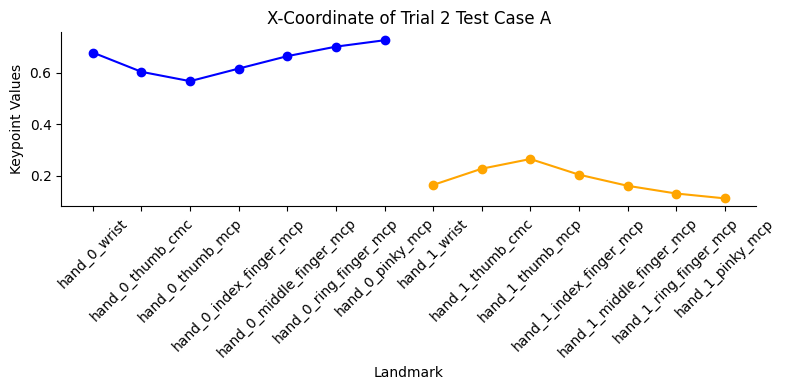

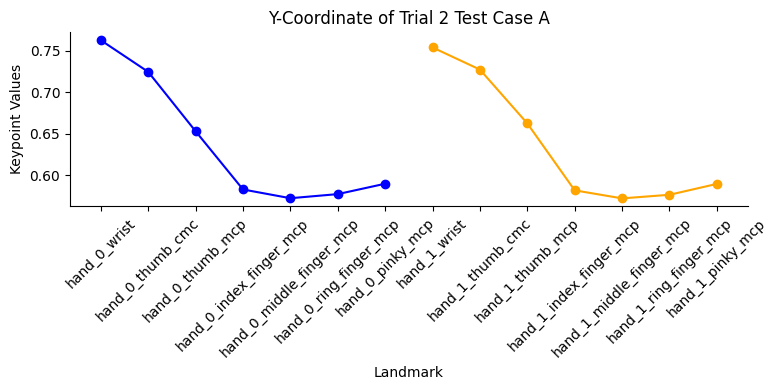

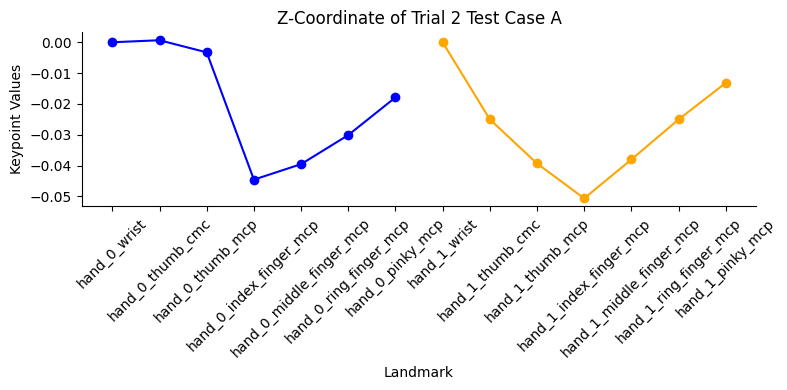

In [ ]:
# @title Trial 2 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 2 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 2 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 2 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

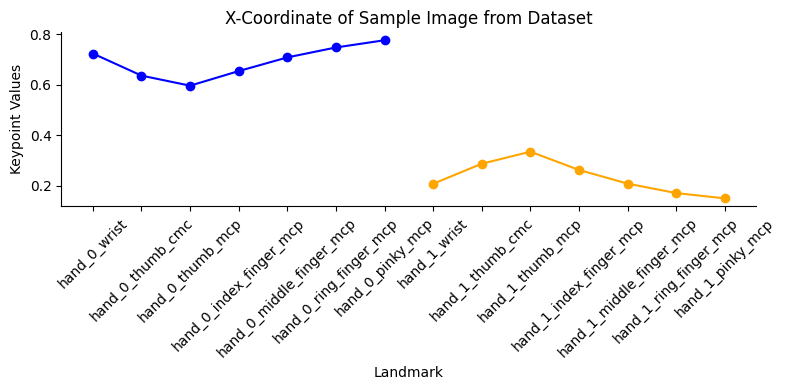

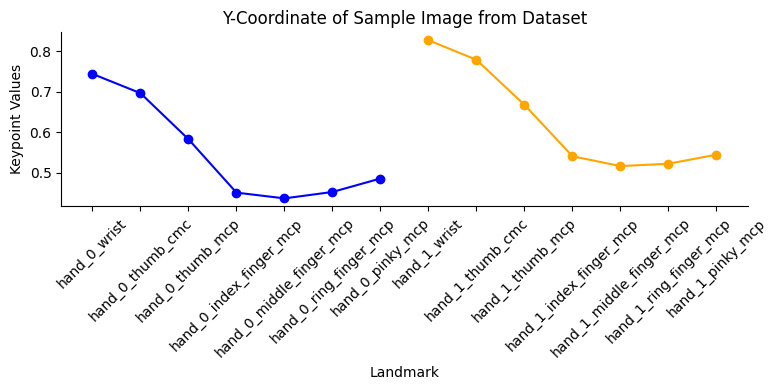

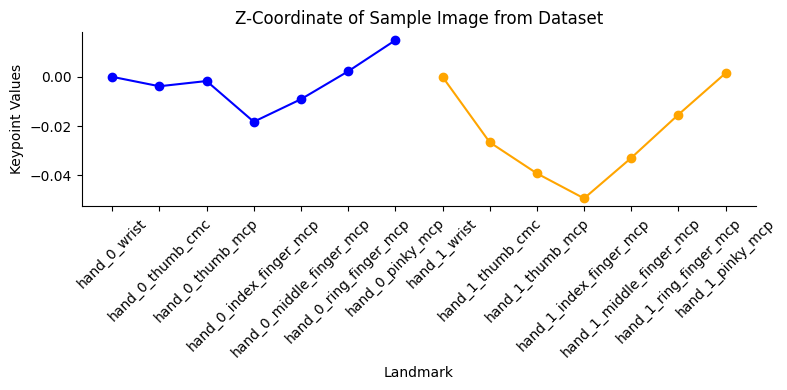

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 3**

In [ ]:
correct_trial3 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct3.png'
sample_correct3 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 3.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial3)
sample_correct1_landmarks = extract_landmarks(sample_correct3)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.676307,0.830432,2.405729e-07,0
1,hand_0_thumb_cmc,0.599848,0.790560,-3.198766e-03,0
2,hand_0_thumb_mcp,0.558986,0.721578,-1.076031e-02,0
3,hand_0_index_finger_mcp,0.610962,0.655013,-6.038551e-02,0
4,hand_0_middle_finger_mcp,0.661170,0.644070,-5.451412e-02,0
5,hand_0_ring_finger_mcp,0.699132,0.646843,-4.283754e-02,0
6,hand_0_pinky_mcp,0.724690,0.660771,-2.842458e-02,0
7,hand_1_wrist,0.185464,0.756480,7.134397e-07,1
8,hand_1_thumb_cmc,0.248676,0.726676,-2.979412e-02,1
9,hand_1_thumb_mcp,0.287980,0.662972,-4.941232e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.701262,0.752263,1.418097e-07,0
1,hand_0_thumb_cmc,0.621669,0.699849,-5.255277e-03,0
2,hand_0_thumb_mcp,0.583096,0.594198,-5.666872e-03,0
3,hand_0_index_finger_mcp,0.643731,0.468967,-2.555789e-02,0
4,hand_0_middle_finger_mcp,0.692340,0.457904,-1.644821e-02,0
5,hand_0_ring_finger_mcp,0.728738,0.472866,-4.666175e-03,0
6,hand_0_pinky_mcp,0.754396,0.503272,8.266559e-03,0
7,hand_1_wrist,0.232317,0.793062,5.334613e-07,1
8,hand_1_thumb_cmc,0.303527,0.733036,-1.955297e-02,1
9,hand_1_thumb_mcp,0.344163,0.627427,-2.973845e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

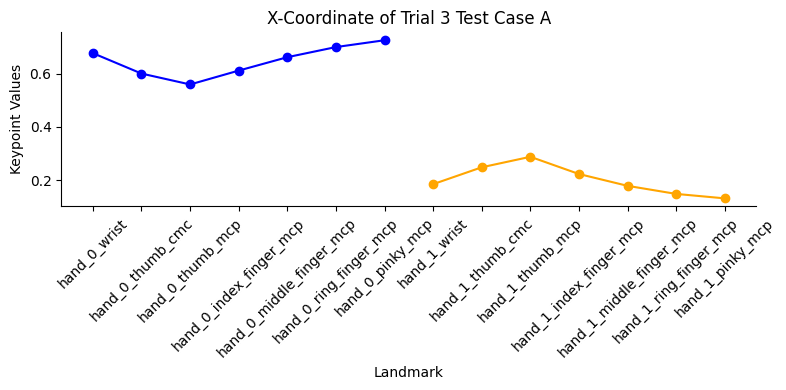

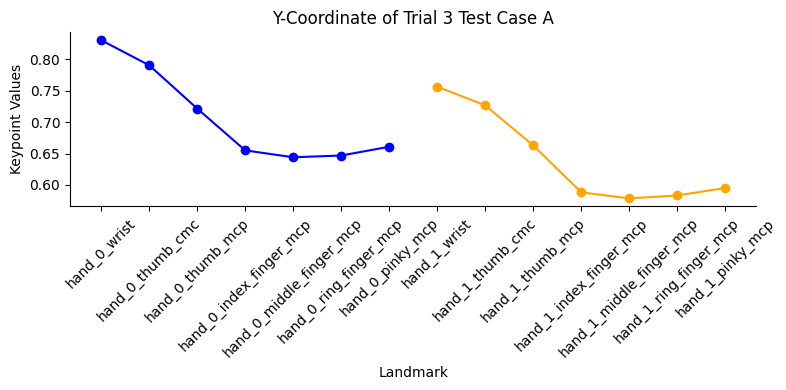

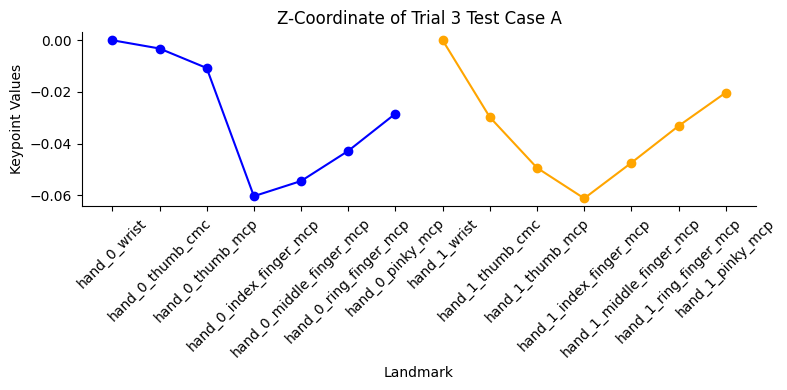

In [ ]:
# @title Trial 3 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 3 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 3 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 3 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

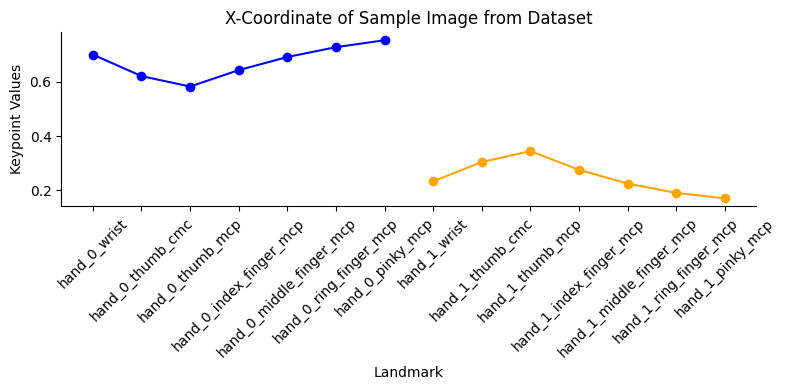

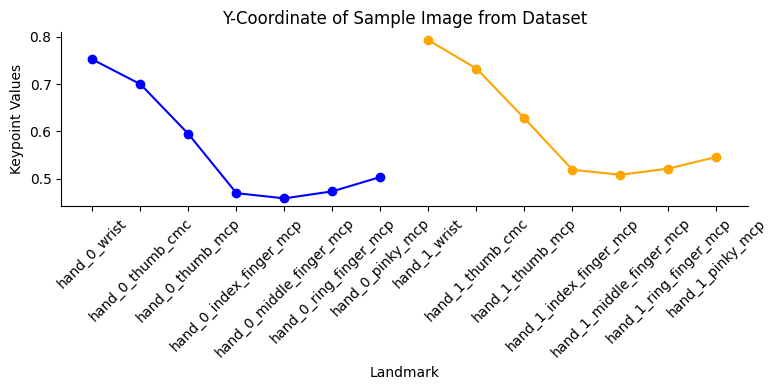

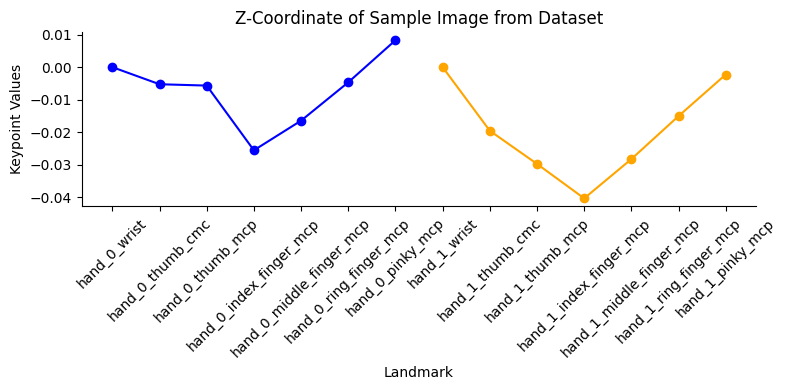

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 4**

In [ ]:
correct_trial4 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct4.png'
sample_correct4 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 5.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial4)
sample_correct1_landmarks = extract_landmarks(sample_correct4)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.663450,0.827478,2.348573e-07,0
1,hand_0_thumb_cmc,0.585810,0.784271,-6.790965e-03,0
2,hand_0_thumb_mcp,0.549336,0.715088,-1.898584e-02,0
3,hand_0_index_finger_mcp,0.598787,0.656731,-8.458706e-02,0
4,hand_0_middle_finger_mcp,0.648506,0.646688,-7.539819e-02,0
5,hand_0_ring_finger_mcp,0.687298,0.650296,-6.036063e-02,0
6,hand_0_pinky_mcp,0.714945,0.661003,-4.205636e-02,0
7,hand_1_wrist,0.195316,0.768596,6.647199e-07,1
8,hand_1_thumb_cmc,0.257025,0.739044,-2.791324e-02,1
9,hand_1_thumb_mcp,0.296713,0.672533,-4.676150e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.235312,0.845539,5.146615e-07,0
1,hand_0_thumb_cmc,0.306796,0.773073,-1.131529e-02,0
2,hand_0_thumb_mcp,0.343971,0.662036,-1.941922e-02,0
3,hand_0_index_finger_mcp,0.279233,0.565678,-3.535179e-02,0
4,hand_0_middle_finger_mcp,0.228156,0.559471,-2.800125e-02,0
5,hand_0_ring_finger_mcp,0.189602,0.576240,-1.900694e-02,0
6,hand_0_pinky_mcp,0.163063,0.605250,-9.812512e-03,0
7,hand_1_wrist,0.774420,0.888486,7.075865e-08,1
8,hand_1_thumb_cmc,0.698886,0.822895,-2.628019e-03,1
9,hand_1_thumb_mcp,0.663044,0.714367,-4.176694e-03,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

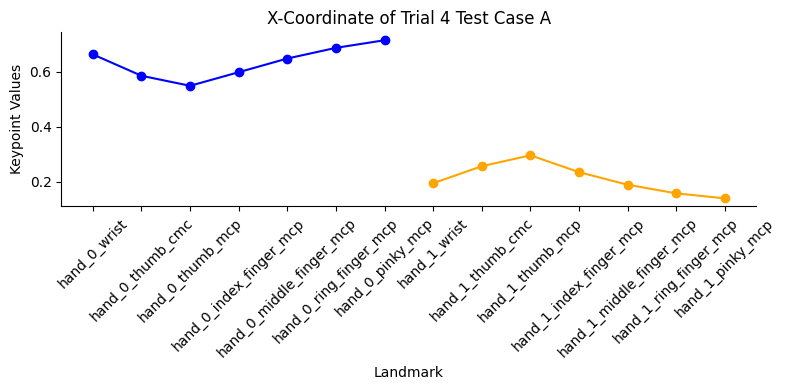

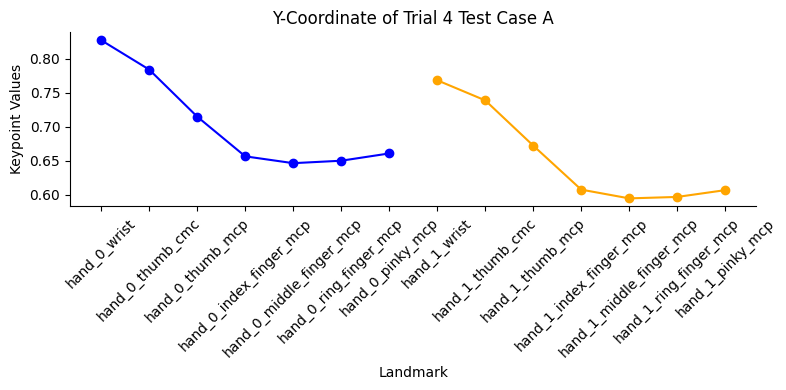

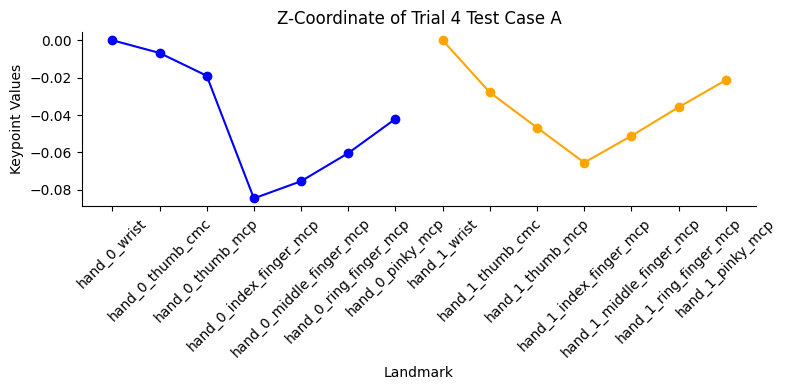

In [ ]:
# @title Trial 3 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 4 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 4 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 4 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

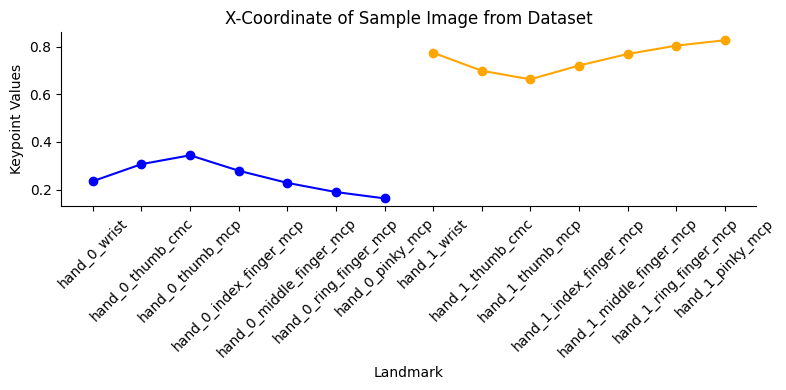

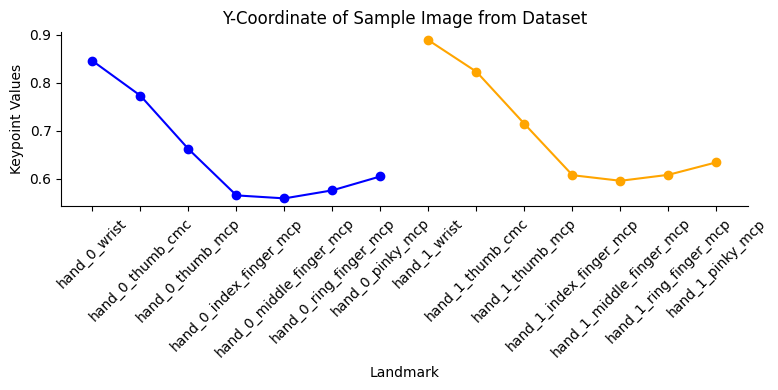

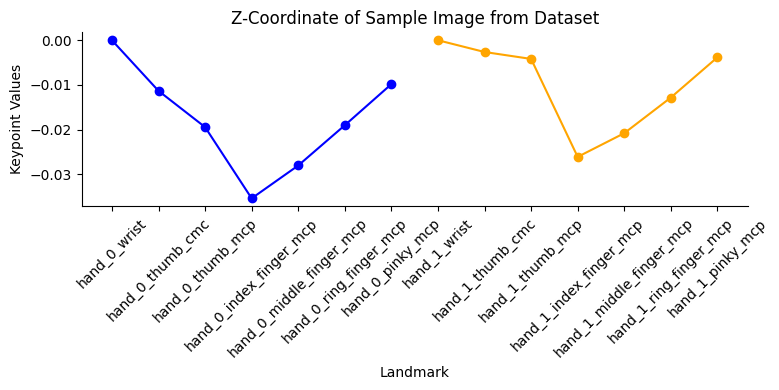

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 5**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct5.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 6.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.687851,0.777730,1.962892e-07,0
1,hand_0_thumb_cmc,0.611102,0.728127,8.743430e-04,0
2,hand_0_thumb_mcp,0.571001,0.658909,-5.036752e-03,0
3,hand_0_index_finger_mcp,0.624818,0.585719,-6.296979e-02,0
4,hand_0_middle_finger_mcp,0.675155,0.576753,-5.503973e-02,0
5,hand_0_ring_finger_mcp,0.714104,0.583468,-4.018521e-02,0
6,hand_0_pinky_mcp,0.740242,0.599676,-2.179281e-02,0
7,hand_1_wrist,0.194396,0.782131,6.709955e-07,1
8,hand_1_thumb_cmc,0.256988,0.745774,-2.651170e-02,1
9,hand_1_thumb_mcp,0.296784,0.678560,-4.361794e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.749708,0.897626,1.003404e-07,0
1,hand_0_thumb_cmc,0.672683,0.836603,-2.077421e-03,0
2,hand_0_thumb_mcp,0.635838,0.720385,-3.382379e-03,0
3,hand_0_index_finger_mcp,0.691505,0.610868,-3.448036e-02,0
4,hand_0_middle_finger_mcp,0.742503,0.599302,-2.850231e-02,0
5,hand_0_ring_finger_mcp,0.779649,0.613354,-1.916910e-02,0
6,hand_0_pinky_mcp,0.804452,0.640882,-8.024517e-03,0
7,hand_1_wrist,0.247460,0.847496,5.966473e-07,1
8,hand_1_thumb_cmc,0.319118,0.783307,-1.605479e-02,1
9,hand_1_thumb_mcp,0.360403,0.673604,-2.674971e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

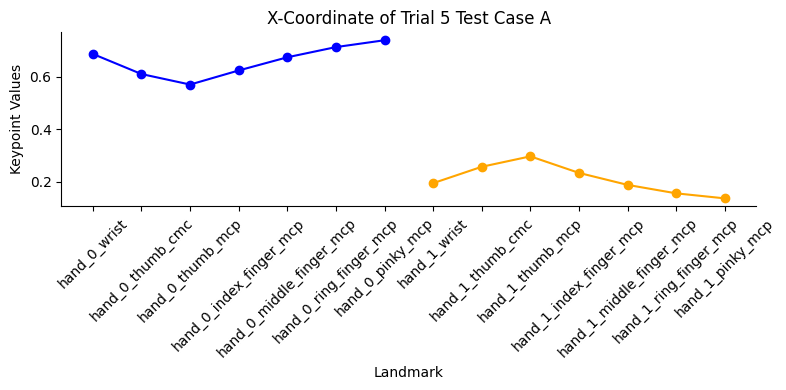

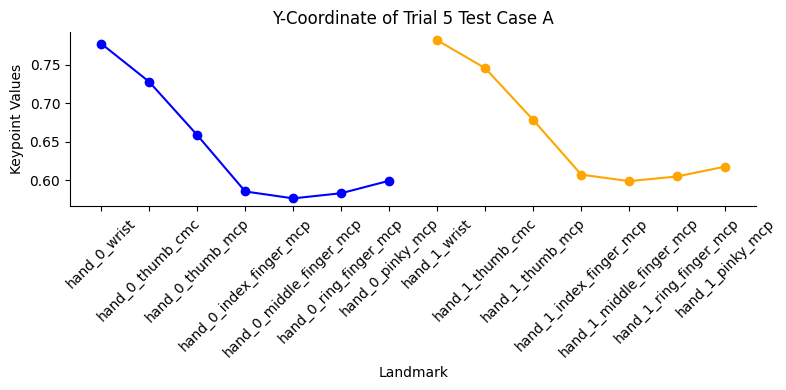

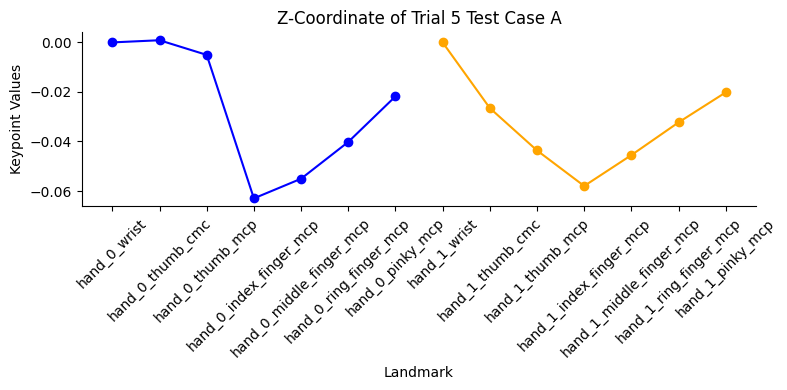

In [ ]:
# @title Trial 5 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 5 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 5 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 5 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

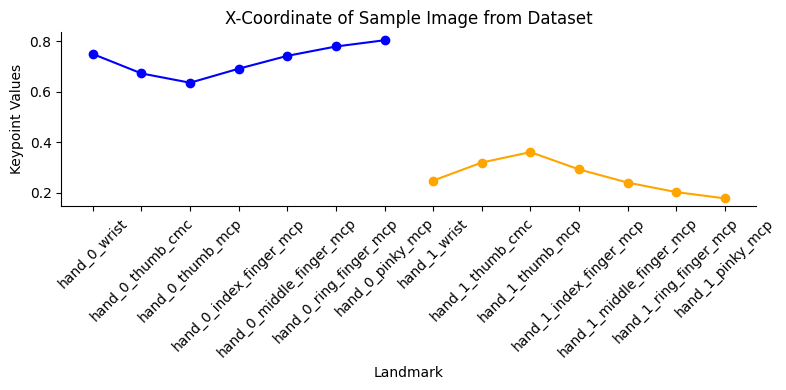

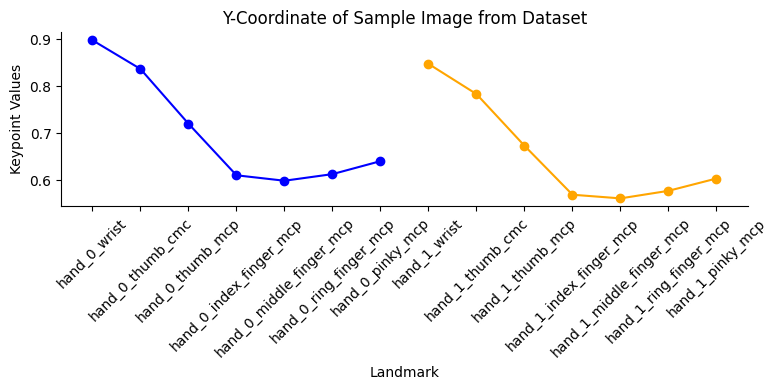

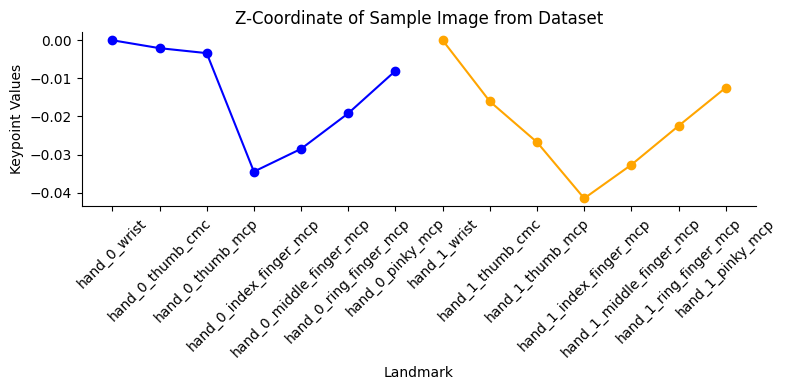

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 6**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct6.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 5.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.688963,0.792598,1.296427e-07,0
1,hand_0_thumb_cmc,0.616416,0.749578,-1.397770e-03,0
2,hand_0_thumb_mcp,0.580035,0.680789,-9.453890e-03,0
3,hand_0_index_finger_mcp,0.633345,0.619797,-6.214619e-02,0
4,hand_0_middle_finger_mcp,0.682705,0.610367,-5.746119e-02,0
5,hand_0_ring_finger_mcp,0.720575,0.614753,-4.744406e-02,0
6,hand_0_pinky_mcp,0.746401,0.630521,-3.439274e-02,0
7,hand_1_wrist,0.173603,0.769913,6.416311e-07,1
8,hand_1_thumb_cmc,0.234495,0.731449,-2.753126e-02,1
9,hand_1_thumb_mcp,0.268911,0.659298,-4.478636e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.235312,0.845539,5.146615e-07,0
1,hand_0_thumb_cmc,0.306796,0.773073,-1.131529e-02,0
2,hand_0_thumb_mcp,0.343971,0.662036,-1.941922e-02,0
3,hand_0_index_finger_mcp,0.279233,0.565678,-3.535179e-02,0
4,hand_0_middle_finger_mcp,0.228156,0.559471,-2.800125e-02,0
5,hand_0_ring_finger_mcp,0.189602,0.576240,-1.900694e-02,0
6,hand_0_pinky_mcp,0.163063,0.605250,-9.812512e-03,0
7,hand_1_wrist,0.774420,0.888486,7.075865e-08,1
8,hand_1_thumb_cmc,0.698886,0.822895,-2.628019e-03,1
9,hand_1_thumb_mcp,0.663044,0.714367,-4.176694e-03,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

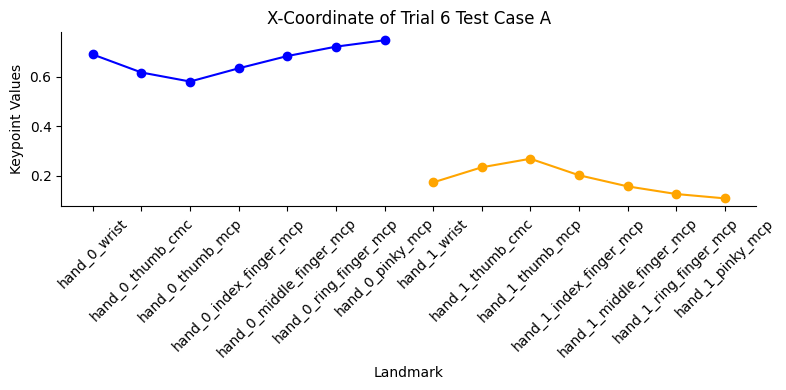

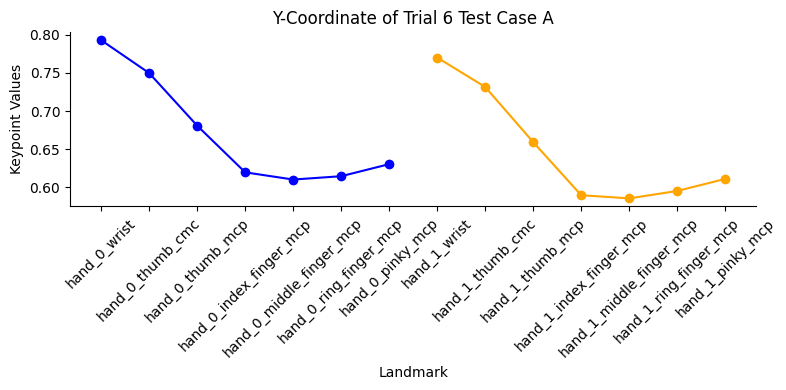

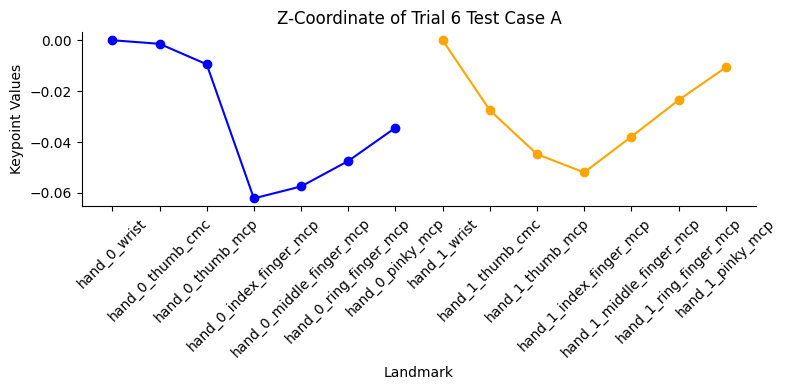

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 6 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 6 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 6 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

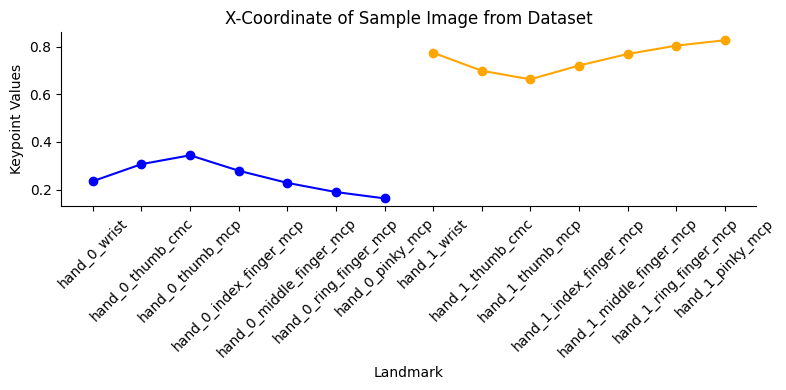

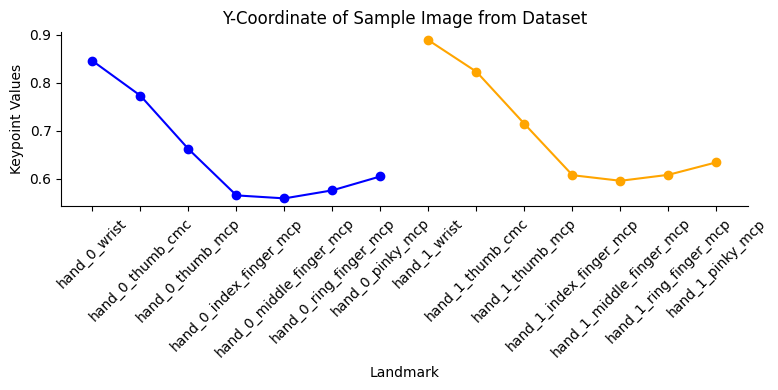

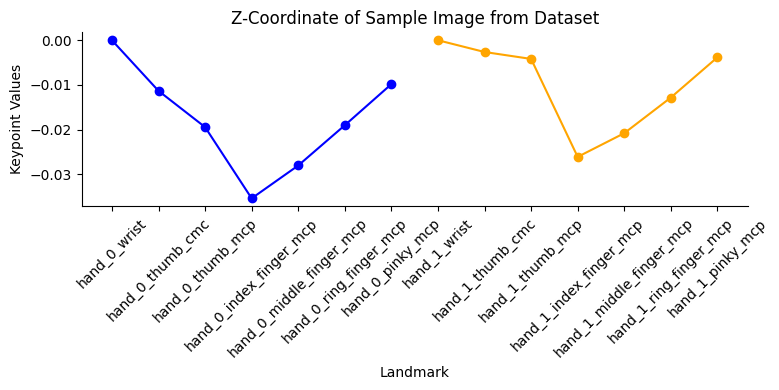

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 7**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct7.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 7.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.690258,0.789521,2.045675e-07,0
1,hand_0_thumb_cmc,0.617333,0.749665,-5.240503e-03,0
2,hand_0_thumb_mcp,0.580082,0.679558,-1.497378e-02,0
3,hand_0_index_finger_mcp,0.631843,0.618353,-6.422886e-02,0
4,hand_0_middle_finger_mcp,0.681324,0.608923,-5.711791e-02,0
5,hand_0_ring_finger_mcp,0.719707,0.614327,-4.583342e-02,0
6,hand_0_pinky_mcp,0.746274,0.628461,-3.203278e-02,0
7,hand_1_wrist,0.185953,0.777488,6.483552e-07,1
8,hand_1_thumb_cmc,0.248083,0.742778,-2.670907e-02,1
9,hand_1_thumb_mcp,0.285563,0.671351,-4.374463e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.728324,0.837226,1.520857e-07,0
1,hand_0_thumb_cmc,0.650585,0.778796,-5.711106e-03,0
2,hand_0_thumb_mcp,0.608683,0.667231,-7.160178e-03,0
3,hand_0_index_finger_mcp,0.663992,0.544318,-2.963723e-02,0
4,hand_0_middle_finger_mcp,0.715160,0.530382,-2.053470e-02,0
5,hand_0_ring_finger_mcp,0.752601,0.543855,-8.388737e-03,0
6,hand_0_pinky_mcp,0.776540,0.573977,5.039980e-03,0
7,hand_1_wrist,0.234502,0.874305,5.844302e-07,1
8,hand_1_thumb_cmc,0.306022,0.808839,-1.726162e-02,1
9,hand_1_thumb_mcp,0.349900,0.700480,-2.695598e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

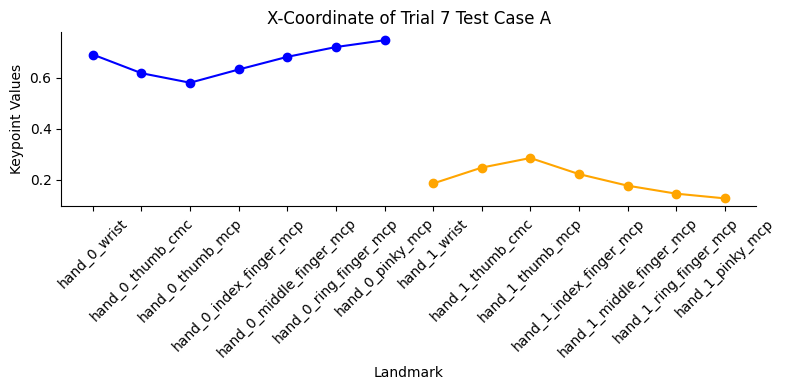

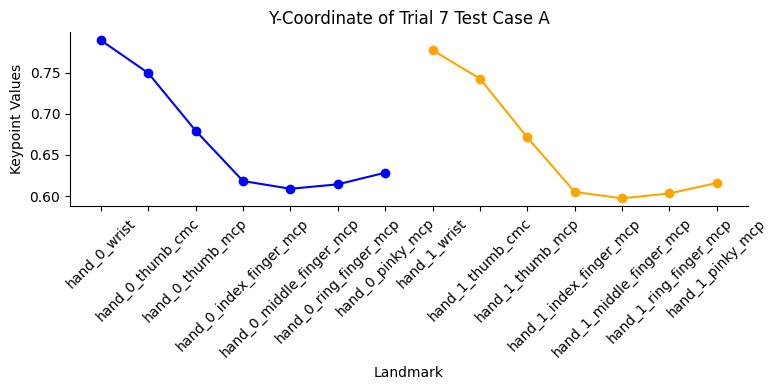

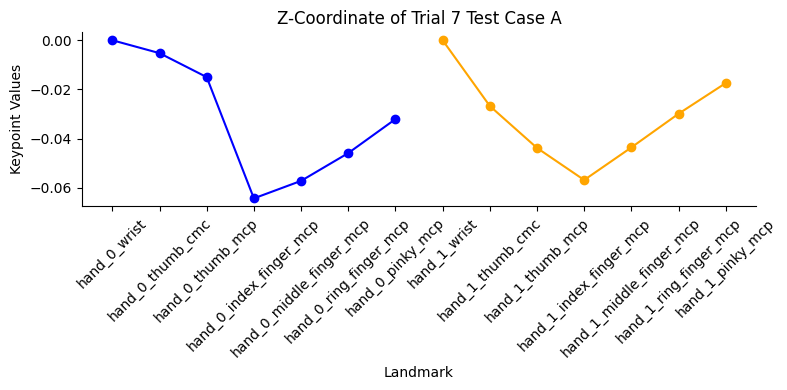

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 7 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 7 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 7 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

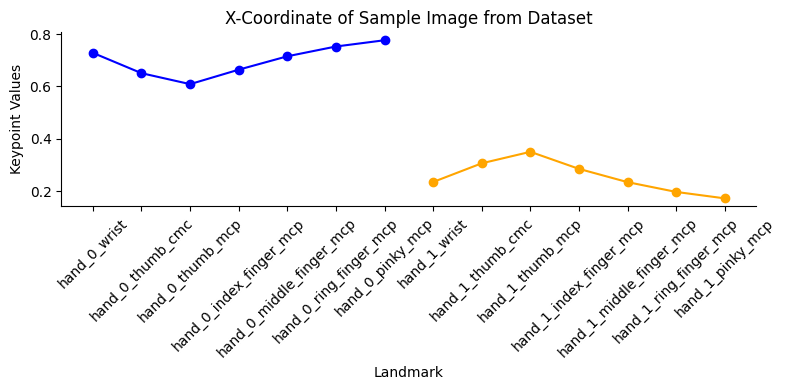

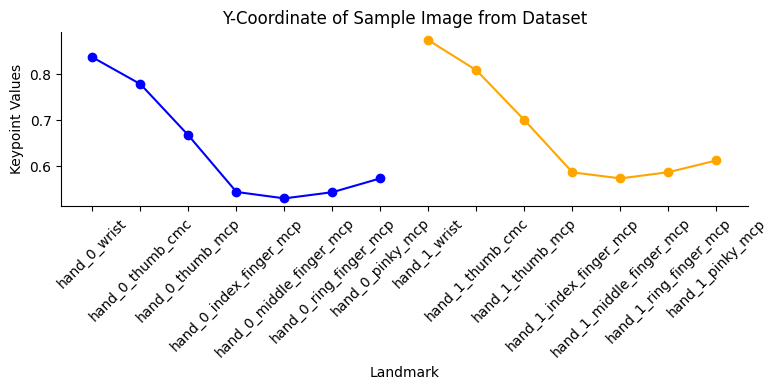

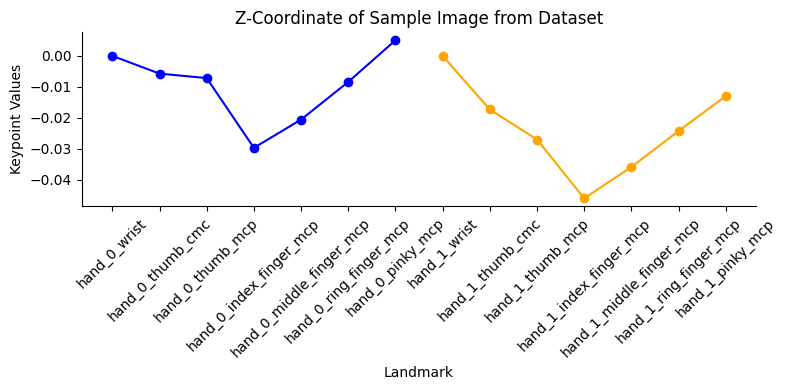

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 8**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct8.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 8.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.690258,0.789521,2.045675e-07,0
1,hand_0_thumb_cmc,0.617333,0.749665,-5.240503e-03,0
2,hand_0_thumb_mcp,0.580082,0.679558,-1.497378e-02,0
3,hand_0_index_finger_mcp,0.631843,0.618353,-6.422886e-02,0
4,hand_0_middle_finger_mcp,0.681324,0.608923,-5.711791e-02,0
5,hand_0_ring_finger_mcp,0.719707,0.614327,-4.583342e-02,0
6,hand_0_pinky_mcp,0.746274,0.628461,-3.203278e-02,0
7,hand_1_wrist,0.185953,0.777488,6.483552e-07,1
8,hand_1_thumb_cmc,0.248083,0.742778,-2.670907e-02,1
9,hand_1_thumb_mcp,0.285563,0.671351,-4.374463e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.742210,0.880494,8.503455e-08,0
1,hand_0_thumb_cmc,0.666277,0.814469,-1.926351e-03,0
2,hand_0_thumb_mcp,0.632142,0.700048,-2.450140e-03,0
3,hand_0_index_finger_mcp,0.691196,0.596063,-3.448167e-02,0
4,hand_0_middle_finger_mcp,0.740560,0.587840,-2.753223e-02,0
5,hand_0_ring_finger_mcp,0.776868,0.604944,-1.702808e-02,0
6,hand_0_pinky_mcp,0.801474,0.636825,-4.776181e-03,0
7,hand_1_wrist,0.234084,0.862749,6.716230e-07,1
8,hand_1_thumb_cmc,0.303716,0.804058,-2.127354e-02,1
9,hand_1_thumb_mcp,0.345400,0.696624,-3.502290e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

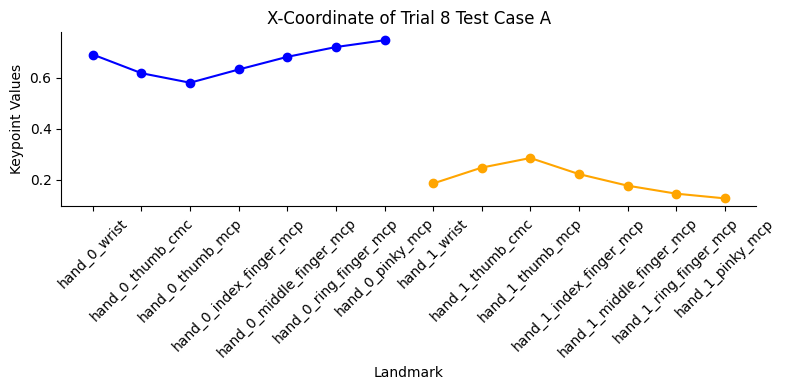

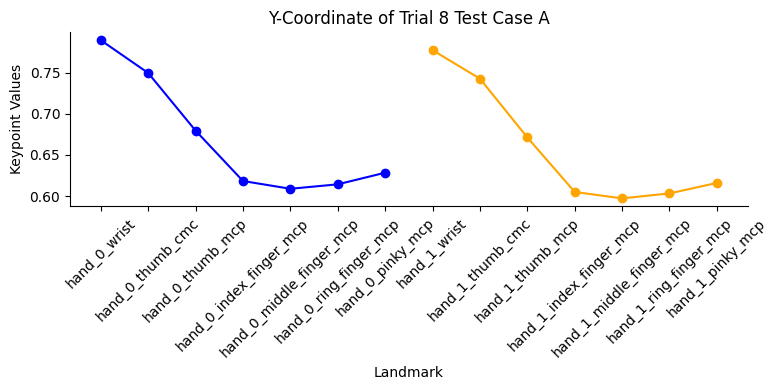

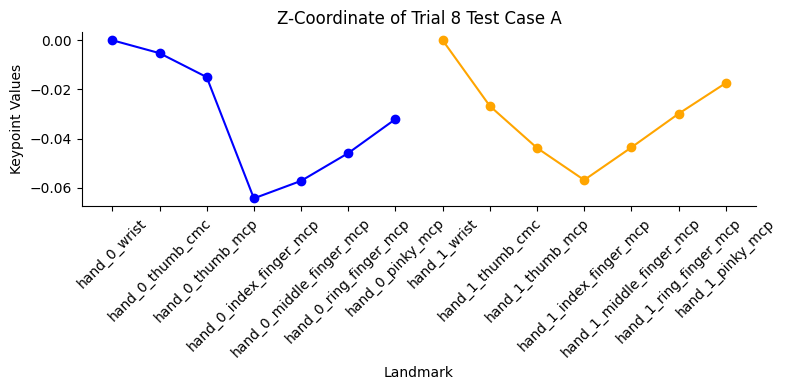

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 8 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 8 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 8 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

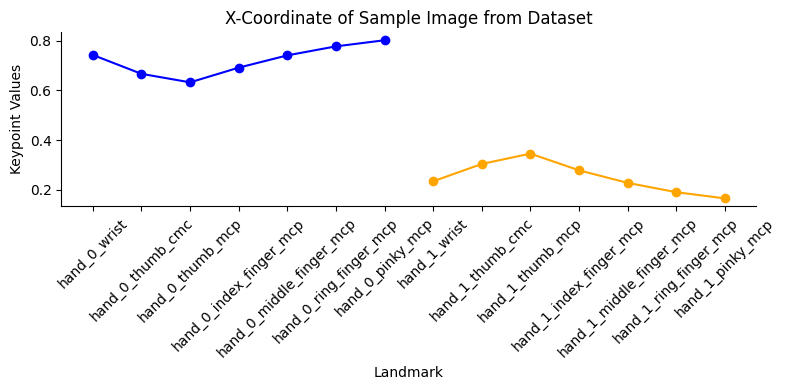

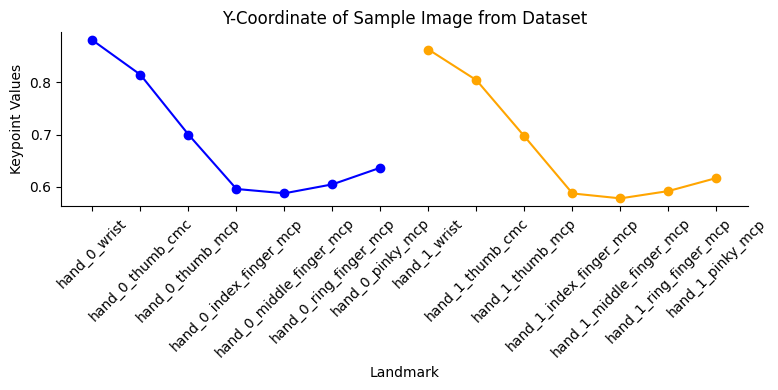

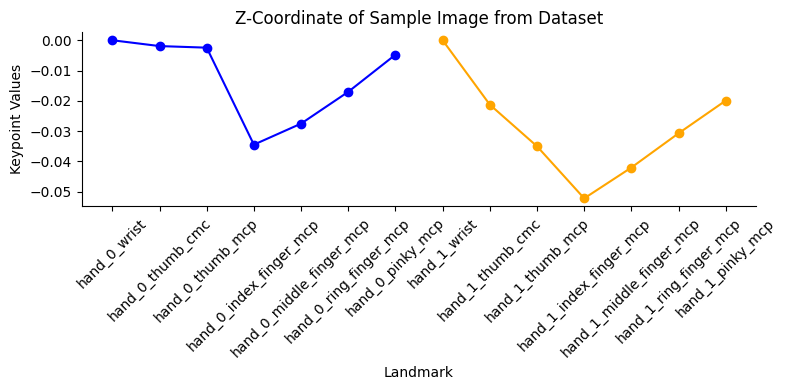

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 9**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct9.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 9.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.212279,0.765421,6.995219e-07,0
1,hand_0_thumb_cmc,0.276304,0.731057,-2.895605e-02,0
2,hand_0_thumb_mcp,0.315228,0.663662,-4.688203e-02,0
3,hand_0_index_finger_mcp,0.252826,0.595534,-6.726380e-02,0
4,hand_0_middle_finger_mcp,0.206799,0.587706,-5.132018e-02,0
5,hand_0_ring_finger_mcp,0.174806,0.592617,-3.389836e-02,0
6,hand_0_pinky_mcp,0.155966,0.603472,-1.735074e-02,0
7,hand_1_wrist,0.644220,0.770303,2.456067e-07,1
8,hand_1_thumb_cmc,0.566147,0.734126,-6.887952e-04,1
9,hand_1_thumb_mcp,0.526462,0.669708,-9.343561e-03,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.706508,0.840543,9.854904e-08,0
1,hand_0_thumb_cmc,0.631203,0.768095,-3.569405e-03,0
2,hand_0_thumb_mcp,0.594479,0.650182,-4.984669e-03,0
3,hand_0_index_finger_mcp,0.653647,0.550760,-2.759609e-02,0
4,hand_0_middle_finger_mcp,0.704153,0.543561,-2.052286e-02,0
5,hand_0_ring_finger_mcp,0.741459,0.558450,-1.052521e-02,0
6,hand_0_pinky_mcp,0.764775,0.588620,1.594389e-04,0
7,hand_1_wrist,0.208828,0.881664,6.309827e-07,1
8,hand_1_thumb_cmc,0.278335,0.819831,-1.985182e-02,1
9,hand_1_thumb_mcp,0.320161,0.714984,-3.351140e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

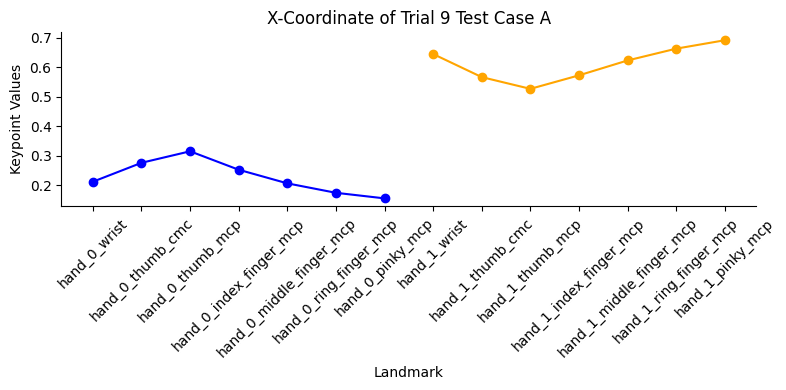

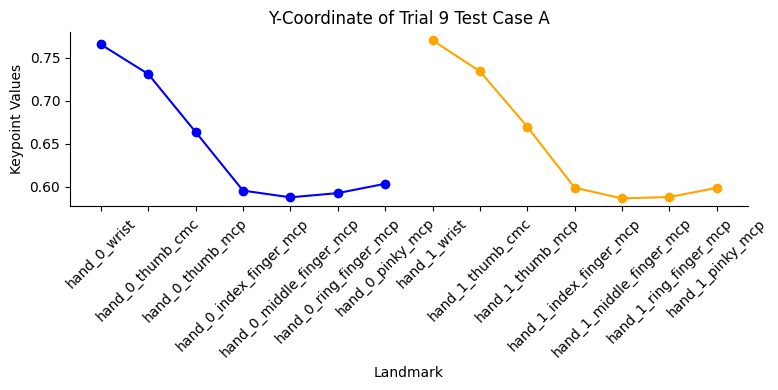

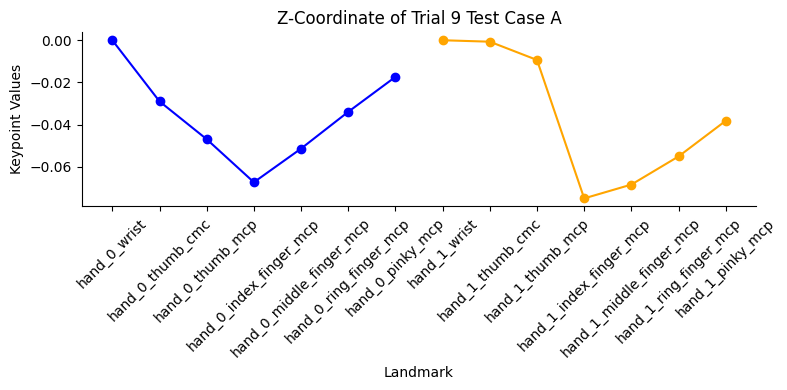

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

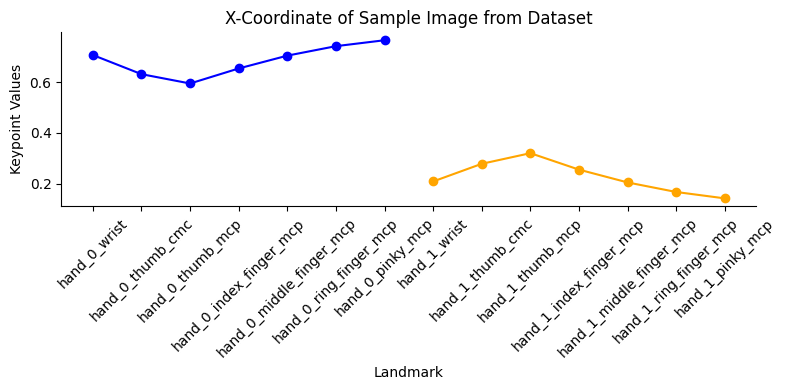

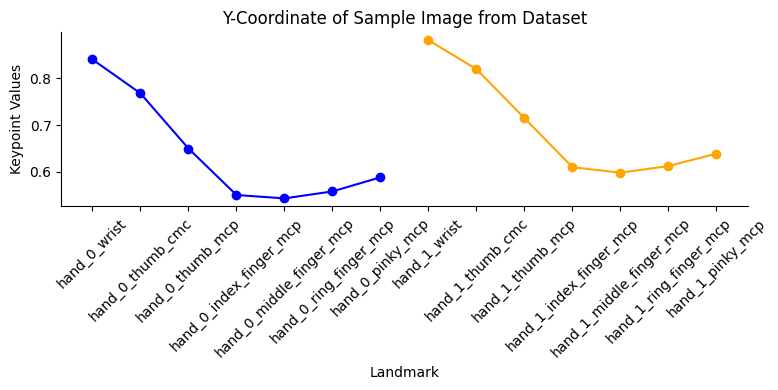

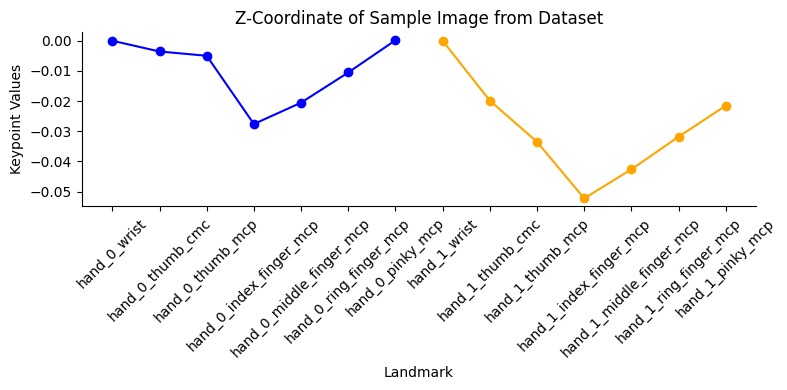

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 10**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct10.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 10.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.653600,0.788061,2.404415e-07,0
1,hand_0_thumb_cmc,0.572516,0.747551,-4.426992e-03,0
2,hand_0_thumb_mcp,0.532151,0.682257,-1.413377e-02,0
3,hand_0_index_finger_mcp,0.581987,0.607837,-8.198611e-02,0
4,hand_0_middle_finger_mcp,0.632308,0.595891,-7.531132e-02,0
5,hand_0_ring_finger_mcp,0.672769,0.598521,-6.157802e-02,0
6,hand_0_pinky_mcp,0.701408,0.611064,-4.521577e-02,0
7,hand_1_wrist,0.195049,0.736630,7.190640e-07,1
8,hand_1_thumb_cmc,0.256886,0.705398,-3.060846e-02,1
9,hand_1_thumb_mcp,0.291475,0.637644,-4.805292e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.726202,0.821985,4.903462e-08,0
1,hand_0_thumb_cmc,0.650630,0.752835,-6.598573e-03,0
2,hand_0_thumb_mcp,0.610902,0.641962,-1.124844e-02,0
3,hand_0_index_finger_mcp,0.673570,0.542297,-3.622868e-02,0
4,hand_0_middle_finger_mcp,0.723320,0.529067,-2.720245e-02,0
5,hand_0_ring_finger_mcp,0.759246,0.539468,-1.500266e-02,0
6,hand_0_pinky_mcp,0.780746,0.566917,-2.330130e-03,0
7,hand_1_wrist,0.214198,0.860947,6.226614e-07,1
8,hand_1_thumb_cmc,0.283747,0.800561,-2.167922e-02,1
9,hand_1_thumb_mcp,0.325785,0.691157,-3.549831e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

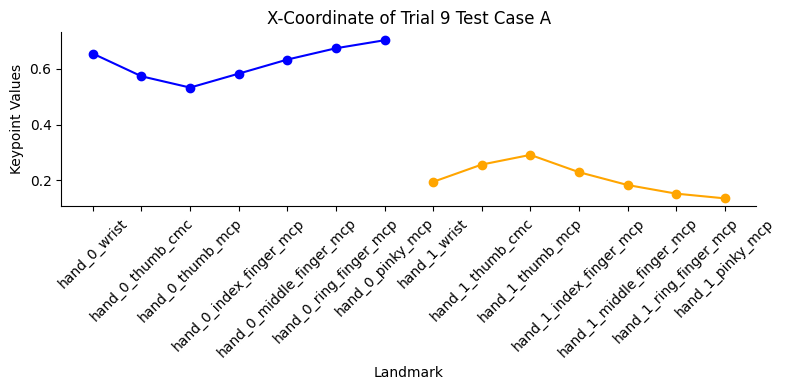

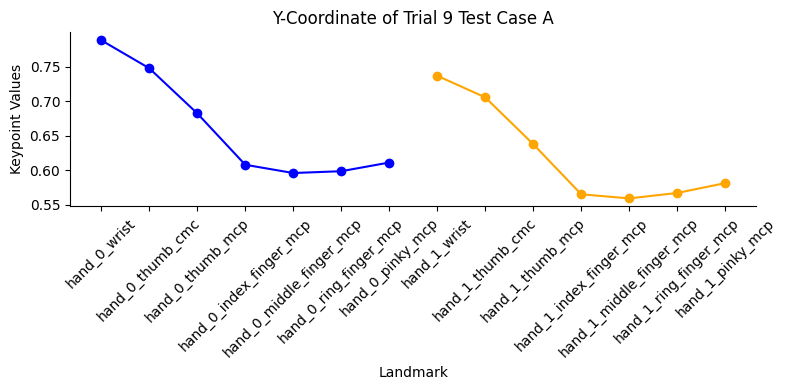

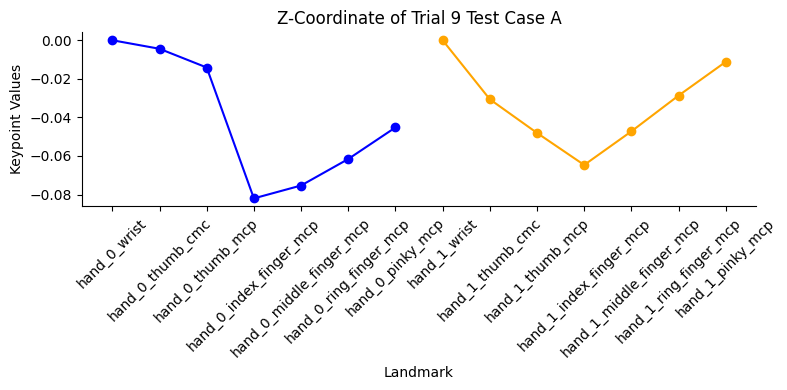

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

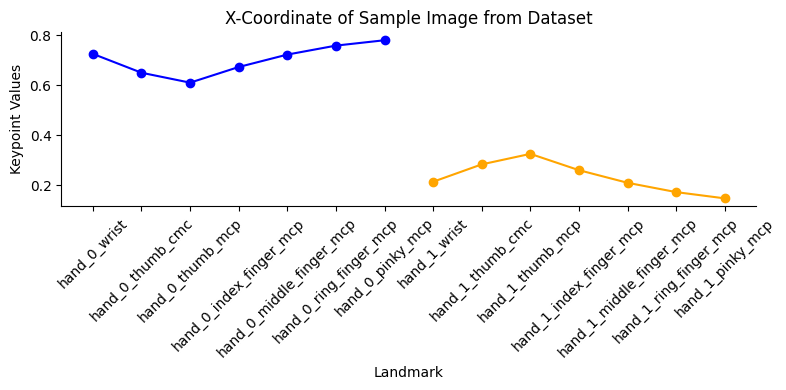

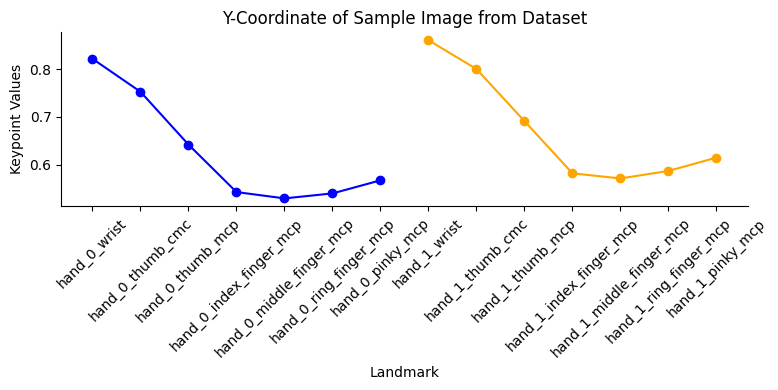

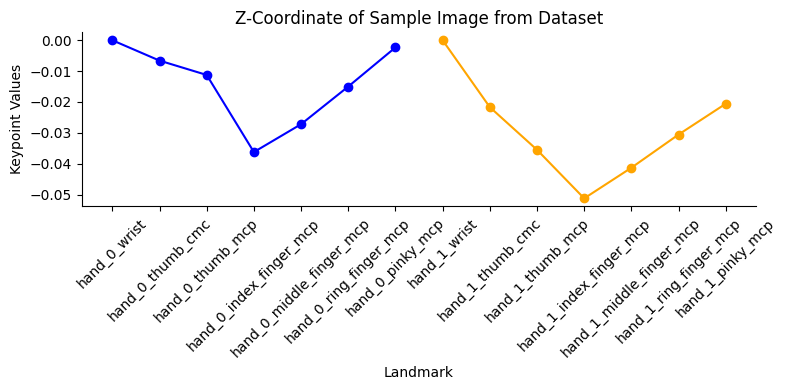

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 11**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct11.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 11.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.636871,0.777321,2.462319e-07,0
1,hand_0_thumb_cmc,0.560214,0.757481,-3.690610e-03,0
2,hand_0_thumb_mcp,0.516342,0.693281,-1.114659e-02,0
3,hand_0_index_finger_mcp,0.560519,0.620438,-4.834196e-02,0
4,hand_0_middle_finger_mcp,0.609604,0.603965,-4.575467e-02,0
5,hand_0_ring_finger_mcp,0.650111,0.601090,-3.972004e-02,0
6,hand_0_pinky_mcp,0.680241,0.608986,-3.170333e-02,0
7,hand_1_wrist,0.200344,0.752206,5.878323e-07,1
8,hand_1_thumb_cmc,0.263144,0.726149,-2.599993e-02,1
9,hand_1_thumb_mcp,0.300092,0.657738,-4.099983e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.221308,0.882812,5.692057e-07,0
1,hand_0_thumb_cmc,0.291557,0.817471,-1.840657e-02,0
2,hand_0_thumb_mcp,0.334271,0.706250,-2.937298e-02,0
3,hand_0_index_finger_mcp,0.267864,0.594707,-4.512737e-02,0
4,hand_0_middle_finger_mcp,0.217470,0.583995,-3.619143e-02,0
5,hand_0_ring_finger_mcp,0.180505,0.600577,-2.636403e-02,0
6,hand_0_pinky_mcp,0.157079,0.628752,-1.715041e-02,0
7,hand_1_wrist,0.645717,0.832083,7.822336e-08,1
8,hand_1_thumb_cmc,0.567123,0.777722,-6.665457e-03,1
9,hand_1_thumb_mcp,0.520949,0.673555,-1.300170e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

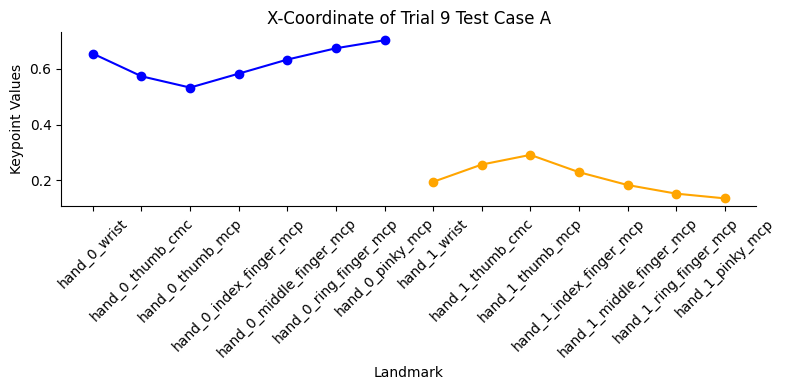

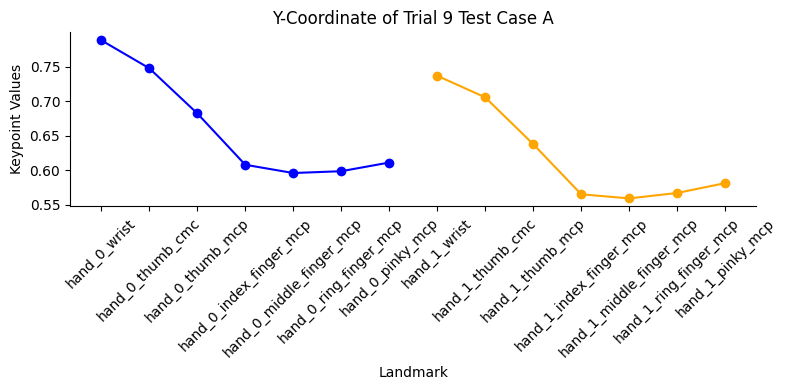

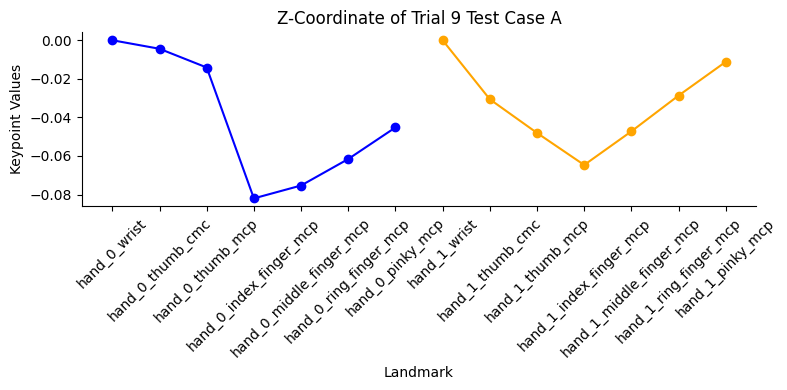

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 9 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

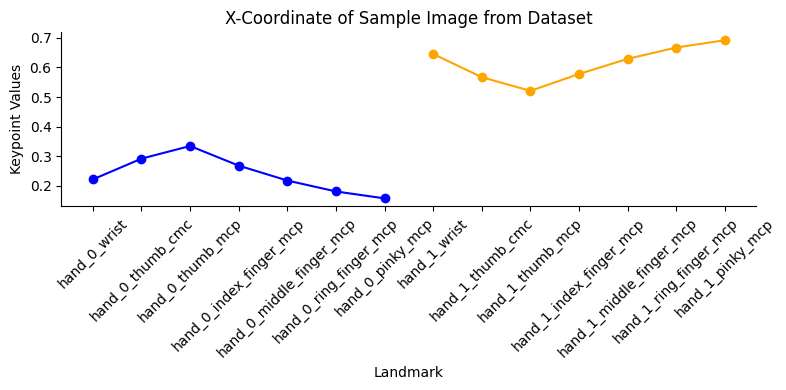

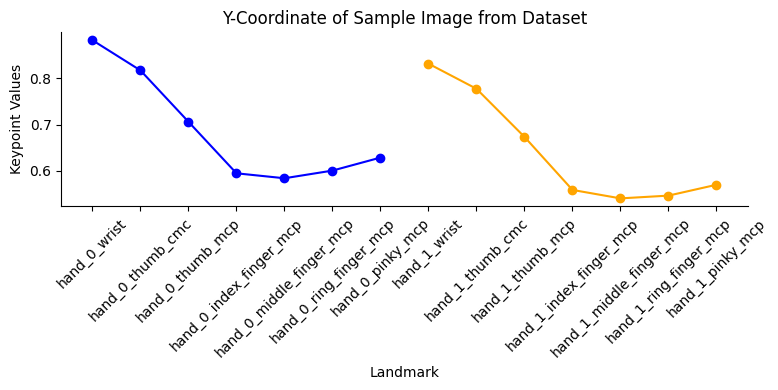

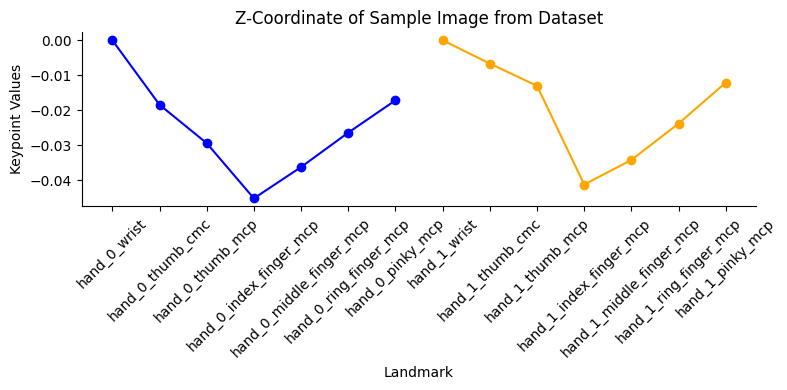

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 12**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct12.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 14.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.633302,0.780167,2.922758e-07,0
1,hand_0_thumb_cmc,0.555721,0.756989,-4.906953e-03,0
2,hand_0_thumb_mcp,0.512383,0.690235,-1.248216e-02,0
3,hand_0_index_finger_mcp,0.559606,0.619501,-5.175928e-02,0
4,hand_0_middle_finger_mcp,0.608655,0.605331,-4.735101e-02,0
5,hand_0_ring_finger_mcp,0.648185,0.603950,-3.920074e-02,0
6,hand_0_pinky_mcp,0.677338,0.612463,-2.922057e-02,0
7,hand_1_wrist,0.206134,0.758829,6.217689e-07,1
8,hand_1_thumb_cmc,0.269229,0.724421,-2.656033e-02,1
9,hand_1_thumb_mcp,0.303183,0.654737,-4.267397e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.657270,0.876975,2.087218e-07,0
1,hand_0_thumb_cmc,0.578161,0.828224,-8.214998e-03,0
2,hand_0_thumb_mcp,0.530297,0.731966,-1.451133e-02,0
3,hand_0_index_finger_mcp,0.588828,0.606389,-3.676527e-02,0
4,hand_0_middle_finger_mcp,0.639776,0.591215,-2.872718e-02,0
5,hand_0_ring_finger_mcp,0.677130,0.599915,-1.806493e-02,0
6,hand_0_pinky_mcp,0.701419,0.623527,-5.508841e-03,0
7,hand_1_wrist,0.232495,0.809390,4.170115e-07,1
8,hand_1_thumb_cmc,0.305615,0.742448,-8.216304e-03,1
9,hand_1_thumb_mcp,0.349073,0.635004,-1.497043e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

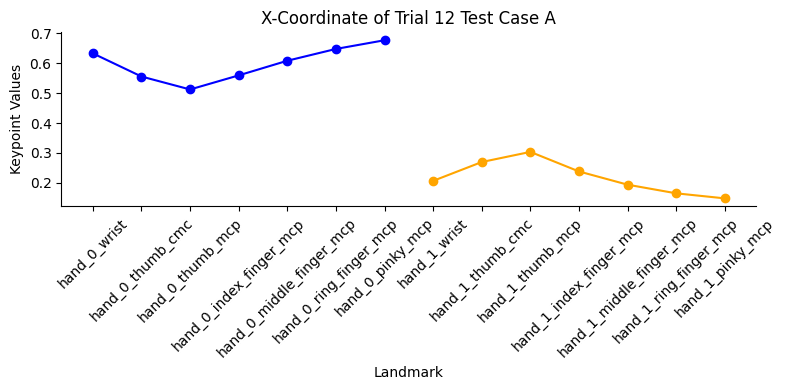

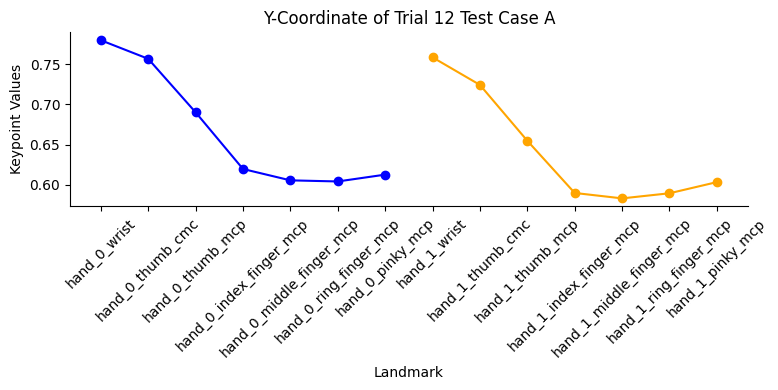

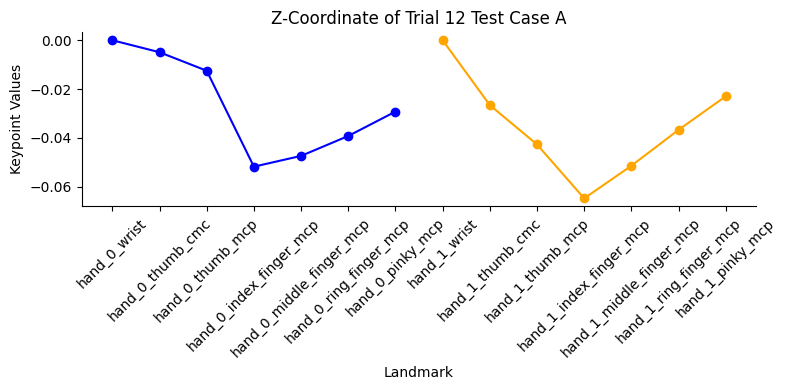

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 12 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 12 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 12 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

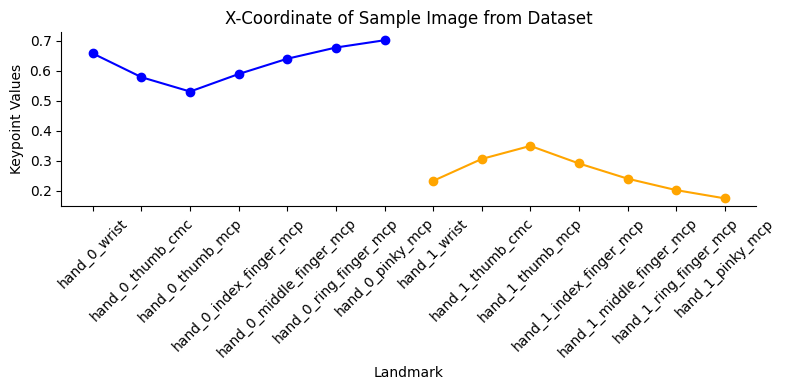

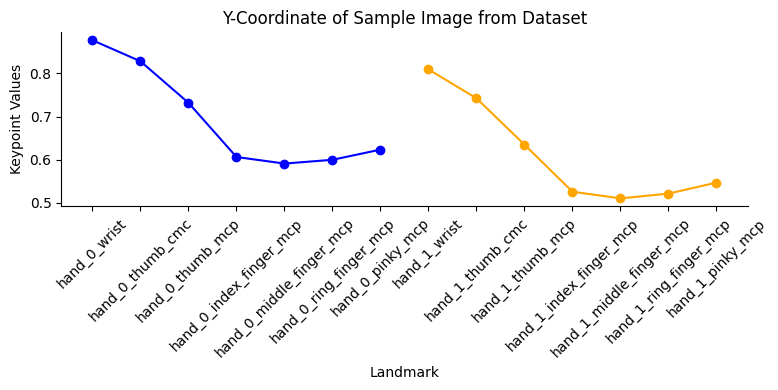

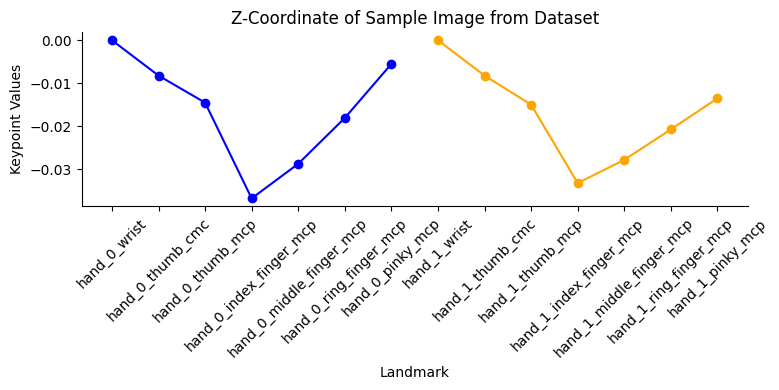

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 13**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct13.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 13.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.626430,0.818803,2.580905e-07,0
1,hand_0_thumb_cmc,0.550565,0.799681,-3.935838e-04,0
2,hand_0_thumb_mcp,0.508775,0.731415,-6.215532e-03,0
3,hand_0_index_finger_mcp,0.546487,0.668023,-5.141786e-02,0
4,hand_0_middle_finger_mcp,0.596997,0.651263,-5.018959e-02,0
5,hand_0_ring_finger_mcp,0.638575,0.646067,-4.439965e-02,0
6,hand_0_pinky_mcp,0.669282,0.652975,-3.597630e-02,0
7,hand_1_wrist,0.210357,0.749672,6.887796e-07,1
8,hand_1_thumb_cmc,0.273392,0.718873,-2.707180e-02,1
9,hand_1_thumb_mcp,0.308937,0.651075,-4.329410e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.659718,0.881584,1.262812e-07,0
1,hand_0_thumb_cmc,0.581226,0.834661,-6.243727e-03,0
2,hand_0_thumb_mcp,0.534049,0.735208,-9.353119e-03,0
3,hand_0_index_finger_mcp,0.588776,0.618435,-3.149552e-02,0
4,hand_0_middle_finger_mcp,0.639709,0.595754,-2.422931e-02,0
5,hand_0_ring_finger_mcp,0.676328,0.598829,-1.424584e-02,0
6,hand_0_pinky_mcp,0.699149,0.618730,-2.425958e-03,0
7,hand_1_wrist,0.216118,0.802512,4.322088e-07,1
8,hand_1_thumb_cmc,0.286242,0.734025,-1.199755e-02,1
9,hand_1_thumb_mcp,0.327526,0.627980,-1.990554e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

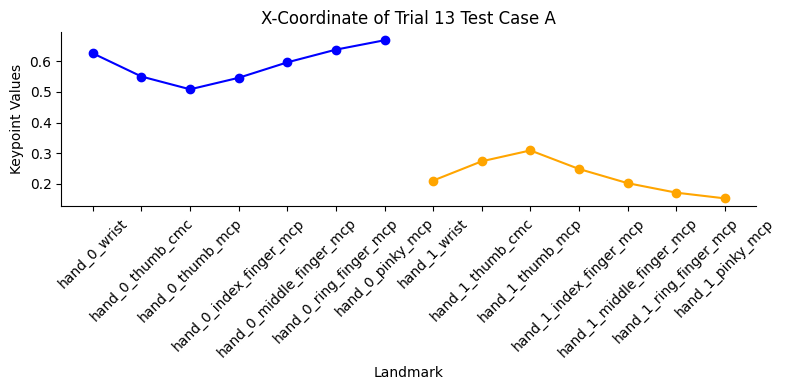

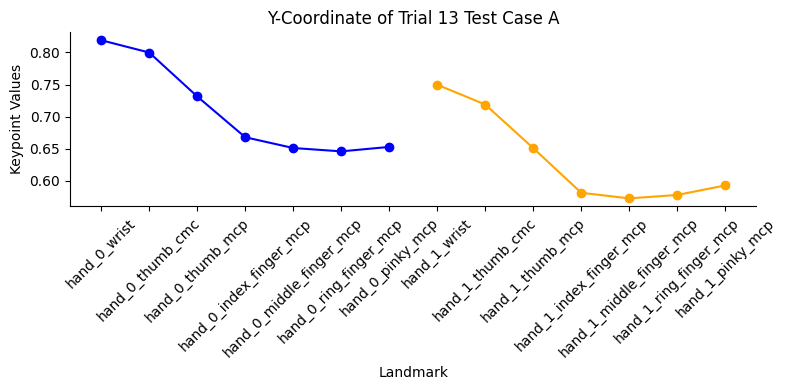

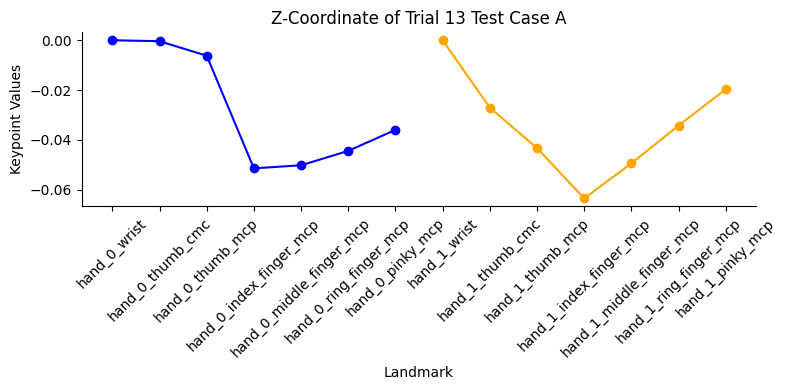

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 13 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 13 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 13 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

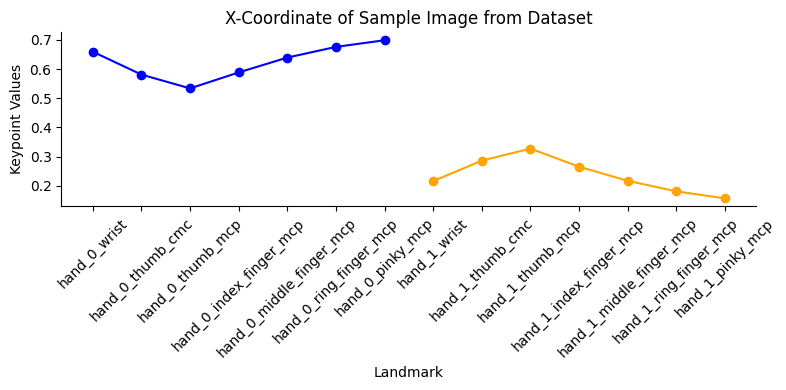

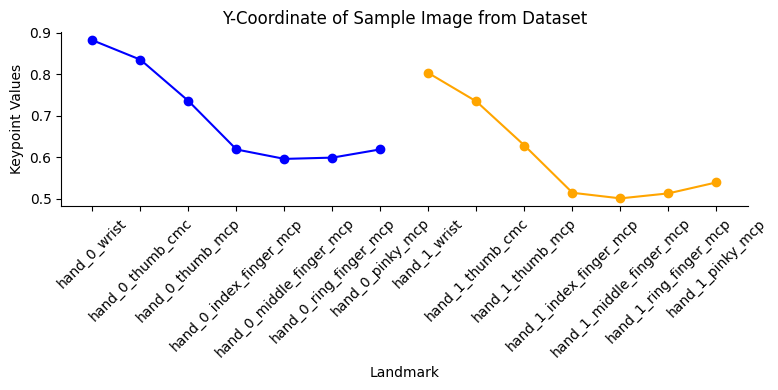

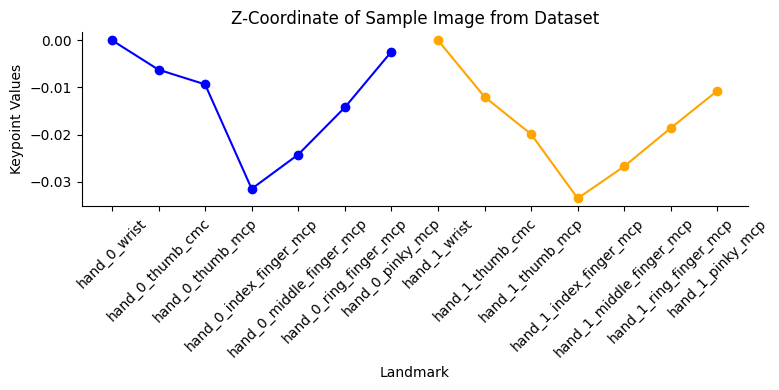

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 14**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct14.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 14.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.690258,0.789521,2.045675e-07,0
1,hand_0_thumb_cmc,0.617333,0.749665,-5.240503e-03,0
2,hand_0_thumb_mcp,0.580082,0.679558,-1.497378e-02,0
3,hand_0_index_finger_mcp,0.631843,0.618353,-6.422886e-02,0
4,hand_0_middle_finger_mcp,0.681324,0.608923,-5.711791e-02,0
5,hand_0_ring_finger_mcp,0.719707,0.614327,-4.583342e-02,0
6,hand_0_pinky_mcp,0.746274,0.628461,-3.203278e-02,0
7,hand_1_wrist,0.185953,0.777488,6.483552e-07,1
8,hand_1_thumb_cmc,0.248083,0.742778,-2.670907e-02,1
9,hand_1_thumb_mcp,0.285563,0.671351,-4.374463e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.657270,0.876975,2.087218e-07,0
1,hand_0_thumb_cmc,0.578161,0.828224,-8.214998e-03,0
2,hand_0_thumb_mcp,0.530297,0.731966,-1.451133e-02,0
3,hand_0_index_finger_mcp,0.588828,0.606389,-3.676527e-02,0
4,hand_0_middle_finger_mcp,0.639776,0.591215,-2.872718e-02,0
5,hand_0_ring_finger_mcp,0.677130,0.599915,-1.806493e-02,0
6,hand_0_pinky_mcp,0.701419,0.623527,-5.508841e-03,0
7,hand_1_wrist,0.232495,0.809390,4.170115e-07,1
8,hand_1_thumb_cmc,0.305615,0.742448,-8.216304e-03,1
9,hand_1_thumb_mcp,0.349073,0.635004,-1.497043e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

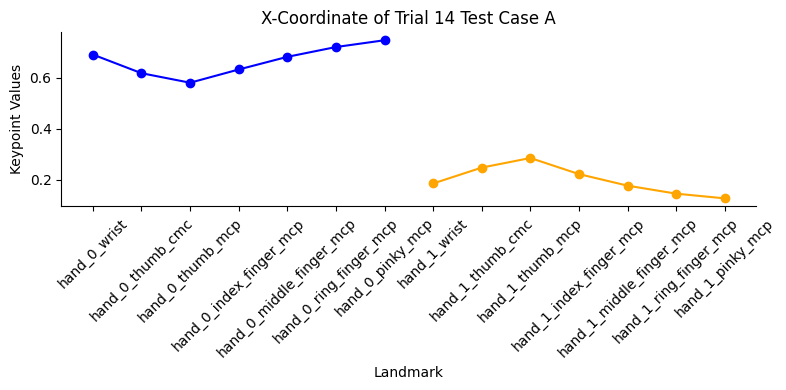

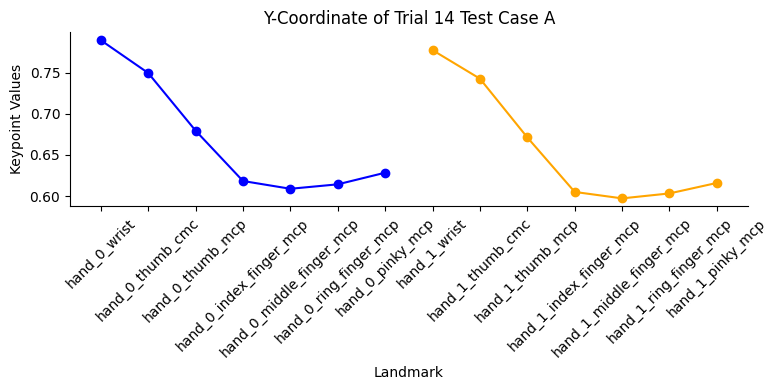

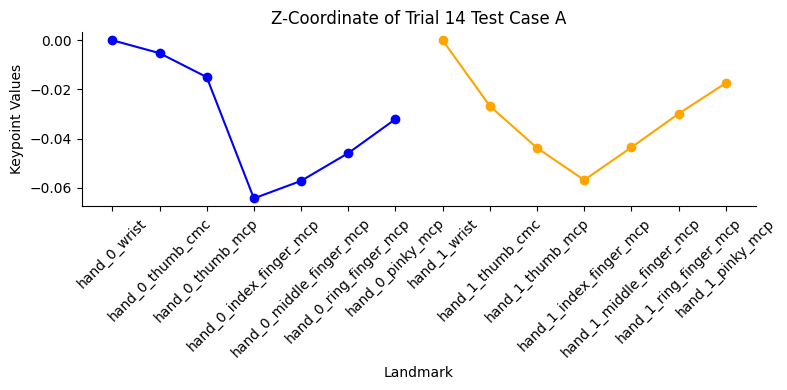

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

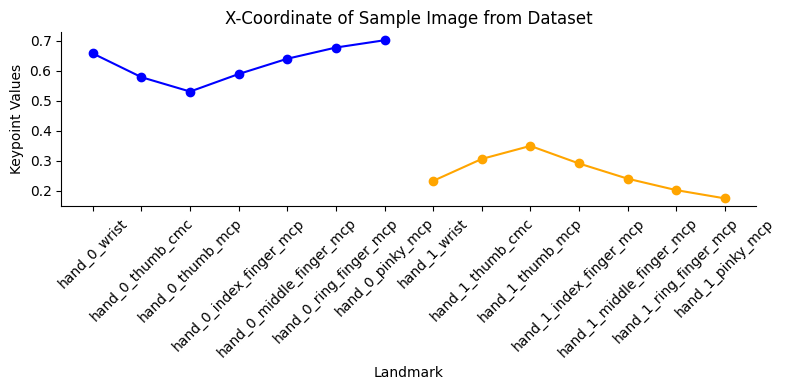

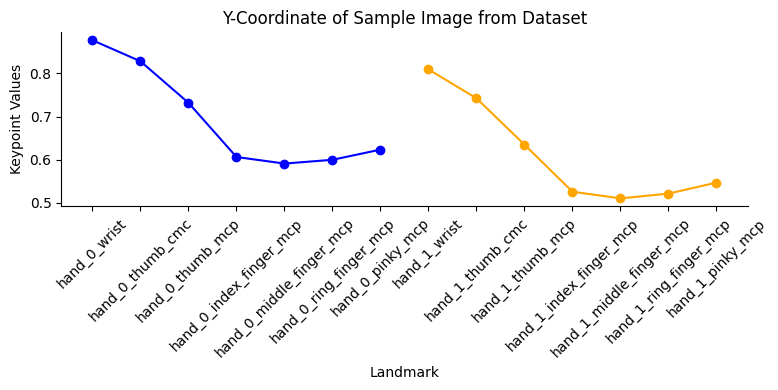

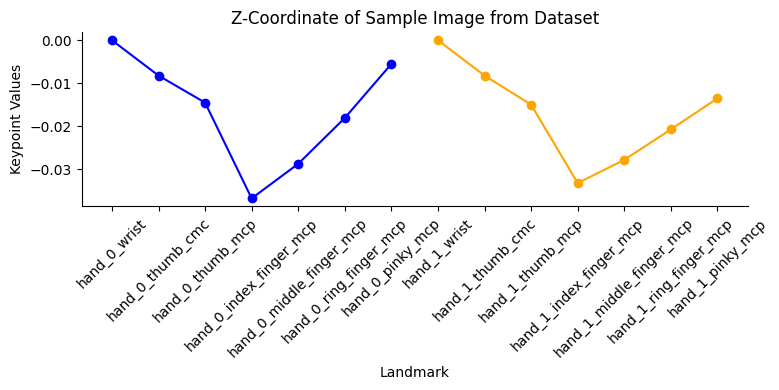

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Trial 15**

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Correct - Test A/TestA_correct15.png'
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Correct/Sample Trial 15.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial5)
sample_correct1_landmarks = extract_landmarks(sample_correct5)

Trial 1

In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.690258,0.789521,2.045675e-07,0
1,hand_0_thumb_cmc,0.617333,0.749665,-5.240503e-03,0
2,hand_0_thumb_mcp,0.580082,0.679558,-1.497378e-02,0
3,hand_0_index_finger_mcp,0.631843,0.618353,-6.422886e-02,0
4,hand_0_middle_finger_mcp,0.681324,0.608923,-5.711791e-02,0
5,hand_0_ring_finger_mcp,0.719707,0.614327,-4.583342e-02,0
6,hand_0_pinky_mcp,0.746274,0.628461,-3.203278e-02,0
7,hand_1_wrist,0.185953,0.777488,6.483552e-07,1
8,hand_1_thumb_cmc,0.248083,0.742778,-2.670907e-02,1
9,hand_1_thumb_mcp,0.285563,0.671351,-4.374463e-02,1


Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.657270,0.876975,2.087218e-07,0
1,hand_0_thumb_cmc,0.578161,0.828224,-8.214998e-03,0
2,hand_0_thumb_mcp,0.530297,0.731966,-1.451133e-02,0
3,hand_0_index_finger_mcp,0.588828,0.606389,-3.676527e-02,0
4,hand_0_middle_finger_mcp,0.639776,0.591215,-2.872718e-02,0
5,hand_0_ring_finger_mcp,0.677130,0.599915,-1.806493e-02,0
6,hand_0_pinky_mcp,0.701419,0.623527,-5.508841e-03,0
7,hand_1_wrist,0.232495,0.809390,4.170115e-07,1
8,hand_1_thumb_cmc,0.305615,0.742448,-8.216304e-03,1
9,hand_1_thumb_mcp,0.349073,0.635004,-1.497043e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = trial1_data[trial1_data['Hand'] == 0]
test_hand1_data = trial1_data[trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = sample1_data[sample1_data['Hand'] == 0]
sample_hand1_data = sample1_data[sample1_data['Hand'] == 1]

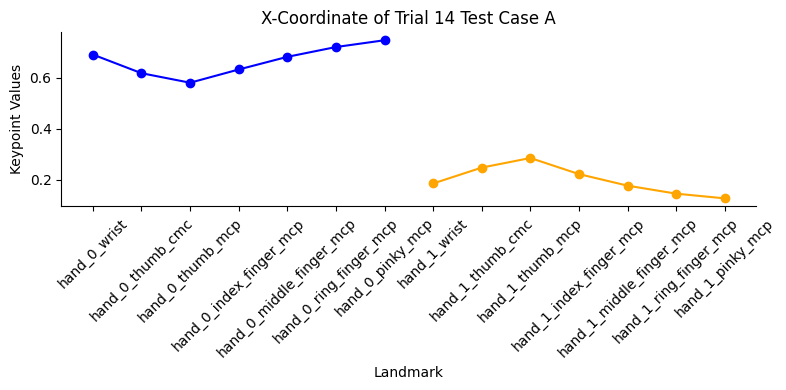

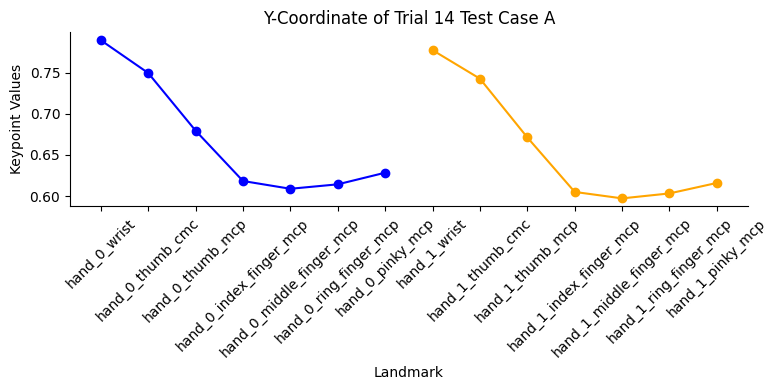

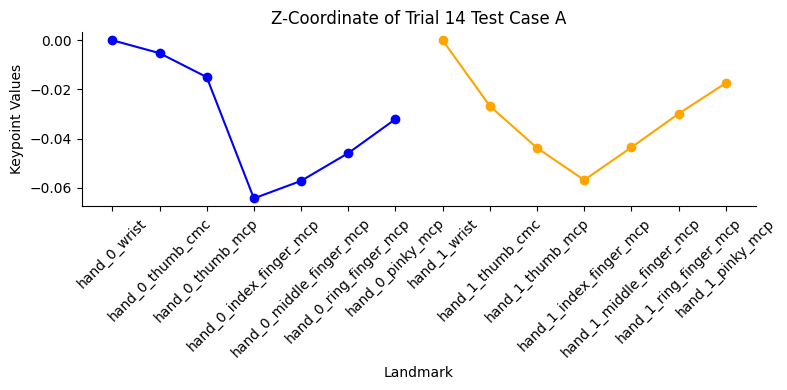

In [ ]:
# @title Trial 6 Test Case A

# X-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(trial1_data['Landmark'])), labels=trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 14 Test Case A")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

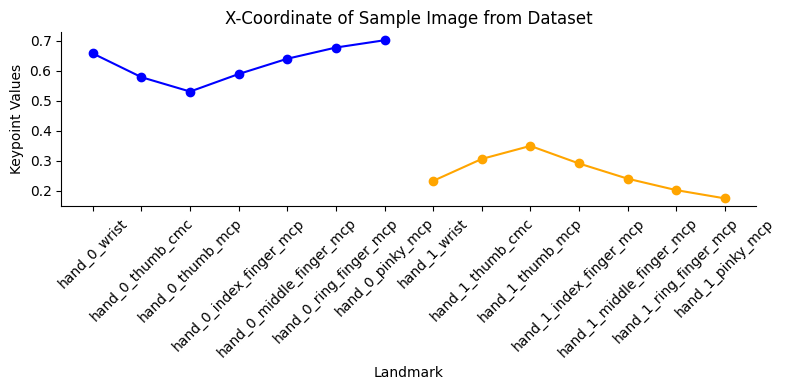

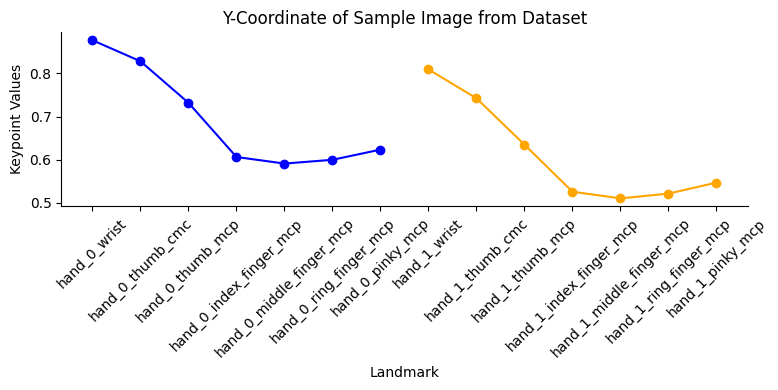

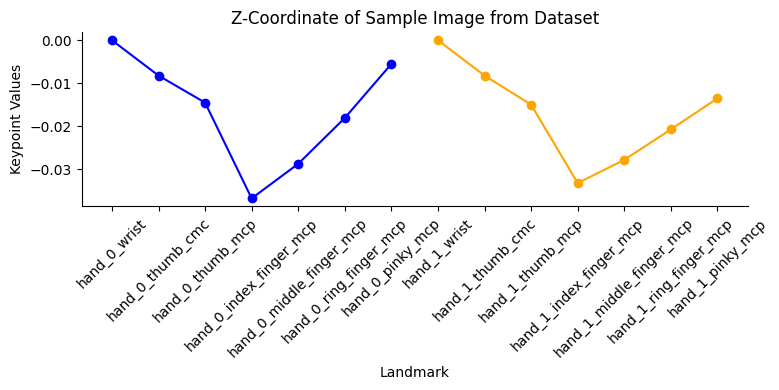

In [ ]:
# @title Sample Image from Dataset

# X-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4),  marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Y-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), label="Left Hand", marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), label="Right Hand", marker='o', color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

# Z-coordinate
plt.figure(figsize=(3, 2))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Left Hand", color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), marker='o', label="Right Hand", color='orange')
plt.xticks(ticks=range(len(sample1_data['Landmark'])), labels=sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

###**Incorrect Hand Postures**

In [ ]:
incorrect_trial1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Incorrect/TestA_incorrect1.png'
sample_incorrect1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/TestA_incorrect1.png'

In [ ]:
test_inc1_landmarks = extract_landmarks(incorrect_trial1)
sample_incorrect1_landmarks = extract_landmarks(sample_incorrect1)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


Trial 1

In [ ]:
import pandas as pd
incorrect_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_inc1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = incorrect_trial1_data.append(first_trial1_data)

inc_trial1_data = pd.concat(incorrect_trial1_data, ignore_index=True)
print("Incorrect Hand Posture Trial 1 (Test A)")
inc_trial1_data

Incorrect Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.718503,0.630085,1.695447e-07,0
1,hand_0_thumb_cmc,0.626576,0.661043,-3.330264e-03,0
2,hand_0_thumb_mcp,0.555105,0.622200,7.688199e-04,0
3,hand_0_index_finger_mcp,0.565417,0.475941,-2.499922e-02,0
4,hand_0_middle_finger_mcp,0.428322,0.329775,1.824885e-02,0
5,hand_0_ring_finger_mcp,0.644103,0.399652,-4.779731e-03,0
6,hand_0_pinky_mcp,0.680169,0.401150,8.951677e-03,0
7,hand_1_wrist,0.157812,0.674102,6.794560e-07,1
8,hand_1_thumb_cmc,0.236989,0.686853,-2.392724e-02,1
9,hand_1_thumb_mcp,0.302817,0.627904,-3.577305e-02,1


Sample Dataset

In [ ]:
sample_incorrect1_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_incorrect1_data.append(sample_trial1_data)

inc_sample1_data = pd.concat(sample_incorrect1_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample1_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.668926,0.664637,3.132465e-07,0
1,hand_0_thumb_cmc,0.597082,0.691284,-1.175373e-02,0
2,hand_0_thumb_mcp,0.531534,0.663251,-2.917816e-02,0
3,hand_0_index_finger_mcp,0.541996,0.515498,-5.259868e-02,0
4,hand_0_middle_finger_mcp,0.408011,0.375248,-7.087070e-02,0
5,hand_0_ring_finger_mcp,0.617673,0.417696,-5.473869e-02,0
6,hand_0_pinky_mcp,0.652134,0.404753,-5.478007e-02,0
7,hand_1_wrist,0.184503,0.691257,6.374933e-07,1
8,hand_1_thumb_cmc,0.259018,0.706055,-2.754111e-02,1
9,hand_1_thumb_mcp,0.318871,0.653893,-4.475560e-02,1


Separate the data by hand

In [ ]:
# Trial 1 (Test Case A)
test_hand0_data = inc_trial1_data[inc_trial1_data['Hand'] == 0]
test_hand1_data = inc_trial1_data[inc_trial1_data['Hand'] == 1]

In [ ]:
# Sample Image from the Dataset
sample_hand0_data = inc_sample1_data[inc_sample1_data['Hand'] == 0]
sample_hand1_data = inc_sample1_data[inc_sample1_data['Hand'] == 1]

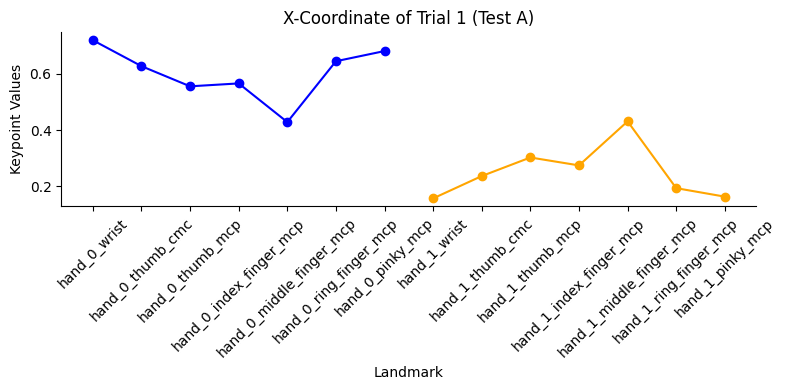

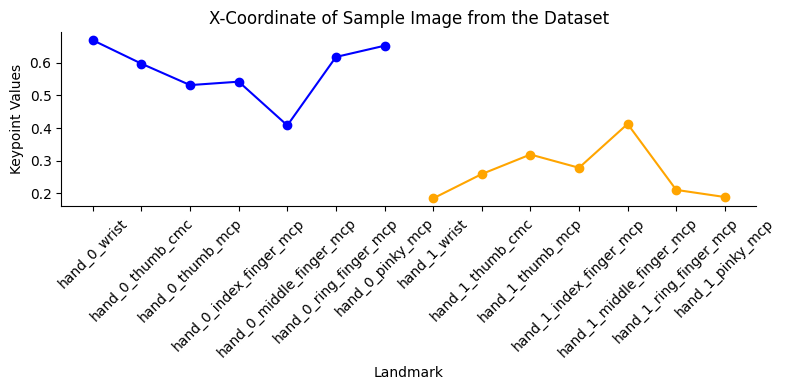

In [ ]:
# @title X-Coordinate

plt.figure(figsize=(8, 4))
test_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
test_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(inc_trial1_data['Landmark'])), labels=inc_trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Trial 1 (Test A)")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 4))
sample_hand0_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='blue')
sample_hand1_data['X'].plot(kind='line', figsize=(8, 4), marker='o', color='orange')
plt.xticks(ticks=range(len(inc_sample1_data['Landmark'])), labels=inc_sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("X-Coordinate of Sample Image from the Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

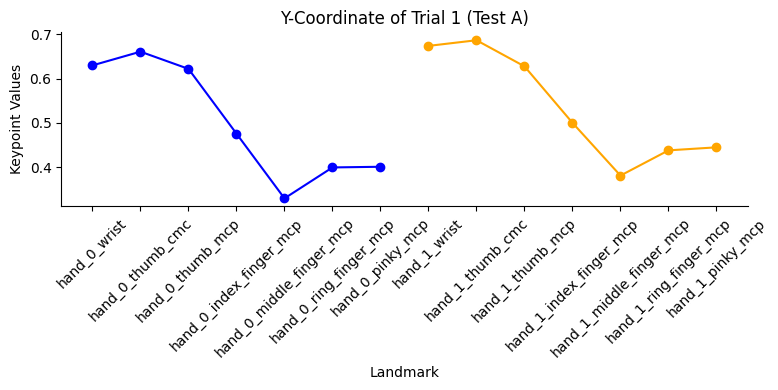

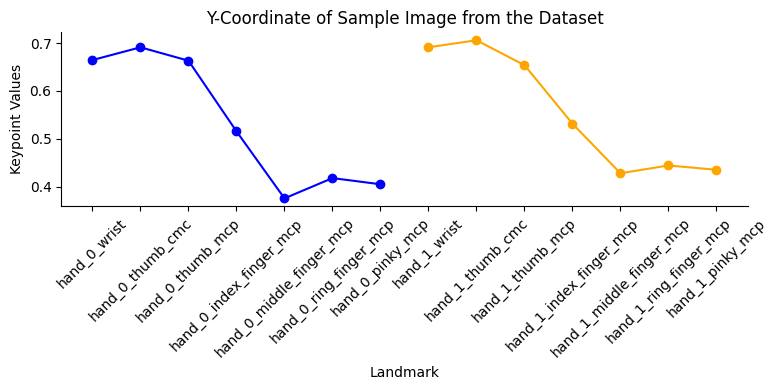

In [ ]:
# @title Y-Coordinate

plt.figure(figsize=(8, 4))
test_hand0_data['Y'].plot(kind='line', figsize=(8, 4), title='Y', marker='o', color='blue')
test_hand1_data['Y'].plot(kind='line', figsize=(8, 4), title='Y', marker='o', color='orange')
plt.xticks(ticks=range(len(inc_trial1_data['Landmark'])), labels=inc_trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Trial 1 (Test A)")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 4))
sample_hand0_data['Y'].plot(kind='line', figsize=(8, 4), title='Y', marker='o', color='blue')
sample_hand1_data['Y'].plot(kind='line', figsize=(8, 4), title='Y', marker='o', color='orange')
plt.xticks(ticks=range(len(inc_sample1_data['Landmark'])), labels=inc_sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Y-Coordinate of Sample Image from the Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

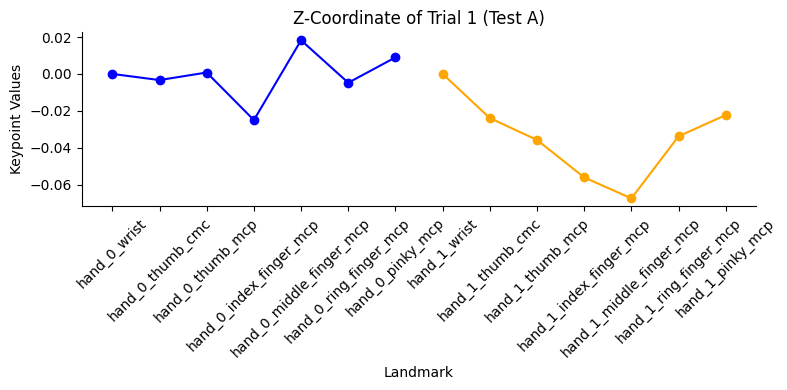

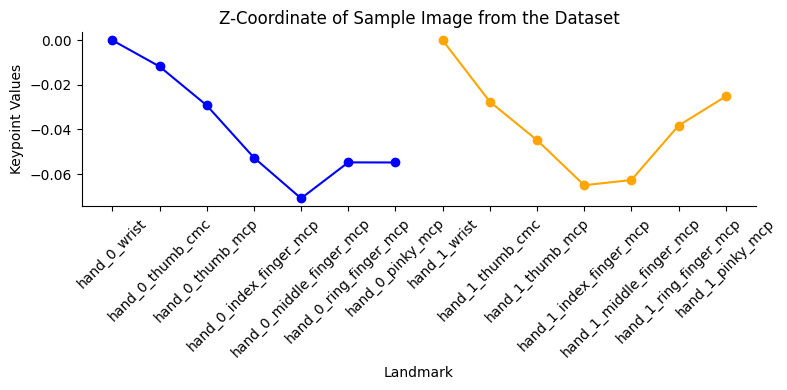

In [ ]:
# @title Z-Coordinate

plt.figure(figsize=(8, 4))
test_hand0_data['Z'].plot(kind='line', figsize=(8, 4), title='Z', marker='o', color='blue')
test_hand1_data['Z'].plot(kind='line', figsize=(8, 4), title='Z', marker='o', color='orange')
plt.xticks(ticks=range(len(inc_trial1_data['Landmark'])), labels=inc_trial1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Trial 1 (Test A)")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 4))
sample_hand0_data['Z'].plot(kind='line', figsize=(8, 4), title='Z', marker='o', color='blue')
sample_hand1_data['Z'].plot(kind='line', figsize=(8, 4), title='Z', marker='o', color='orange')
plt.xticks(ticks=range(len(inc_sample1_data['Landmark'])), labels=inc_sample1_data['Landmark'], rotation=45)
plt.gca().spines[['top', 'right']].set_visible(False)
plt.title("Z-Coordinate of Sample Image from the Dataset")
plt.xlabel('Landmark')
plt.ylabel('Keypoint Values')
plt.tight_layout()
plt.show()

#**Using Heatmap**

##**Correct Hand Posture**

###**Trial 1 Comparison**

Trial 1

In [ ]:
correct_trial1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct1.png'
sample_correct1 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 3.jpg'

In [ ]:
test1_landmarks = extract_landmarks(correct_trial1)
sample_correct1_landmarks = extract_landmarks(sample_correct1)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial1_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial1_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.323570,0.237967,2.774169e-07,0
1,hand_0_thumb_cmc,0.398603,0.279943,5.690333e-04,0
2,hand_0_thumb_mcp,0.438352,0.346127,-4.970076e-03,0
3,hand_0_index_finger_mcp,0.387352,0.421872,-5.587782e-02,0
4,hand_0_middle_finger_mcp,0.338513,0.433213,-4.791001e-02,0
5,hand_0_ring_finger_mcp,0.299271,0.428222,-3.268483e-02,0
6,hand_0_pinky_mcp,0.272822,0.414786,-1.398345e-02,0
7,hand_1_wrist,0.828432,0.241975,6.558561e-07,1
8,hand_1_thumb_cmc,0.765817,0.272489,-2.696123e-02,1
9,hand_1_thumb_mcp,0.724145,0.335006,-4.382577e-02,1


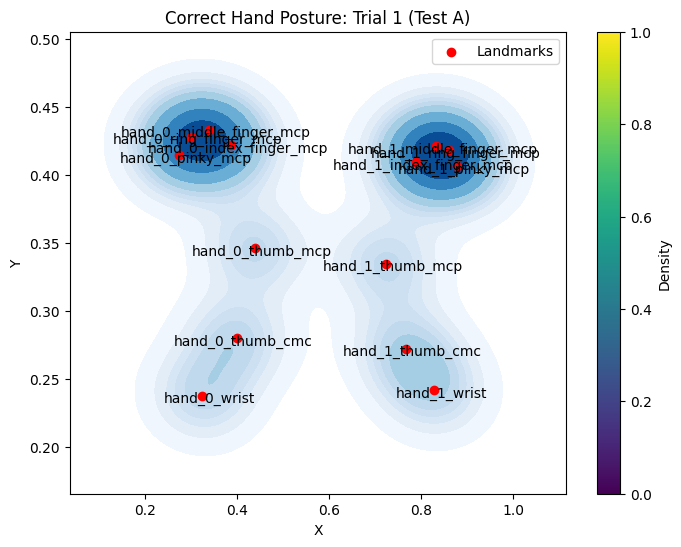

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial1_data['X'], y=trial1_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial1_data['X'], trial1_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial1_data['Landmark']):
    plt.annotate(landmark, (trial1_data['X'][i], trial1_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture: Trial 1 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct1_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct1_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial1_data = pd.DataFrame(data)
    sample_trial1_data['Hand'] = hand_idx
    sample1_data = sample_correct1_data.append(sample_trial1_data)

sample1_data = pd.concat(sample_correct1_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample1_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.298386,0.242581,1.620388e-07,0
1,hand_0_thumb_cmc,0.377286,0.297796,-5.900682e-03,0
2,hand_0_thumb_mcp,0.416301,0.404806,-7.314712e-03,0
3,hand_0_index_finger_mcp,0.360534,0.524397,-3.241222e-02,0
4,hand_0_middle_finger_mcp,0.310738,0.535923,-2.301013e-02,0
5,hand_0_ring_finger_mcp,0.272416,0.522081,-1.048513e-02,0
6,hand_0_pinky_mcp,0.245980,0.492035,3.081319e-03,0
7,hand_1_wrist,0.767966,0.207356,5.026708e-07,1
8,hand_1_thumb_cmc,0.695540,0.264634,-1.730843e-02,1
9,hand_1_thumb_mcp,0.655939,0.372372,-2.625289e-02,1


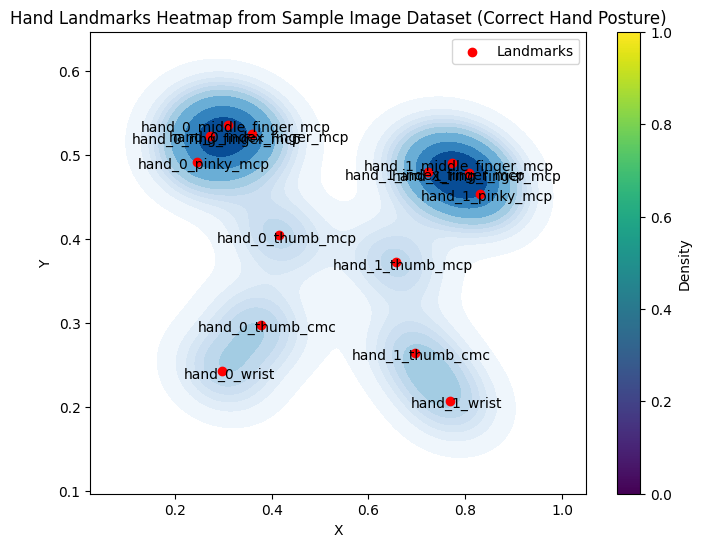

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample1_data['X'], y=sample1_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample1_data['X'], sample1_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample1_data['Landmark']):
    plt.annotate(landmark, (sample1_data['X'][i], sample1_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 2 Comparison**

Trial 2

In [ ]:
correct_trial2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct2.png'
sample_correct2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 2.jpg'

In [ ]:
test_landmarks = extract_landmarks(correct_trial2)
sample_correct2_landmarks = extract_landmarks(sample_correct2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial2_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial2_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.316591,0.233847,2.752325e-07,0
1,hand_0_thumb_cmc,0.393854,0.278010,-1.691835e-03,0
2,hand_0_thumb_mcp,0.429200,0.347317,-8.412882e-03,0
3,hand_0_index_finger_mcp,0.380178,0.417843,-6.587825e-02,0
4,hand_0_middle_finger_mcp,0.332038,0.429602,-5.381587e-02,0
5,hand_0_ring_finger_mcp,0.294896,0.425284,-3.456515e-02,0
6,hand_0_pinky_mcp,0.270870,0.414767,-1.183025e-02,0
7,hand_1_wrist,0.833754,0.241919,5.940203e-07,1
8,hand_1_thumb_cmc,0.770606,0.269505,-2.444833e-02,1
9,hand_1_thumb_mcp,0.732368,0.335899,-3.847456e-02,1


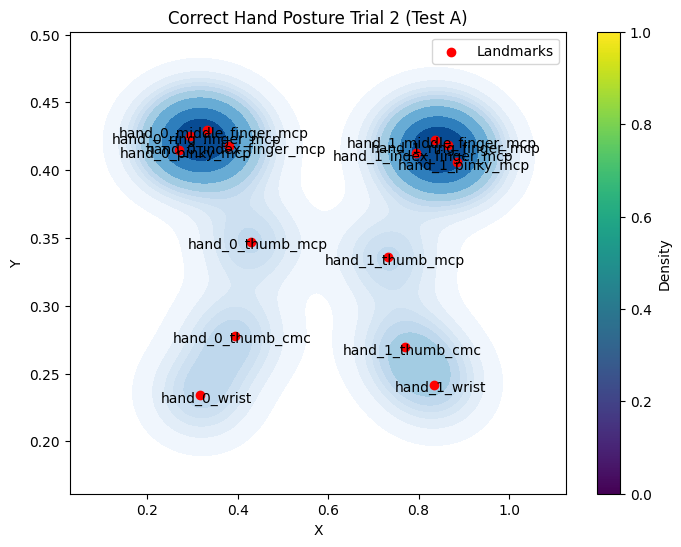

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial2_data['X'], y=trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial2_data['X'], trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial2_data['Landmark']):
    plt.annotate(landmark, (trial2_data['X'][i], trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 2 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct2_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample1_data = sample_correct2_data.append(sample_trial2_data)

sample2_data = pd.concat(sample_correct2_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample2_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.274127,0.252797,1.511992e-07,0
1,hand_0_thumb_cmc,0.362596,0.303733,-2.041805e-03,0
2,hand_0_thumb_mcp,0.403404,0.416513,8.405002e-04,0
3,hand_0_index_finger_mcp,0.346009,0.548903,-2.462631e-02,0
4,hand_0_middle_finger_mcp,0.291385,0.563280,-1.349646e-02,0
5,hand_0_ring_finger_mcp,0.251406,0.547158,1.027794e-03,0
6,hand_0_pinky_mcp,0.222336,0.514412,1.758816e-02,0
7,hand_1_wrist,0.792780,0.168972,5.846115e-07,1
8,hand_1_thumb_cmc,0.711369,0.222172,-2.278868e-02,1
9,hand_1_thumb_mcp,0.662524,0.337024,-3.226120e-02,1


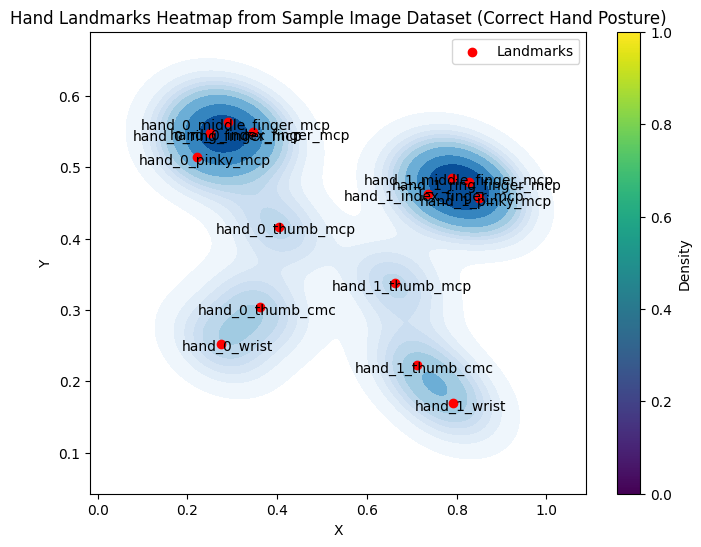

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample2_data['X'], y=sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample2_data['X'], sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample2_data['Landmark']):
    plt.annotate(landmark, (sample2_data['X'][i], sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 3 Comparison**

Trial 3

In [ ]:
correct_trial3 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct3.png'


In [ ]:
test3_landmarks = extract_landmarks(correct_trial3)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test3_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial1_data = pd.DataFrame(data)
    first_trial1_data['Hand'] = hand_idx
    trial1_data = correct_trial1_data.append(first_trial1_data)

trial3_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial3_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.323012,0.168853,2.384396e-07,0
1,hand_0_thumb_cmc,0.398682,0.201773,-5.853155e-03,0
2,hand_0_thumb_mcp,0.439675,0.271427,-1.350094e-02,0
3,hand_0_index_finger_mcp,0.387099,0.341080,-5.645002e-02,0
4,hand_0_middle_finger_mcp,0.336205,0.352635,-4.962558e-02,0
5,hand_0_ring_finger_mcp,0.298711,0.349713,-3.820040e-02,0
6,hand_0_pinky_mcp,0.273962,0.335887,-2.441121e-02,0
7,hand_1_wrist,0.812130,0.238705,6.935963e-07,1
8,hand_1_thumb_cmc,0.748497,0.268944,-2.933041e-02,1
9,hand_1_thumb_mcp,0.709855,0.333375,-4.951023e-02,1


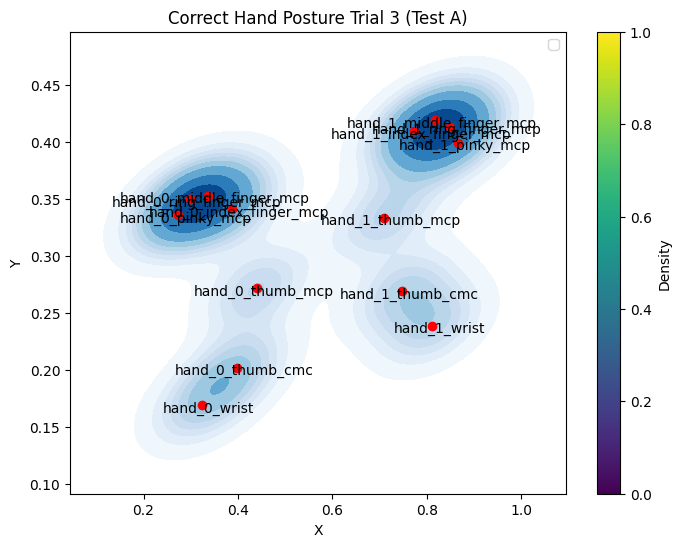

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial3_data['X'], y=trial3_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial3_data['X'], trial3_data['Y'], color='red')

# Annotate points
for i, landmark in enumerate(trial3_data['Landmark']):
    plt.annotate(landmark, (trial3_data['X'][i], trial3_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 3 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct2_landmarks = extract_landmarks(sample_correct2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct2_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample1_data = sample_correct2_data.append(sample_trial2_data)

sample2_data = pd.concat(sample_correct2_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample2_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


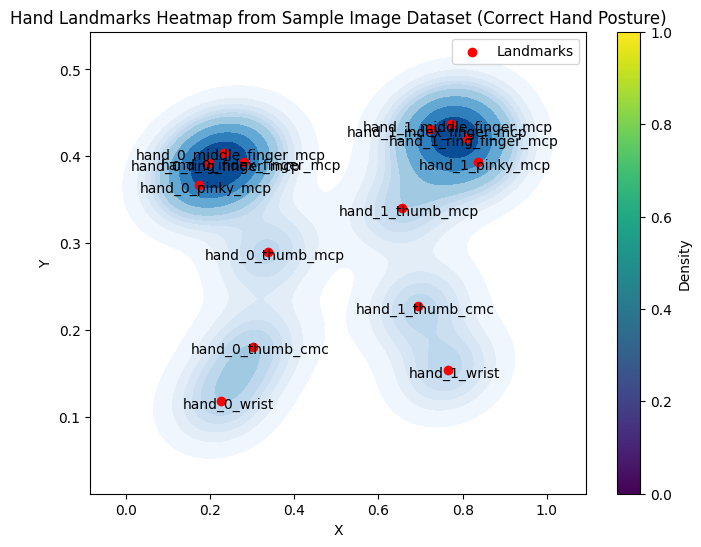

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample2_data['X'], y=sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample2_data['X'], sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample2_data['Landmark']):
    plt.annotate(landmark, (sample2_data['X'][i], sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 4 Comparison**

Trial 4

In [ ]:
correct_trial4 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct4.png'

In [ ]:
test4_landmarks = extract_landmarks(correct_trial4)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial1_data = []
for hand_idx, hand_landmarks in enumerate(test4_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial4_data = pd.DataFrame(data)
    first_trial4_data['Hand'] = hand_idx
    trial4_data = correct_trial1_data.append(first_trial4_data)

trial4_data = pd.concat(correct_trial1_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial4_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.336593,0.168921,2.538432e-07,0
1,hand_0_thumb_cmc,0.410681,0.206834,-7.126080e-03,0
2,hand_0_thumb_mcp,0.447760,0.277032,-1.809218e-02,0
3,hand_0_index_finger_mcp,0.398841,0.333492,-7.602369e-02,0
4,hand_0_middle_finger_mcp,0.349525,0.345859,-6.852760e-02,0
5,hand_0_ring_finger_mcp,0.310643,0.344132,-5.587528e-02,0
6,hand_0_pinky_mcp,0.283753,0.332991,-4.093044e-02,0
7,hand_1_wrist,0.802918,0.226318,6.097659e-07,1
8,hand_1_thumb_cmc,0.740383,0.256466,-2.808574e-02,1
9,hand_1_thumb_mcp,0.700630,0.323361,-4.672170e-02,1


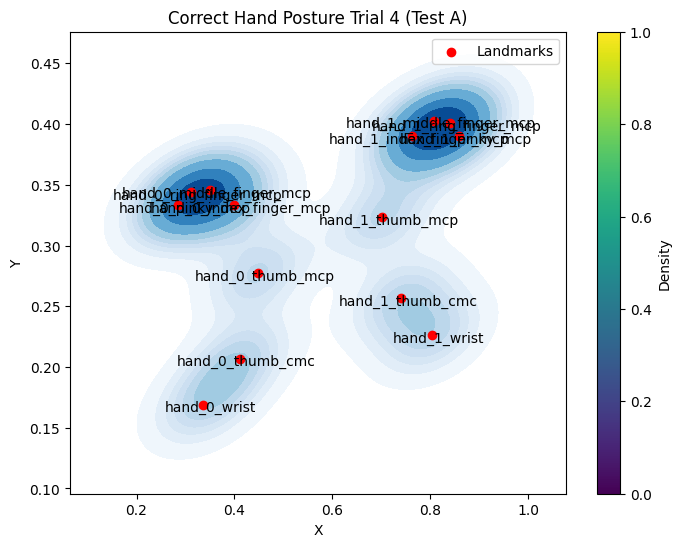

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial4_data['X'], y=trial4_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial4_data['X'], trial4_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial4_data['Landmark']):
    plt.annotate(landmark, (trial4_data['X'][i], trial4_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 4 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct4 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct4_landmarks = extract_landmarks(sample_correct4)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct4_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct4_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial4_data = pd.DataFrame(data)
    sample_trial4_data['Hand'] = hand_idx
    sample1_data = sample_correct4_data.append(sample_trial4_data)

sample4_data = pd.concat(sample_correct4_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample4_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


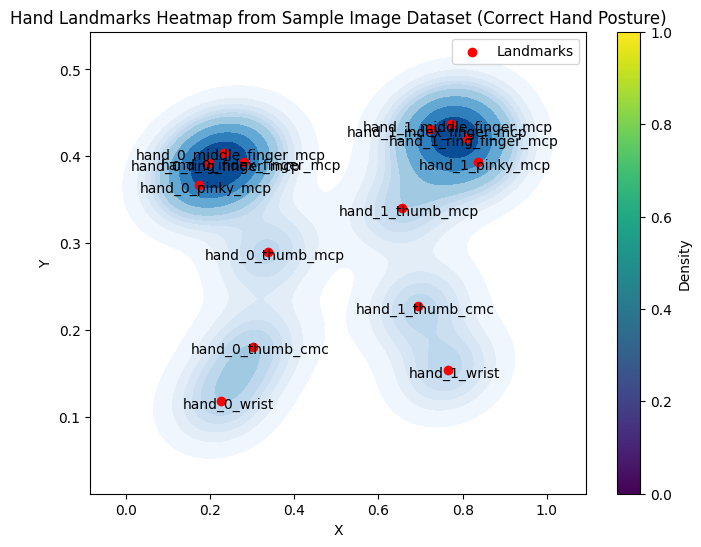

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample4_data['X'], y=sample4_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample4_data['X'], sample4_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample4_data['Landmark']):
    plt.annotate(landmark, (sample4_data['X'][i], sample4_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 5 Comparison**

Trial 5

In [ ]:
correct_trial5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct5.png'

In [ ]:
test5_landmarks = extract_landmarks(correct_trial5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial5_data = []
for hand_idx, hand_landmarks in enumerate(test5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial5_data = pd.DataFrame(data)
    first_trial5_data['Hand'] = hand_idx
    trial5_data = correct_trial5_data.append(first_trial5_data)

trial5_data = pd.concat(correct_trial5_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial5_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.308912,0.220221,2.343733e-07,0
1,hand_0_thumb_cmc,0.385828,0.264816,-2.362451e-03,0
2,hand_0_thumb_mcp,0.426415,0.335297,-7.239050e-03,0
3,hand_0_index_finger_mcp,0.372757,0.409748,-5.815015e-02,0
4,hand_0_middle_finger_mcp,0.322757,0.419095,-4.822269e-02,0
5,hand_0_ring_finger_mcp,0.284366,0.412462,-3.173628e-02,0
6,hand_0_pinky_mcp,0.258332,0.396608,-1.221226e-02,0
7,hand_1_wrist,0.802588,0.214198,6.292484e-07,1
8,hand_1_thumb_cmc,0.741368,0.249839,-2.669885e-02,1
9,hand_1_thumb_mcp,0.702676,0.318295,-4.449085e-02,1


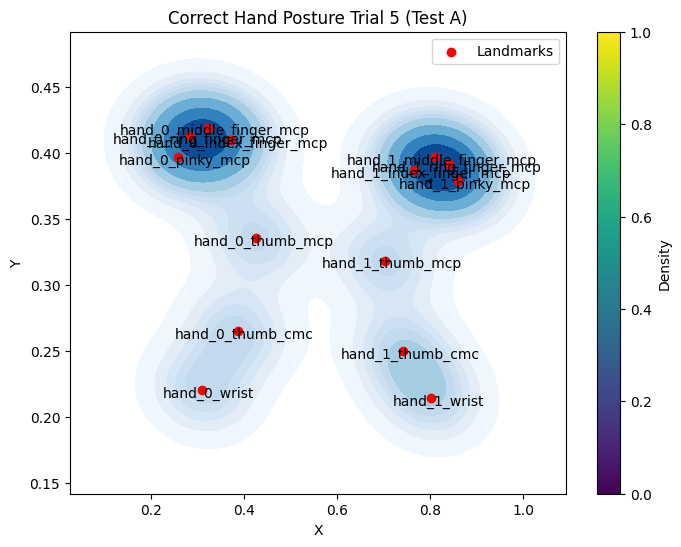

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial5_data['X'], y=trial5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial5_data['X'], trial5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial5_data['Landmark']):
    plt.annotate(landmark, (trial5_data['X'][i], trial5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 5 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 2.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.274127,0.252797,1.511992e-07,0
1,hand_0_thumb_cmc,0.362596,0.303733,-2.041805e-03,0
2,hand_0_thumb_mcp,0.403404,0.416513,8.405002e-04,0
3,hand_0_index_finger_mcp,0.346009,0.548903,-2.462631e-02,0
4,hand_0_middle_finger_mcp,0.291385,0.563280,-1.349646e-02,0
5,hand_0_ring_finger_mcp,0.251406,0.547158,1.027794e-03,0
6,hand_0_pinky_mcp,0.222336,0.514412,1.758816e-02,0
7,hand_1_wrist,0.792780,0.168972,5.846115e-07,1
8,hand_1_thumb_cmc,0.711369,0.222172,-2.278868e-02,1
9,hand_1_thumb_mcp,0.662524,0.337024,-3.226120e-02,1


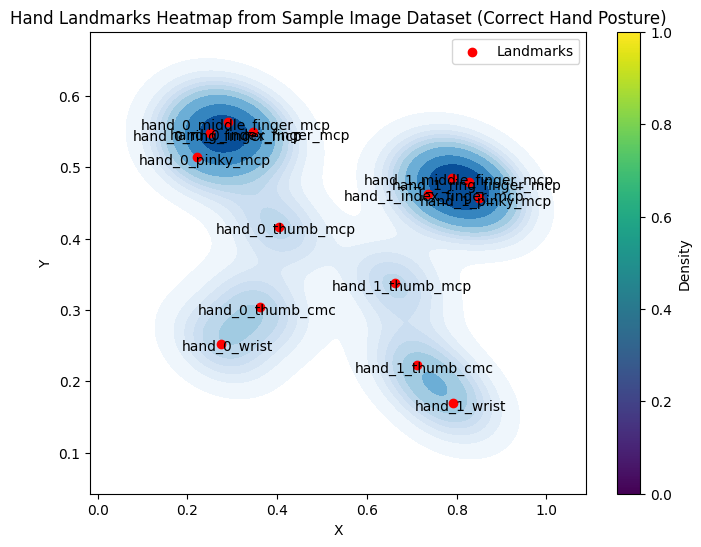

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 6 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct6.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305541,0.198368,2.154283e-07,0
1,hand_0_thumb_cmc,0.380151,0.252196,4.027098e-04,0
2,hand_0_thumb_mcp,0.418215,0.320821,-7.040887e-03,0
3,hand_0_index_finger_mcp,0.366692,0.386858,-7.473288e-02,0
4,hand_0_middle_finger_mcp,0.317436,0.394318,-6.214141e-02,0
5,hand_0_ring_finger_mcp,0.279494,0.388410,-4.135333e-02,0
6,hand_0_pinky_mcp,0.254360,0.375464,-1.636796e-02,0
7,hand_1_wrist,0.824603,0.225797,6.135598e-07,1
8,hand_1_thumb_cmc,0.764085,0.266082,-2.785635e-02,1
9,hand_1_thumb_mcp,0.730147,0.337281,-4.685477e-02,1


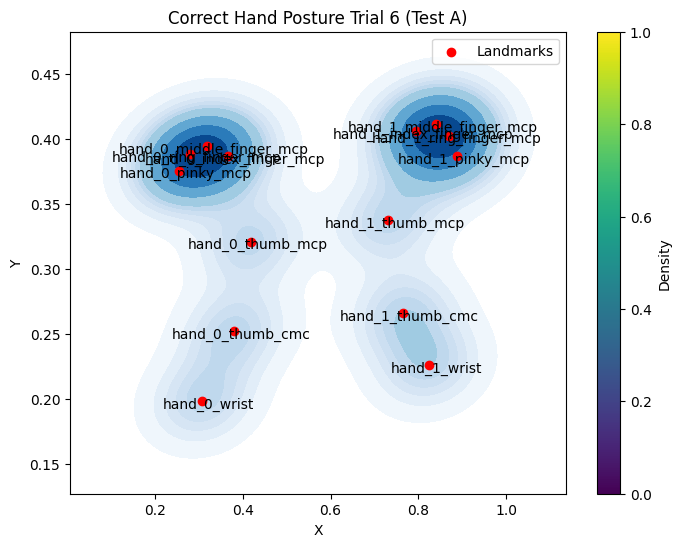

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 6 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 26.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.675876,0.080234,5.286436e-07,0
1,hand_0_thumb_cmc,0.600549,0.133938,-1.153417e-02,0
2,hand_0_thumb_mcp,0.549859,0.232190,-1.997313e-02,0
3,hand_0_index_finger_mcp,0.609468,0.357603,-3.775506e-02,0
4,hand_0_middle_finger_mcp,0.661035,0.370230,-3.118308e-02,0
5,hand_0_ring_finger_mcp,0.701424,0.357799,-2.345959e-02,0
6,hand_0_pinky_mcp,0.729445,0.332700,-1.579922e-02,0
7,hand_1_wrist,0.242544,0.143885,1.624778e-07,1
8,hand_1_thumb_cmc,0.315186,0.206168,-7.561557e-03,1
9,hand_1_thumb_mcp,0.357842,0.304820,-1.383343e-02,1


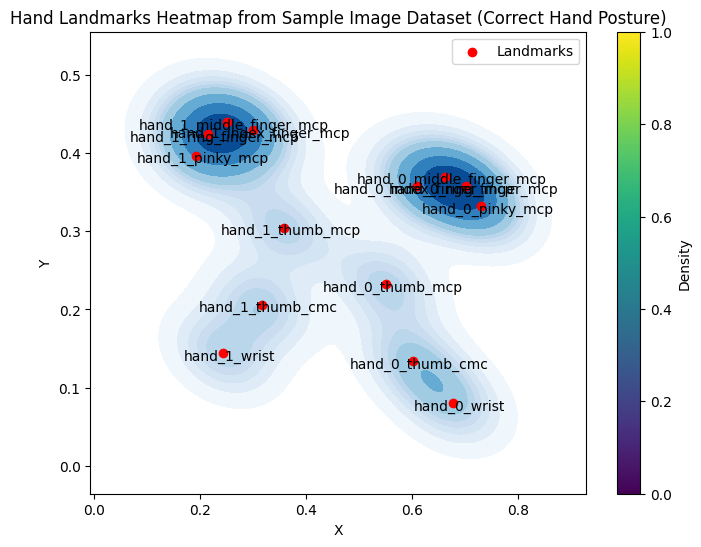

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 7 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct7.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305996,0.205404,2.207244e-07,0
1,hand_0_thumb_cmc,0.380291,0.244765,-3.953775e-03,0
2,hand_0_thumb_mcp,0.418202,0.315394,-1.268045e-02,0
3,hand_0_index_finger_mcp,0.364990,0.379573,-6.529036e-02,0
4,hand_0_middle_finger_mcp,0.316220,0.389572,-5.613788e-02,0
5,hand_0_ring_finger_mcp,0.278049,0.384700,-4.227658e-02,0
6,hand_0_pinky_mcp,0.252824,0.372307,-2.584428e-02,0
7,hand_1_wrist,0.814073,0.220365,6.108009e-07,1
8,hand_1_thumb_cmc,0.749821,0.254583,-2.772048e-02,1
9,hand_1_thumb_mcp,0.712463,0.324259,-4.665778e-02,1


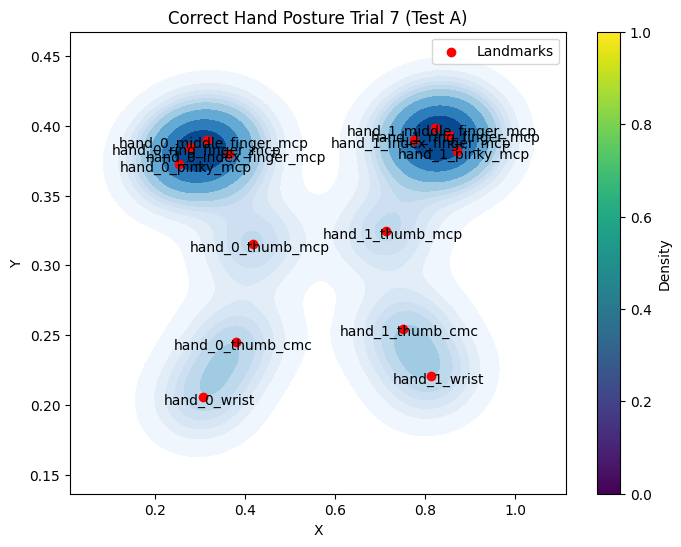

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 7 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 7.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.271994,0.163295,1.305951e-07,0
1,hand_0_thumb_cmc,0.349967,0.223641,-7.101125e-04,0
2,hand_0_thumb_mcp,0.391255,0.333311,1.680008e-04,0
3,hand_0_index_finger_mcp,0.338896,0.454638,-2.933821e-02,0
4,hand_0_middle_finger_mcp,0.287761,0.469460,-2.106573e-02,0
5,hand_0_ring_finger_mcp,0.248931,0.458158,-8.749455e-03,0
6,hand_0_pinky_mcp,0.223272,0.430044,5.255735e-03,0
7,hand_1_wrist,0.764883,0.129543,6.049705e-07,1
8,hand_1_thumb_cmc,0.693381,0.192541,-1.868544e-02,1
9,hand_1_thumb_mcp,0.648969,0.300342,-2.995525e-02,1


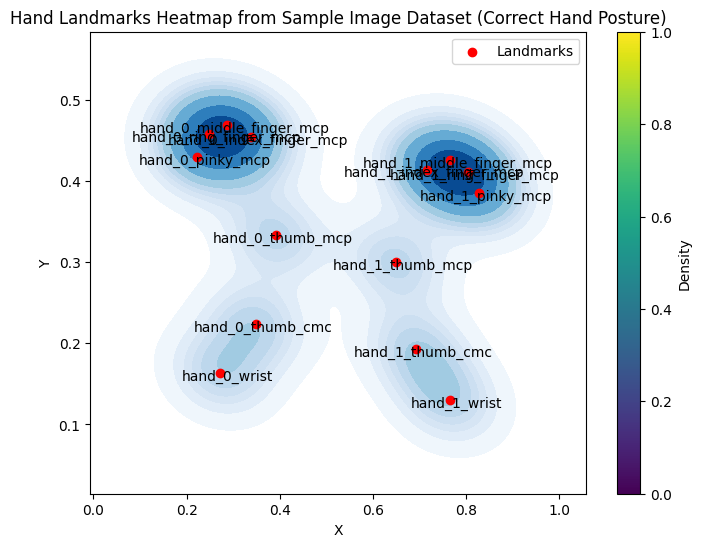

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 8 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct8.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305996,0.205404,2.207244e-07,0
1,hand_0_thumb_cmc,0.380291,0.244765,-3.953775e-03,0
2,hand_0_thumb_mcp,0.418202,0.315394,-1.268045e-02,0
3,hand_0_index_finger_mcp,0.364990,0.379573,-6.529036e-02,0
4,hand_0_middle_finger_mcp,0.316220,0.389572,-5.613788e-02,0
5,hand_0_ring_finger_mcp,0.278049,0.384700,-4.227658e-02,0
6,hand_0_pinky_mcp,0.252824,0.372307,-2.584428e-02,0
7,hand_1_wrist,0.814073,0.220365,6.108009e-07,1
8,hand_1_thumb_cmc,0.749821,0.254583,-2.772048e-02,1
9,hand_1_thumb_mcp,0.712463,0.324259,-4.665778e-02,1


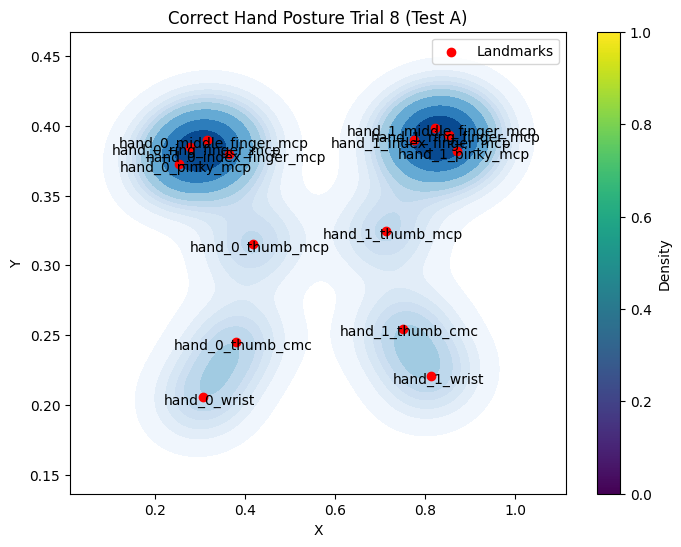

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 8 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 8.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.258569,0.116168,7.964138e-08,0
1,hand_0_thumb_cmc,0.332902,0.185024,2.609305e-03,0
2,hand_0_thumb_mcp,0.365614,0.301769,3.251238e-03,0
3,hand_0_index_finger_mcp,0.310373,0.404277,-2.750681e-02,0
4,hand_0_middle_finger_mcp,0.261035,0.412619,-2.449631e-02,0
5,hand_0_ring_finger_mcp,0.223541,0.395622,-1.772956e-02,0
6,hand_0_pinky_mcp,0.197964,0.362486,-9.452707e-03,0
7,hand_1_wrist,0.765847,0.131745,6.129441e-07,1
8,hand_1_thumb_cmc,0.695903,0.192141,-2.116191e-02,1
9,hand_1_thumb_mcp,0.654631,0.297018,-3.484398e-02,1


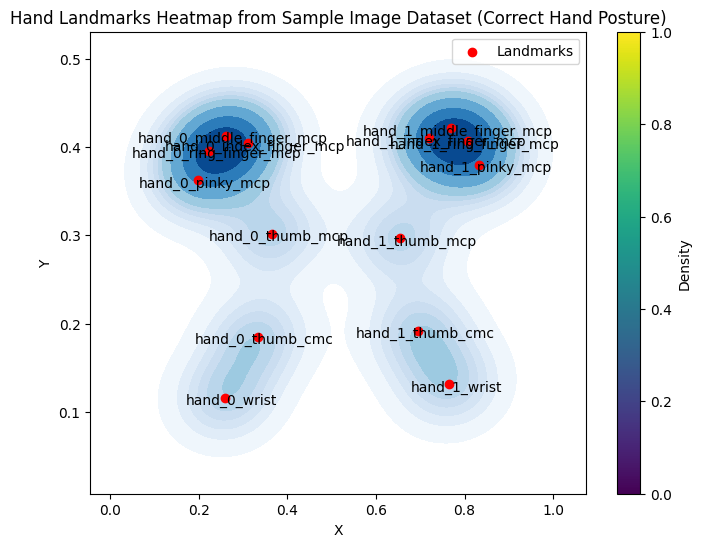

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 9 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct9.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.351799,0.224725,2.048207e-07,0
1,hand_0_thumb_cmc,0.429249,0.256127,-1.822243e-03,0
2,hand_0_thumb_mcp,0.470510,0.323336,-8.505917e-03,0
3,hand_0_index_finger_mcp,0.424953,0.392886,-6.211663e-02,0
4,hand_0_middle_finger_mcp,0.375481,0.406617,-5.739534e-02,0
5,hand_0_ring_finger_mcp,0.335244,0.406575,-4.713057e-02,0
6,hand_0_pinky_mcp,0.306254,0.396046,-3.436953e-02,0
7,hand_1_wrist,0.784517,0.226933,6.463044e-07,1
8,hand_1_thumb_cmc,0.722830,0.263704,-2.695409e-02,1
9,hand_1_thumb_mcp,0.684086,0.332416,-4.541296e-02,1


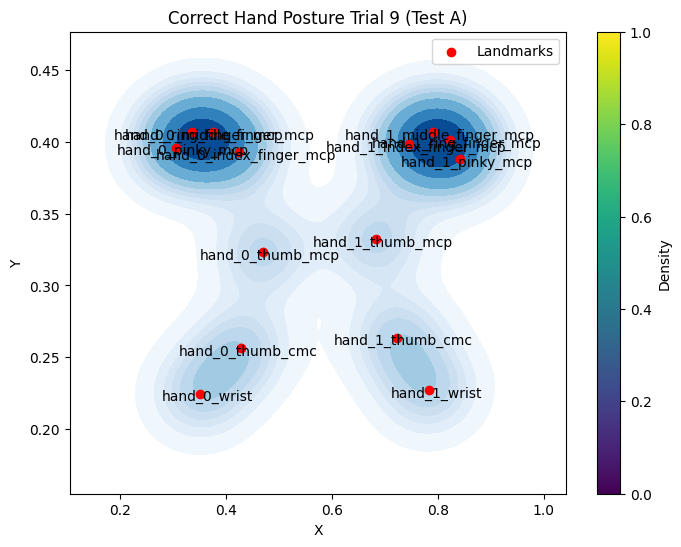

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 9 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 9.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.294651,0.160747,8.060847e-08,0
1,hand_0_thumb_cmc,0.369299,0.231464,-2.677960e-03,0
2,hand_0_thumb_mcp,0.403380,0.346068,-4.787783e-03,0
3,hand_0_index_finger_mcp,0.345154,0.446676,-3.235803e-02,0
4,hand_0_middle_finger_mcp,0.295340,0.453357,-2.517997e-02,0
5,hand_0_ring_finger_mcp,0.258179,0.437543,-1.459189e-02,0
6,hand_0_pinky_mcp,0.234476,0.406264,-3.158159e-03,0
7,hand_1_wrist,0.789246,0.124341,6.563433e-07,1
8,hand_1_thumb_cmc,0.721093,0.182541,-2.081626e-02,1
9,hand_1_thumb_mcp,0.679164,0.288024,-3.546873e-02,1


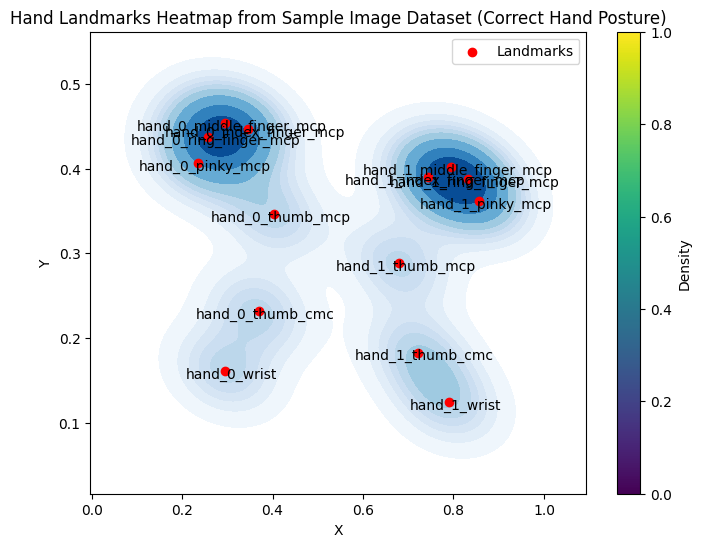

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 10 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct10.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.343401,0.203215,2.701072e-07,0
1,hand_0_thumb_cmc,0.424194,0.245452,-4.825676e-03,0
2,hand_0_thumb_mcp,0.466063,0.312725,-1.465792e-02,0
3,hand_0_index_finger_mcp,0.416978,0.388367,-7.985296e-02,0
4,hand_0_middle_finger_mcp,0.366769,0.400265,-7.222301e-02,0
5,hand_0_ring_finger_mcp,0.326247,0.397373,-5.709377e-02,0
6,hand_0_pinky_mcp,0.297718,0.385233,-3.928913e-02,0
7,hand_1_wrist,0.802669,0.257956,6.678038e-07,1
8,hand_1_thumb_cmc,0.741014,0.291403,-2.764732e-02,1
9,hand_1_thumb_mcp,0.706083,0.361621,-4.415280e-02,1


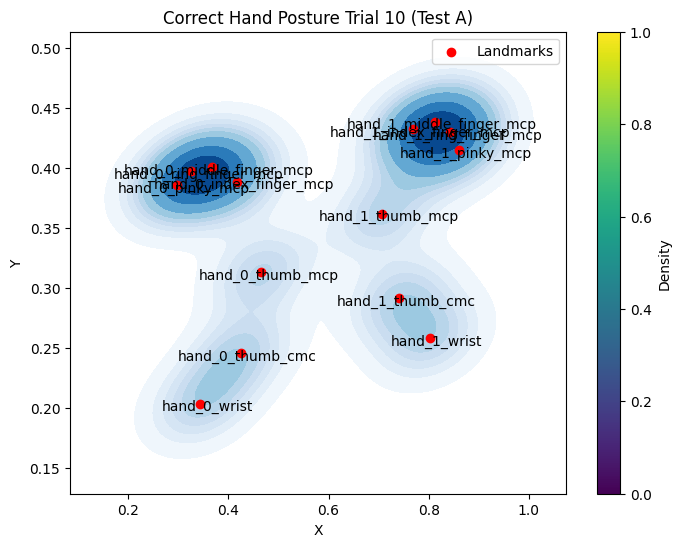

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 10 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


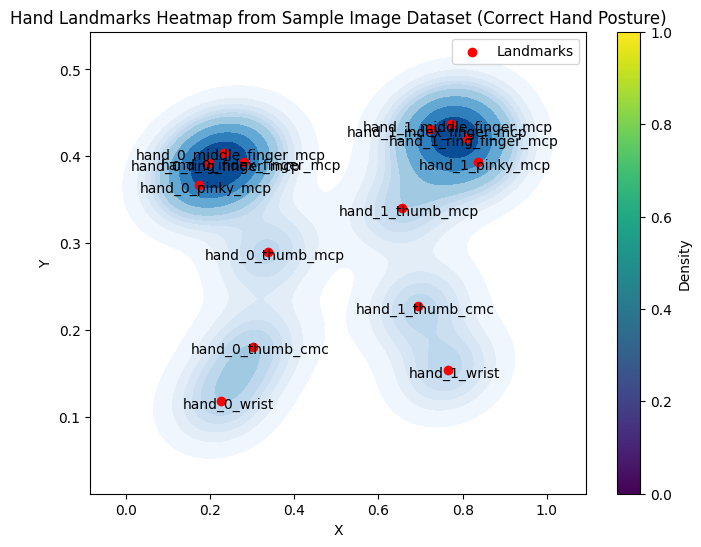

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct11.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.358372,0.213754,2.714331e-07,0
1,hand_0_thumb_cmc,0.438050,0.244029,2.751716e-05,0
2,hand_0_thumb_mcp,0.481972,0.307348,-7.892430e-03,0
3,hand_0_index_finger_mcp,0.437425,0.380660,-6.974359e-02,0
4,hand_0_middle_finger_mcp,0.388746,0.397957,-6.244495e-02,0
5,hand_0_ring_finger_mcp,0.348846,0.400298,-4.827904e-02,0
6,hand_0_pinky_mcp,0.320415,0.393405,-3.065090e-02,0
7,hand_1_wrist,0.798656,0.245026,5.799920e-07,1
8,hand_1_thumb_cmc,0.734724,0.271287,-2.635155e-02,1
9,hand_1_thumb_mcp,0.697886,0.336311,-4.241215e-02,1


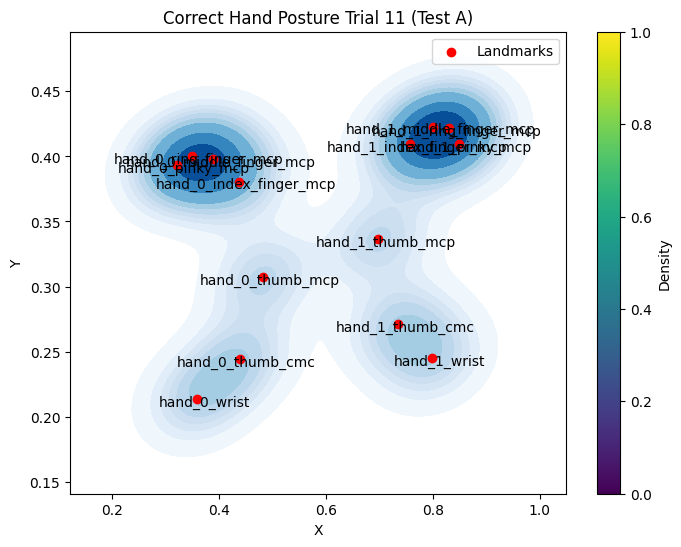

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 11 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


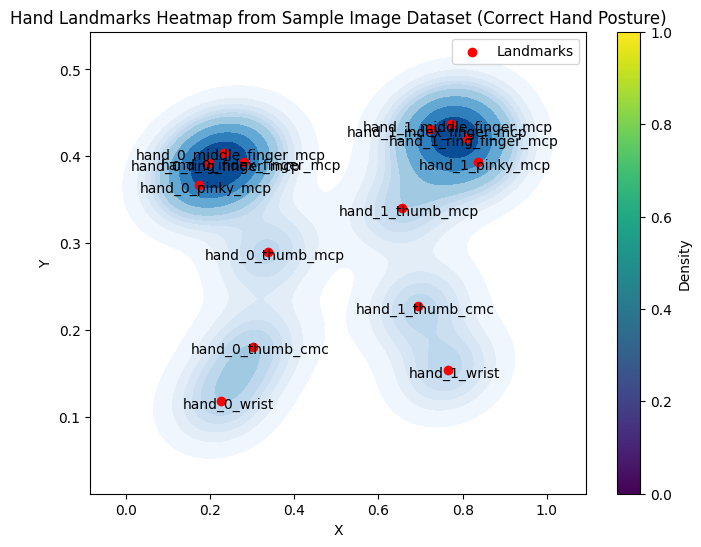

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 11 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct11.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.358372,0.213754,2.714331e-07,0
1,hand_0_thumb_cmc,0.438050,0.244029,2.751716e-05,0
2,hand_0_thumb_mcp,0.481972,0.307348,-7.892430e-03,0
3,hand_0_index_finger_mcp,0.437425,0.380660,-6.974359e-02,0
4,hand_0_middle_finger_mcp,0.388746,0.397957,-6.244495e-02,0
5,hand_0_ring_finger_mcp,0.348846,0.400298,-4.827904e-02,0
6,hand_0_pinky_mcp,0.320415,0.393405,-3.065090e-02,0
7,hand_1_wrist,0.798656,0.245026,5.799920e-07,1
8,hand_1_thumb_cmc,0.734724,0.271287,-2.635155e-02,1
9,hand_1_thumb_mcp,0.697886,0.336311,-4.241215e-02,1


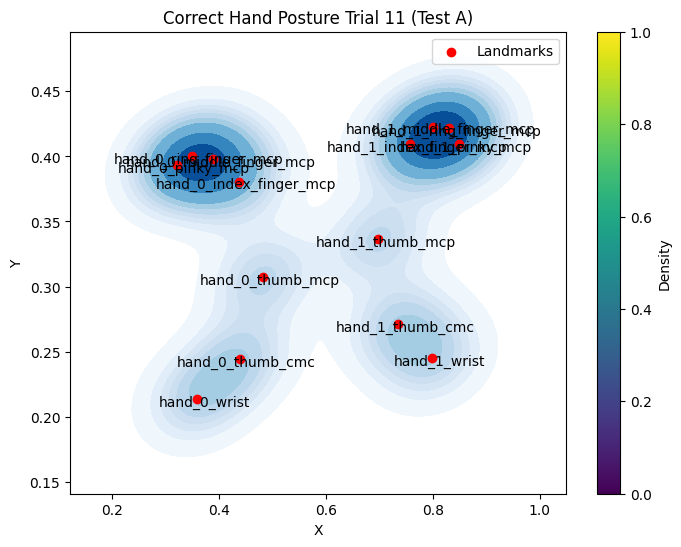

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 11 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 6.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.250876,0.097428,1.008285e-07,0
1,hand_0_thumb_cmc,0.327777,0.164733,1.241971e-03,0
2,hand_0_thumb_mcp,0.362911,0.281288,9.133638e-05,0
3,hand_0_index_finger_mcp,0.311017,0.388801,-2.775881e-02,0
4,hand_0_middle_finger_mcp,0.260660,0.399723,-2.504707e-02,0
5,hand_0_ring_finger_mcp,0.222437,0.385699,-1.912617e-02,0
6,hand_0_pinky_mcp,0.196192,0.356605,-1.137228e-02,0
7,hand_1_wrist,0.750813,0.154380,5.784949e-07,1
8,hand_1_thumb_cmc,0.679754,0.219933,-1.780822e-02,1
9,hand_1_thumb_mcp,0.639410,0.328366,-2.976600e-02,1


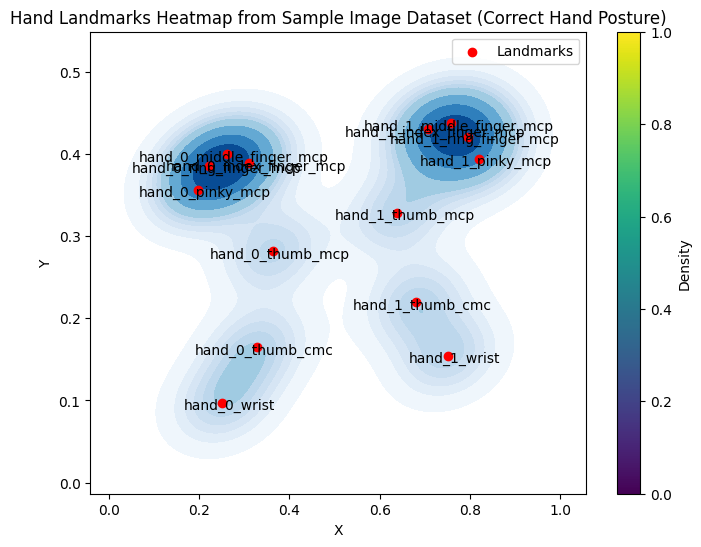

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct11.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.358372,0.213754,2.714331e-07,0
1,hand_0_thumb_cmc,0.438050,0.244029,2.751716e-05,0
2,hand_0_thumb_mcp,0.481972,0.307348,-7.892430e-03,0
3,hand_0_index_finger_mcp,0.437425,0.380660,-6.974359e-02,0
4,hand_0_middle_finger_mcp,0.388746,0.397957,-6.244495e-02,0
5,hand_0_ring_finger_mcp,0.348846,0.400298,-4.827904e-02,0
6,hand_0_pinky_mcp,0.320415,0.393405,-3.065090e-02,0
7,hand_1_wrist,0.798656,0.245026,5.799920e-07,1
8,hand_1_thumb_cmc,0.734724,0.271287,-2.635155e-02,1
9,hand_1_thumb_mcp,0.697886,0.336311,-4.241215e-02,1


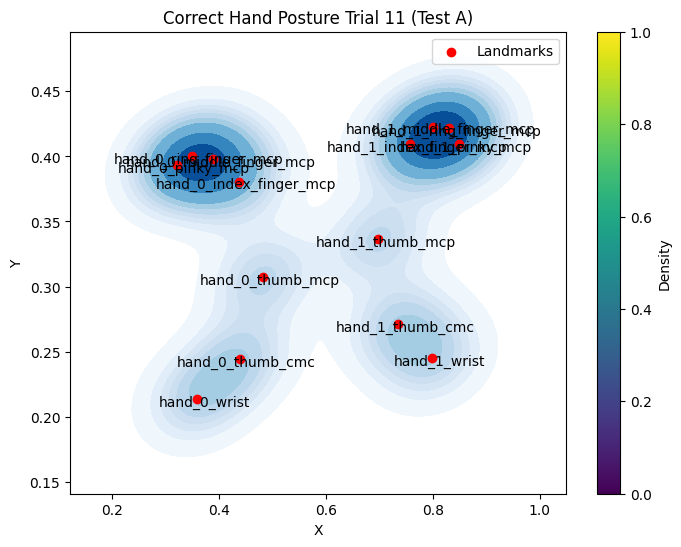

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 11 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


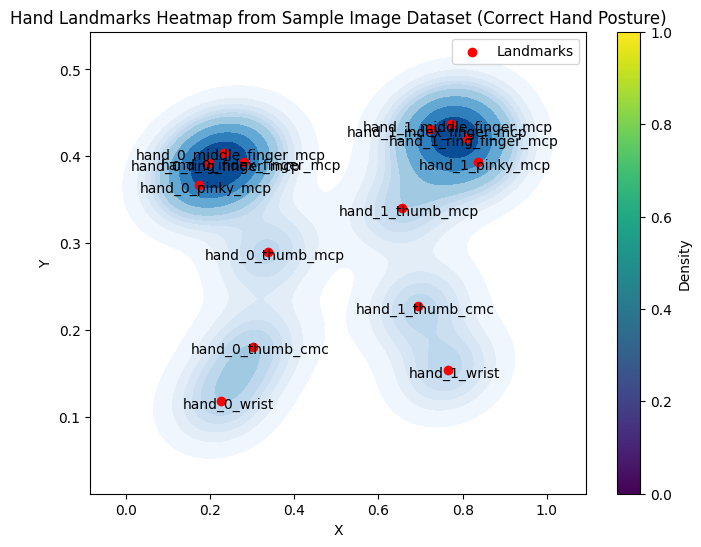

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 12 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct12.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.362869,0.211172,2.803989e-07,0
1,hand_0_thumb_cmc,0.441603,0.240204,-1.957807e-03,0
2,hand_0_thumb_mcp,0.484080,0.307336,-9.233776e-03,0
3,hand_0_index_finger_mcp,0.439313,0.379089,-5.852498e-02,0
4,hand_0_middle_finger_mcp,0.390092,0.393386,-5.318151e-02,0
5,hand_0_ring_finger_mcp,0.350334,0.394471,-4.239019e-02,0
6,hand_0_pinky_mcp,0.321690,0.385618,-2.902364e-02,0
7,hand_1_wrist,0.793271,0.237437,5.936764e-07,1
8,hand_1_thumb_cmc,0.729441,0.272052,-2.724522e-02,1
9,hand_1_thumb_mcp,0.695439,0.342094,-4.333071e-02,1


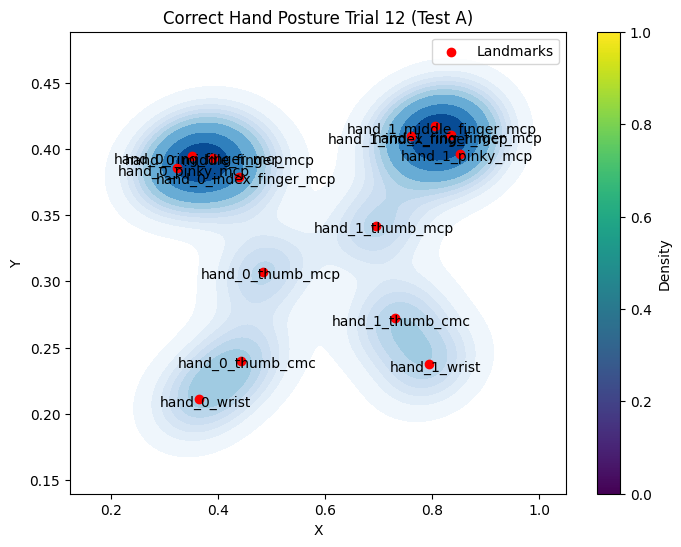

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 12 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 13.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.341721,0.113044,1.413056e-07,0
1,hand_0_thumb_cmc,0.418996,0.168238,-3.679608e-03,0
2,hand_0_thumb_mcp,0.464903,0.267003,-9.070669e-03,0
3,hand_0_index_finger_mcp,0.410723,0.377213,-4.456675e-02,0
4,hand_0_middle_finger_mcp,0.361299,0.400644,-3.641523e-02,0
5,hand_0_ring_finger_mcp,0.324645,0.397820,-2.368197e-02,0
6,hand_0_pinky_mcp,0.301585,0.378331,-8.320065e-03,0
7,hand_1_wrist,0.783065,0.202757,4.553939e-07,1
8,hand_1_thumb_cmc,0.714553,0.265826,-1.314383e-02,1
9,hand_1_thumb_mcp,0.672273,0.373522,-2.174066e-02,1


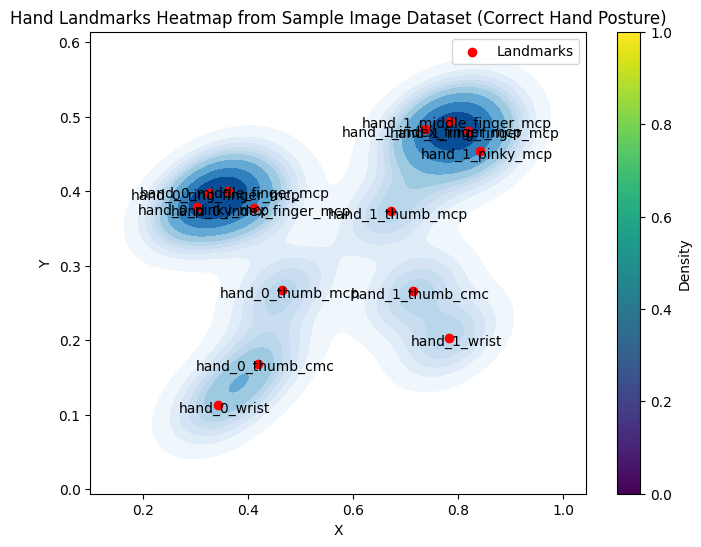

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 13 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct13.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.371728,0.179692,2.882331e-07,0
1,hand_0_thumb_cmc,0.448876,0.201131,-1.427782e-03,0
2,hand_0_thumb_mcp,0.489588,0.267442,-9.228322e-03,0
3,hand_0_index_finger_mcp,0.451956,0.329939,-6.369145e-02,0
4,hand_0_middle_finger_mcp,0.402451,0.346470,-6.151992e-02,0
5,hand_0_ring_finger_mcp,0.361194,0.351387,-5.382065e-02,0
6,hand_0_pinky_mcp,0.330022,0.343898,-4.333612e-02,0
7,hand_1_wrist,0.787817,0.244655,6.717041e-07,1
8,hand_1_thumb_cmc,0.724588,0.278309,-2.597358e-02,1
9,hand_1_thumb_mcp,0.688483,0.346537,-4.127526e-02,1


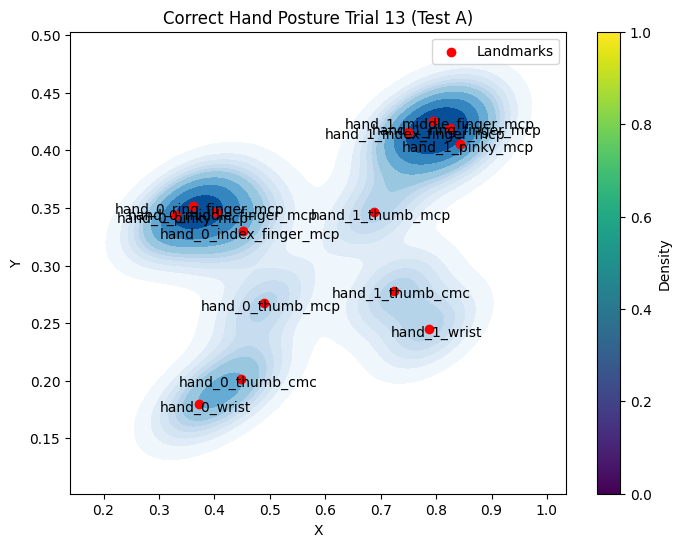

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 13 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 14.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.343708,0.119945,2.008130e-07,0
1,hand_0_thumb_cmc,0.421927,0.169031,-6.562448e-03,0
2,hand_0_thumb_mcp,0.469138,0.263016,-1.310606e-02,0
3,hand_0_index_finger_mcp,0.410802,0.391883,-4.198839e-02,0
4,hand_0_middle_finger_mcp,0.359277,0.408909,-3.342925e-02,0
5,hand_0_ring_finger_mcp,0.321147,0.401557,-2.111211e-02,0
6,hand_0_pinky_mcp,0.296923,0.378460,-6.786772e-03,0
7,hand_1_wrist,0.766559,0.189841,4.577249e-07,1
8,hand_1_thumb_cmc,0.695552,0.252979,-1.045996e-02,1
9,hand_1_thumb_mcp,0.652741,0.359995,-2.008657e-02,1


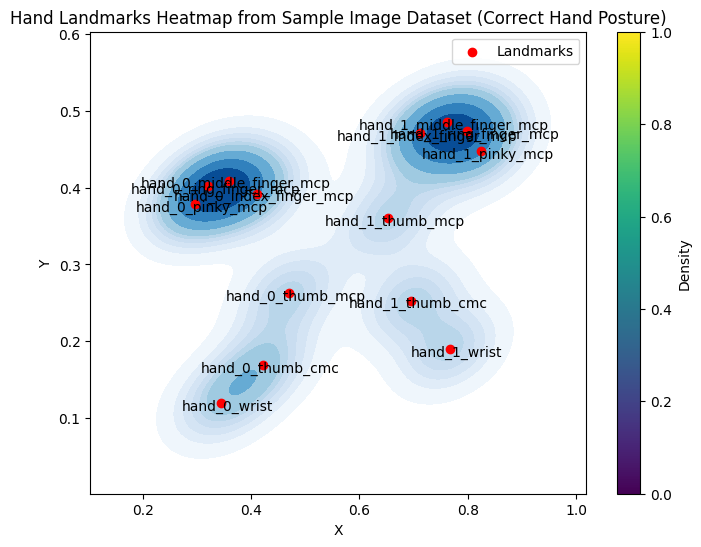

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 14 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct14.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305996,0.205404,2.207244e-07,0
1,hand_0_thumb_cmc,0.380291,0.244765,-3.953775e-03,0
2,hand_0_thumb_mcp,0.418202,0.315394,-1.268045e-02,0
3,hand_0_index_finger_mcp,0.364990,0.379573,-6.529036e-02,0
4,hand_0_middle_finger_mcp,0.316220,0.389572,-5.613788e-02,0
5,hand_0_ring_finger_mcp,0.278049,0.384700,-4.227658e-02,0
6,hand_0_pinky_mcp,0.252824,0.372307,-2.584428e-02,0
7,hand_1_wrist,0.814073,0.220365,6.108009e-07,1
8,hand_1_thumb_cmc,0.749821,0.254583,-2.772048e-02,1
9,hand_1_thumb_mcp,0.712463,0.324259,-4.665778e-02,1


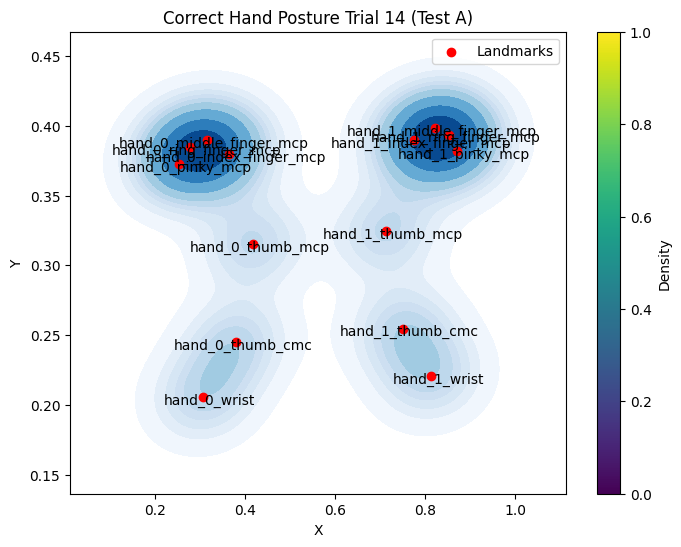

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 14 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct2.png'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.316591,0.233847,2.752325e-07,0
1,hand_0_thumb_cmc,0.393854,0.278010,-1.691835e-03,0
2,hand_0_thumb_mcp,0.429200,0.347317,-8.412882e-03,0
3,hand_0_index_finger_mcp,0.380178,0.417843,-6.587825e-02,0
4,hand_0_middle_finger_mcp,0.332038,0.429602,-5.381587e-02,0
5,hand_0_ring_finger_mcp,0.294896,0.425284,-3.456515e-02,0
6,hand_0_pinky_mcp,0.270870,0.414767,-1.183025e-02,0
7,hand_1_wrist,0.833754,0.241919,5.940203e-07,1
8,hand_1_thumb_cmc,0.770606,0.269505,-2.444833e-02,1
9,hand_1_thumb_mcp,0.732368,0.335899,-3.847456e-02,1


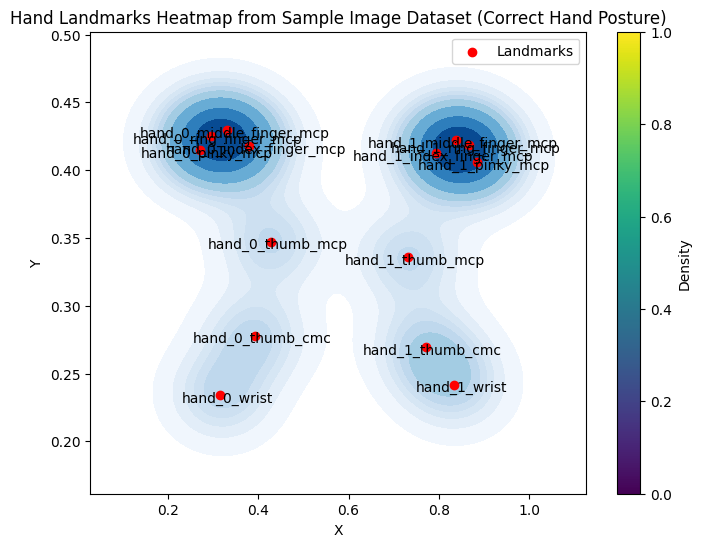

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 15 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct15.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.351799,0.224725,2.048207e-07,0
1,hand_0_thumb_cmc,0.429249,0.256127,-1.822243e-03,0
2,hand_0_thumb_mcp,0.470510,0.323336,-8.505917e-03,0
3,hand_0_index_finger_mcp,0.424953,0.392886,-6.211663e-02,0
4,hand_0_middle_finger_mcp,0.375481,0.406617,-5.739534e-02,0
5,hand_0_ring_finger_mcp,0.335244,0.406575,-4.713057e-02,0
6,hand_0_pinky_mcp,0.306254,0.396046,-3.436953e-02,0
7,hand_1_wrist,0.784517,0.226933,6.463044e-07,1
8,hand_1_thumb_cmc,0.722830,0.263704,-2.695409e-02,1
9,hand_1_thumb_mcp,0.684086,0.332416,-4.541296e-02,1


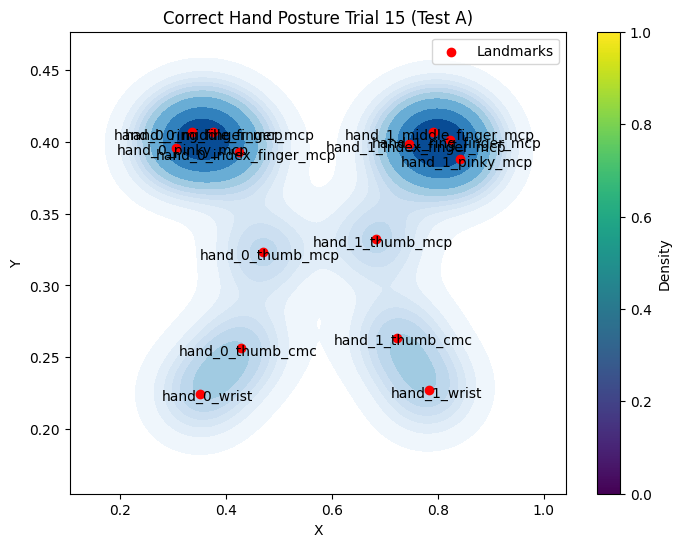

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 15 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct2.png'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.316591,0.233847,2.752325e-07,0
1,hand_0_thumb_cmc,0.393854,0.278010,-1.691835e-03,0
2,hand_0_thumb_mcp,0.429200,0.347317,-8.412882e-03,0
3,hand_0_index_finger_mcp,0.380178,0.417843,-6.587825e-02,0
4,hand_0_middle_finger_mcp,0.332038,0.429602,-5.381587e-02,0
5,hand_0_ring_finger_mcp,0.294896,0.425284,-3.456515e-02,0
6,hand_0_pinky_mcp,0.270870,0.414767,-1.183025e-02,0
7,hand_1_wrist,0.833754,0.241919,5.940203e-07,1
8,hand_1_thumb_cmc,0.770606,0.269505,-2.444833e-02,1
9,hand_1_thumb_mcp,0.732368,0.335899,-3.847456e-02,1


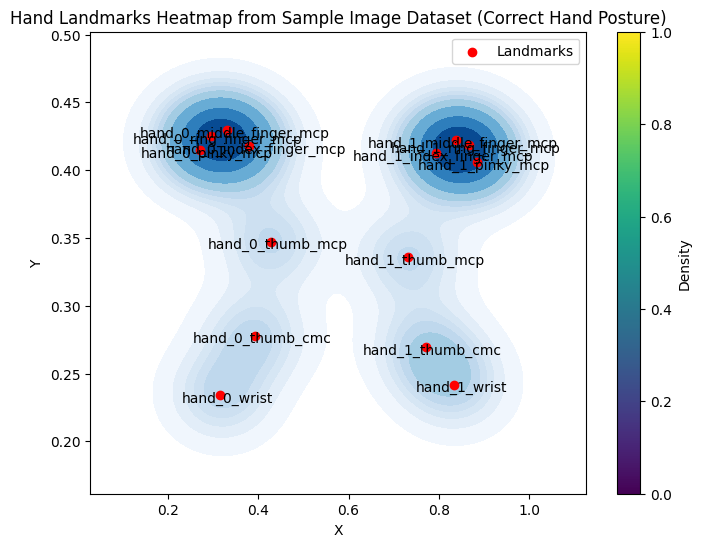

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 16 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct16.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.396119,0.239557,3.526712e-07,0
1,hand_0_thumb_cmc,0.477287,0.272528,4.358979e-03,0
2,hand_0_thumb_mcp,0.516945,0.341249,-1.749182e-03,0
3,hand_0_index_finger_mcp,0.478370,0.419042,-6.379632e-02,0
4,hand_0_middle_finger_mcp,0.428740,0.433955,-5.757717e-02,0
5,hand_0_ring_finger_mcp,0.386906,0.433343,-4.495473e-02,0
6,hand_0_pinky_mcp,0.357063,0.424564,-2.883516e-02,0
7,hand_1_wrist,0.771516,0.218445,6.111287e-07,1
8,hand_1_thumb_cmc,0.707139,0.251752,-2.683742e-02,1
9,hand_1_thumb_mcp,0.672940,0.323814,-4.235943e-02,1


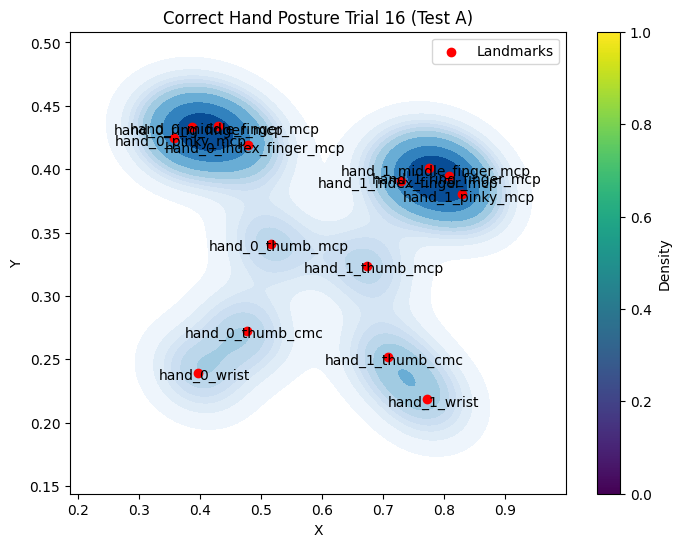

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 16 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 16.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.295985,0.129571,2.013517e-07,0
1,hand_0_thumb_cmc,0.374259,0.194417,-2.262693e-03,0
2,hand_0_thumb_mcp,0.414421,0.300757,-6.041792e-03,0
3,hand_0_index_finger_mcp,0.356186,0.416398,-4.125503e-02,0
4,hand_0_middle_finger_mcp,0.302666,0.429047,-3.552700e-02,0
5,hand_0_ring_finger_mcp,0.260224,0.416614,-2.574863e-02,0
6,hand_0_pinky_mcp,0.231630,0.385447,-1.450000e-02,0
7,hand_1_wrist,0.738034,0.105688,6.457886e-07,1
8,hand_1_thumb_cmc,0.665013,0.159509,-1.600584e-02,1
9,hand_1_thumb_mcp,0.621245,0.261902,-2.810695e-02,1


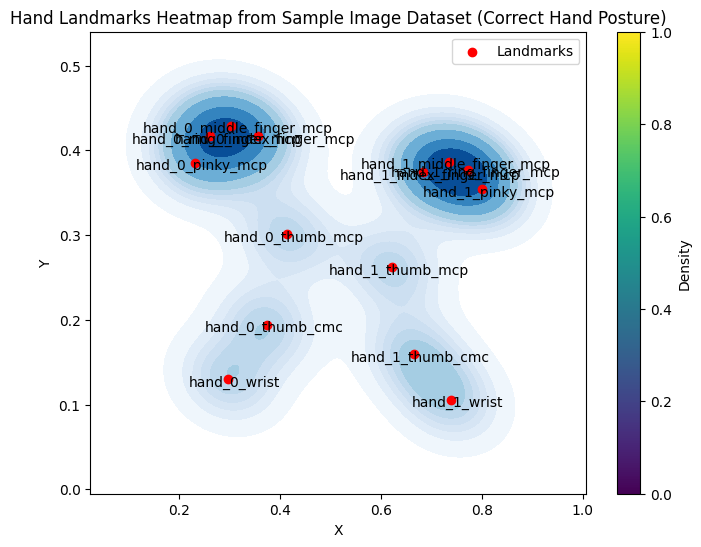

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 17 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct17.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305996,0.205404,2.207244e-07,0
1,hand_0_thumb_cmc,0.380291,0.244765,-3.953775e-03,0
2,hand_0_thumb_mcp,0.418202,0.315394,-1.268045e-02,0
3,hand_0_index_finger_mcp,0.364990,0.379573,-6.529036e-02,0
4,hand_0_middle_finger_mcp,0.316220,0.389572,-5.613788e-02,0
5,hand_0_ring_finger_mcp,0.278049,0.384700,-4.227658e-02,0
6,hand_0_pinky_mcp,0.252824,0.372307,-2.584428e-02,0
7,hand_1_wrist,0.814073,0.220365,6.108009e-07,1
8,hand_1_thumb_cmc,0.749821,0.254583,-2.772048e-02,1
9,hand_1_thumb_mcp,0.712463,0.324259,-4.665778e-02,1


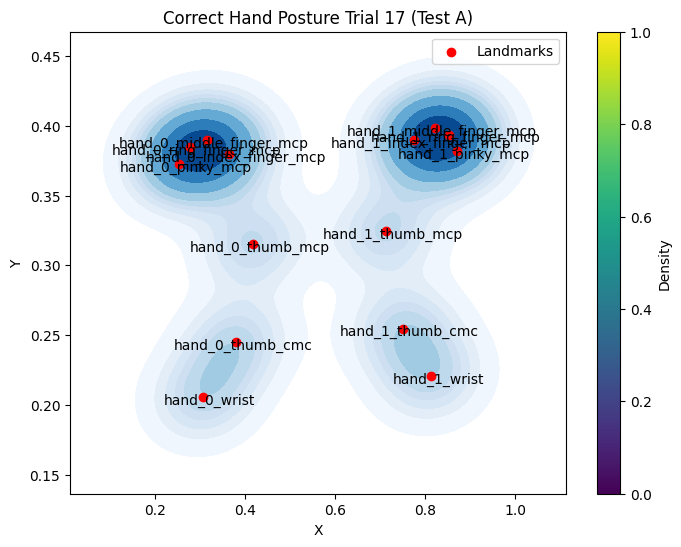

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 17 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 17.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.298271,0.089485,2.516909e-07,0
1,hand_0_thumb_cmc,0.379108,0.137379,-7.565589e-03,0
2,hand_0_thumb_mcp,0.431151,0.226633,-1.586997e-02,0
3,hand_0_index_finger_mcp,0.372071,0.363515,-5.239394e-02,0
4,hand_0_middle_finger_mcp,0.318684,0.386110,-4.025481e-02,0
5,hand_0_ring_finger_mcp,0.278776,0.380431,-2.382760e-02,0
6,hand_0_pinky_mcp,0.253531,0.358880,-5.114521e-03,0
7,hand_1_wrist,0.729984,0.073989,6.297112e-07,1
8,hand_1_thumb_cmc,0.657177,0.132538,-1.784736e-02,1
9,hand_1_thumb_mcp,0.616648,0.237524,-2.979885e-02,1


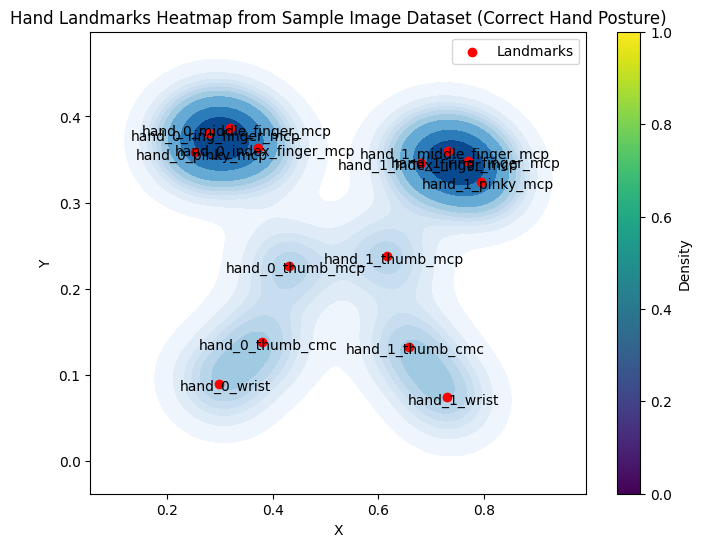

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 18 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct18.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.351799,0.224725,2.048207e-07,0
1,hand_0_thumb_cmc,0.429249,0.256127,-1.822243e-03,0
2,hand_0_thumb_mcp,0.470510,0.323336,-8.505917e-03,0
3,hand_0_index_finger_mcp,0.424953,0.392886,-6.211663e-02,0
4,hand_0_middle_finger_mcp,0.375481,0.406617,-5.739534e-02,0
5,hand_0_ring_finger_mcp,0.335244,0.406575,-4.713057e-02,0
6,hand_0_pinky_mcp,0.306254,0.396046,-3.436953e-02,0
7,hand_1_wrist,0.784517,0.226933,6.463044e-07,1
8,hand_1_thumb_cmc,0.722830,0.263704,-2.695409e-02,1
9,hand_1_thumb_mcp,0.684086,0.332416,-4.541296e-02,1


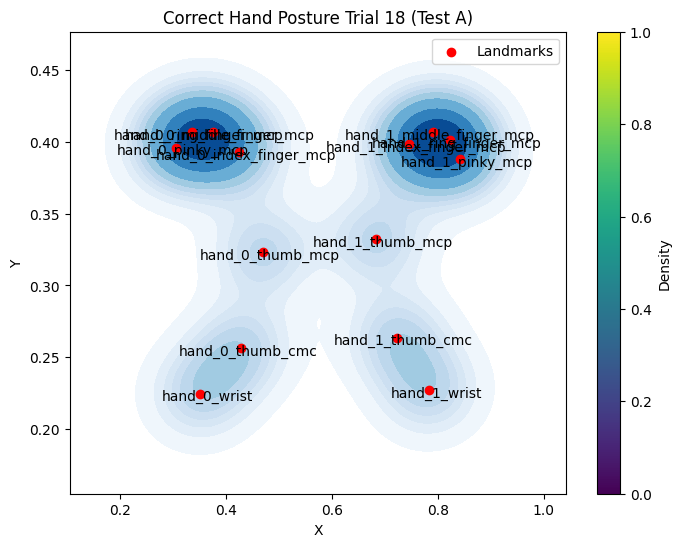

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 18 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct2.png'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.316591,0.233847,2.752325e-07,0
1,hand_0_thumb_cmc,0.393854,0.278010,-1.691835e-03,0
2,hand_0_thumb_mcp,0.429200,0.347317,-8.412882e-03,0
3,hand_0_index_finger_mcp,0.380178,0.417843,-6.587825e-02,0
4,hand_0_middle_finger_mcp,0.332038,0.429602,-5.381587e-02,0
5,hand_0_ring_finger_mcp,0.294896,0.425284,-3.456515e-02,0
6,hand_0_pinky_mcp,0.270870,0.414767,-1.183025e-02,0
7,hand_1_wrist,0.833754,0.241919,5.940203e-07,1
8,hand_1_thumb_cmc,0.770606,0.269505,-2.444833e-02,1
9,hand_1_thumb_mcp,0.732368,0.335899,-3.847456e-02,1


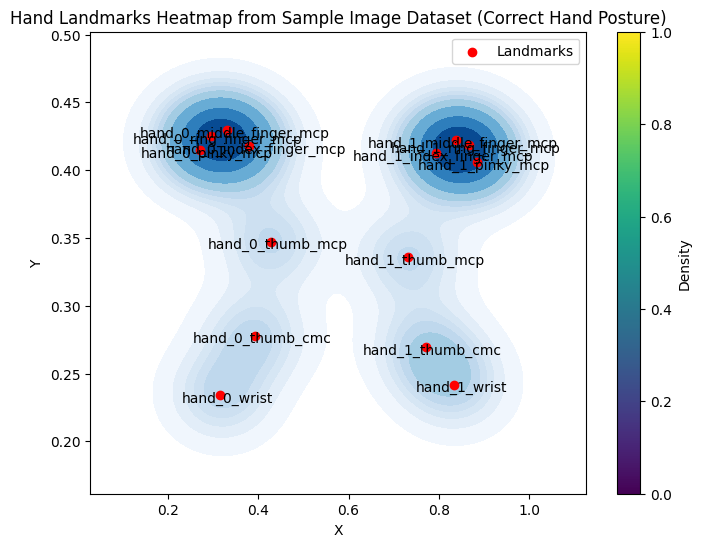

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 19 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct19.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.351799,0.224725,2.048207e-07,0
1,hand_0_thumb_cmc,0.429249,0.256127,-1.822243e-03,0
2,hand_0_thumb_mcp,0.470510,0.323336,-8.505917e-03,0
3,hand_0_index_finger_mcp,0.424953,0.392886,-6.211663e-02,0
4,hand_0_middle_finger_mcp,0.375481,0.406617,-5.739534e-02,0
5,hand_0_ring_finger_mcp,0.335244,0.406575,-4.713057e-02,0
6,hand_0_pinky_mcp,0.306254,0.396046,-3.436953e-02,0
7,hand_1_wrist,0.784517,0.226933,6.463044e-07,1
8,hand_1_thumb_cmc,0.722830,0.263704,-2.695409e-02,1
9,hand_1_thumb_mcp,0.684086,0.332416,-4.541296e-02,1


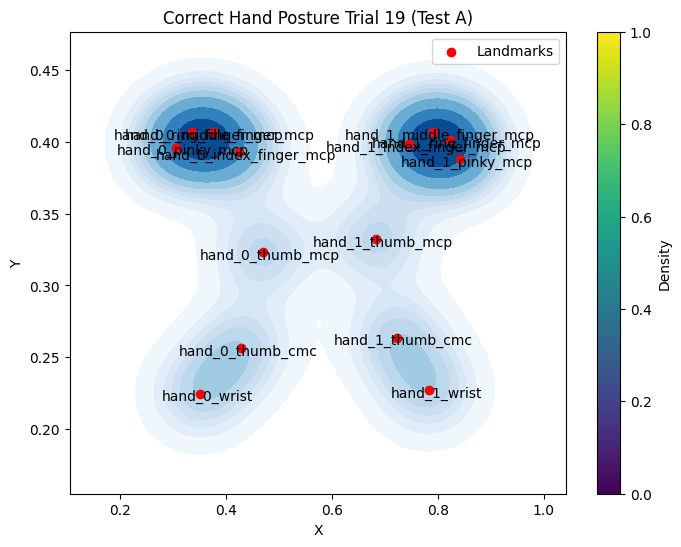

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 19 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 28.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.256269,0.144378,1.320311e-07,0
1,hand_0_thumb_cmc,0.332304,0.181236,-9.003459e-03,0
2,hand_0_thumb_mcp,0.378866,0.267467,-1.797547e-02,0
3,hand_0_index_finger_mcp,0.324853,0.387706,-4.694020e-02,0
4,hand_0_middle_finger_mcp,0.274067,0.408080,-4.038484e-02,0
5,hand_0_ring_finger_mcp,0.236324,0.404265,-3.097400e-02,0
6,hand_0_pinky_mcp,0.210745,0.383183,-2.007485e-02,0
7,hand_1_wrist,0.640638,0.182842,4.171847e-07,1
8,hand_1_thumb_cmc,0.570550,0.250681,-1.111424e-02,1
9,hand_1_thumb_mcp,0.530459,0.360087,-1.869328e-02,1


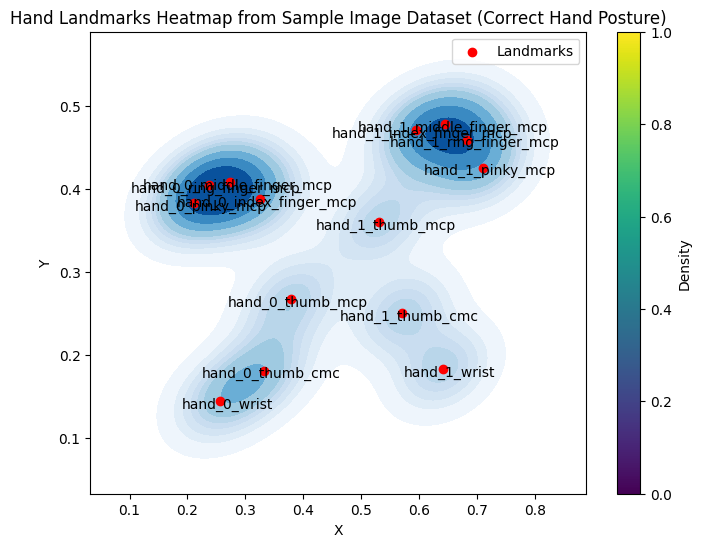

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 20 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct20.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.351799,0.224725,2.048207e-07,0
1,hand_0_thumb_cmc,0.429249,0.256127,-1.822243e-03,0
2,hand_0_thumb_mcp,0.470510,0.323336,-8.505917e-03,0
3,hand_0_index_finger_mcp,0.424953,0.392886,-6.211663e-02,0
4,hand_0_middle_finger_mcp,0.375481,0.406617,-5.739534e-02,0
5,hand_0_ring_finger_mcp,0.335244,0.406575,-4.713057e-02,0
6,hand_0_pinky_mcp,0.306254,0.396046,-3.436953e-02,0
7,hand_1_wrist,0.784517,0.226933,6.463044e-07,1
8,hand_1_thumb_cmc,0.722830,0.263704,-2.695409e-02,1
9,hand_1_thumb_mcp,0.684086,0.332416,-4.541296e-02,1


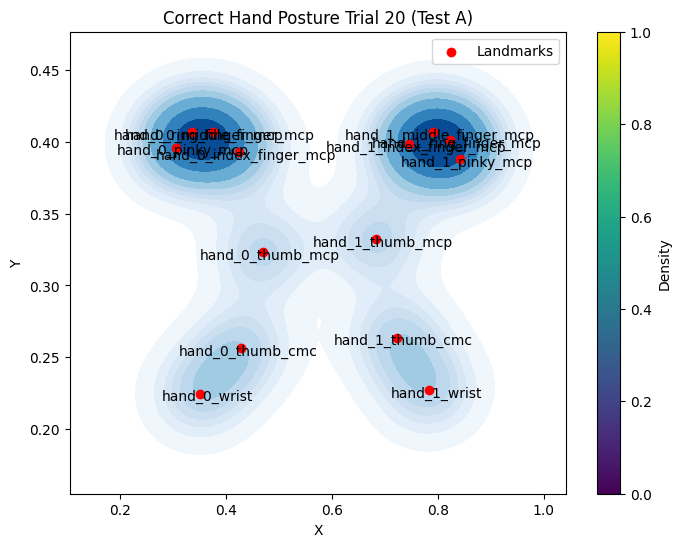

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 20 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 20.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.714006,0.184348,5.197655e-07,0
1,hand_0_thumb_cmc,0.643414,0.242926,-1.241004e-02,0
2,hand_0_thumb_mcp,0.601211,0.347554,-2.119916e-02,0
3,hand_0_index_finger_mcp,0.665288,0.458699,-3.944456e-02,0
4,hand_0_middle_finger_mcp,0.714592,0.468270,-3.212771e-02,0
5,hand_0_ring_finger_mcp,0.750520,0.453214,-2.377587e-02,0
6,hand_0_pinky_mcp,0.775190,0.423101,-1.564803e-02,0
7,hand_1_wrist,0.256386,0.197517,1.663793e-07,1
8,hand_1_thumb_cmc,0.331639,0.248840,-6.237168e-03,1
9,hand_1_thumb_mcp,0.378676,0.343651,-1.226448e-02,1


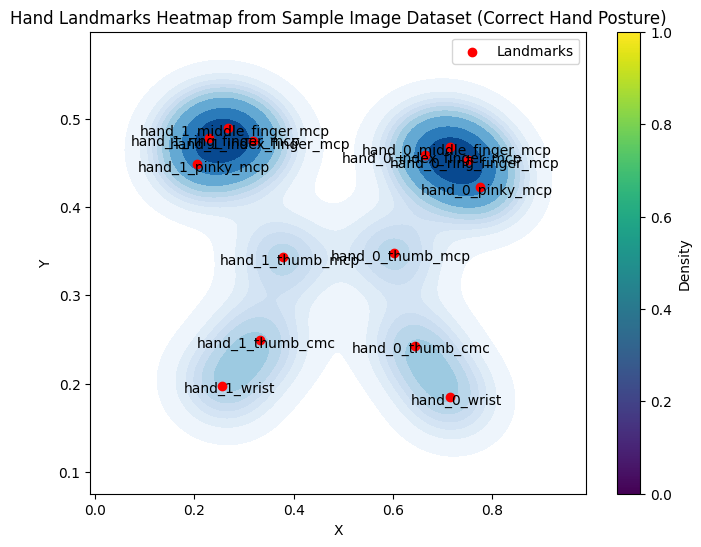

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 21 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct21.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.395169,0.240962,2.407376e-07,0
1,hand_0_thumb_cmc,0.475608,0.276661,4.773266e-03,0
2,hand_0_thumb_mcp,0.516384,0.348134,2.580087e-03,0
3,hand_0_index_finger_mcp,0.476326,0.429567,-5.539624e-02,0
4,hand_0_middle_finger_mcp,0.424180,0.441722,-5.183114e-02,0
5,hand_0_ring_finger_mcp,0.380460,0.438257,-4.258358e-02,0
6,hand_0_pinky_mcp,0.348921,0.424656,-3.024594e-02,0
7,hand_1_wrist,0.780008,0.238773,6.510315e-07,1
8,hand_1_thumb_cmc,0.714438,0.272596,-2.508833e-02,1
9,hand_1_thumb_mcp,0.673959,0.336091,-4.255660e-02,1


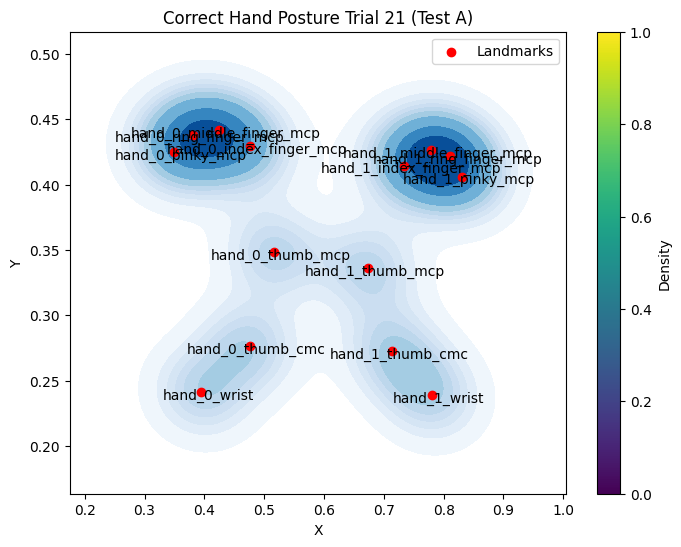

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 21 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 21.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.268631,0.145641,2.076986e-07,0
1,hand_0_thumb_cmc,0.344453,0.187076,-1.220561e-02,0
2,hand_0_thumb_mcp,0.394678,0.275423,-1.916789e-02,0
3,hand_0_index_finger_mcp,0.341806,0.411449,-4.512191e-02,0
4,hand_0_middle_finger_mcp,0.292339,0.435508,-3.136138e-02,0
5,hand_0_ring_finger_mcp,0.256629,0.431996,-1.402766e-02,0
6,hand_0_pinky_mcp,0.234518,0.413593,4.991916e-03,0
7,hand_1_wrist,0.714047,0.130586,4.292368e-07,1
8,hand_1_thumb_cmc,0.639653,0.193370,-2.014430e-03,1
9,hand_1_thumb_mcp,0.595786,0.300581,-1.949756e-03,1


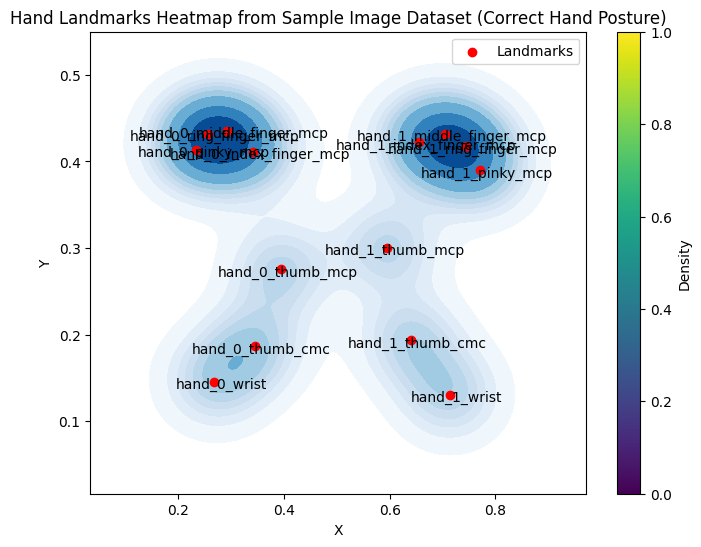

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 22 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct22.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.386023,0.201071,2.195150e-07,0
1,hand_0_thumb_cmc,0.466369,0.236639,5.250138e-03,0
2,hand_0_thumb_mcp,0.504317,0.310456,8.782627e-04,0
3,hand_0_index_finger_mcp,0.465455,0.375962,-6.730901e-02,0
4,hand_0_middle_finger_mcp,0.415122,0.387854,-6.370640e-02,0
5,hand_0_ring_finger_mcp,0.371867,0.386319,-5.328936e-02,0
6,hand_0_pinky_mcp,0.339459,0.374302,-3.961527e-02,0
7,hand_1_wrist,0.792627,0.254353,5.766886e-07,1
8,hand_1_thumb_cmc,0.726353,0.282949,-2.052872e-02,1
9,hand_1_thumb_mcp,0.689722,0.354040,-3.203696e-02,1


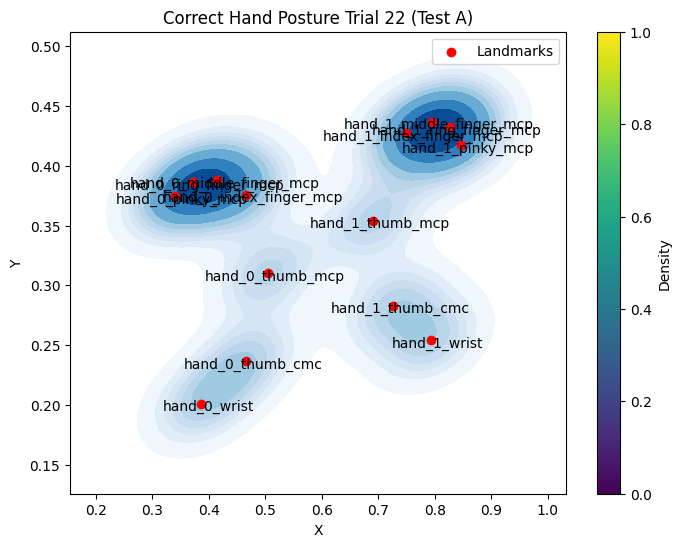

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 22 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 5.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.226619,0.118182,7.683690e-08,0
1,hand_0_thumb_cmc,0.302775,0.180913,-2.694490e-03,0
2,hand_0_thumb_mcp,0.336871,0.289435,-5.148747e-03,0
3,hand_0_index_finger_mcp,0.280167,0.393028,-3.469492e-02,0
4,hand_0_middle_finger_mcp,0.232490,0.404123,-2.874746e-02,0
5,hand_0_ring_finger_mcp,0.197213,0.392332,-1.920053e-02,0
6,hand_0_pinky_mcp,0.173326,0.367184,-8.702049e-03,0
7,hand_1_wrist,0.764489,0.154128,5.329345e-07,1
8,hand_1_thumb_cmc,0.693523,0.227845,-1.206474e-02,1
9,hand_1_thumb_mcp,0.655784,0.340357,-2.013108e-02,1


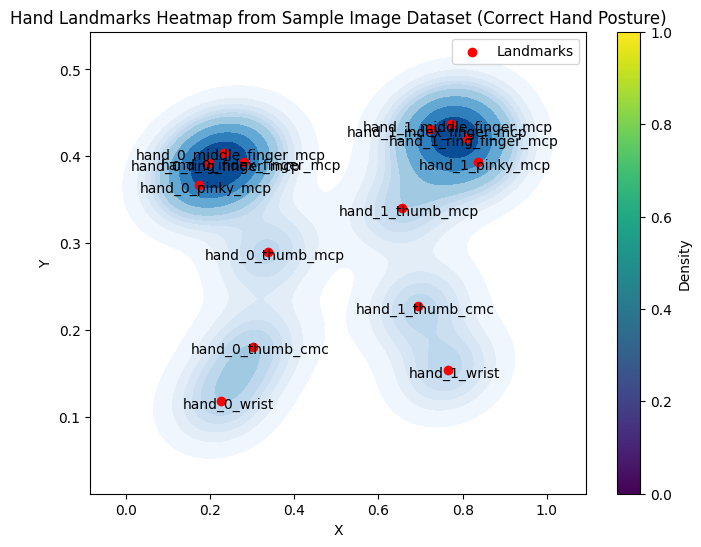

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 23 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct23.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.347688,0.251411,1.526226e-07,0
1,hand_0_thumb_cmc,0.423533,0.281866,-1.346002e-03,0
2,hand_0_thumb_mcp,0.465446,0.351627,-6.130685e-03,0
3,hand_0_index_finger_mcp,0.418890,0.425792,-3.766731e-02,0
4,hand_0_middle_finger_mcp,0.368253,0.437662,-3.532878e-02,0
5,hand_0_ring_finger_mcp,0.328676,0.434667,-3.002484e-02,0
6,hand_0_pinky_mcp,0.300534,0.420247,-2.291651e-02,0
7,hand_1_wrist,0.814876,0.234477,6.136608e-07,1
8,hand_1_thumb_cmc,0.750778,0.265151,-2.937347e-02,1
9,hand_1_thumb_mcp,0.713341,0.334878,-4.690471e-02,1


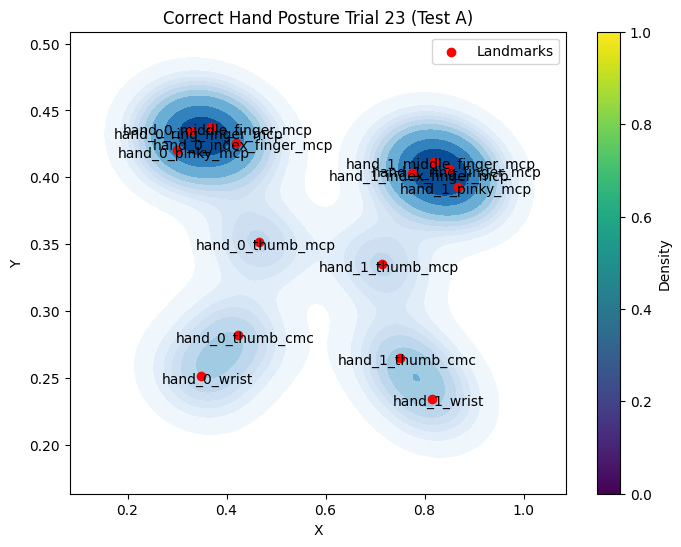

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 23 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 23.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.263165,0.142651,2.126874e-07,0
1,hand_0_thumb_cmc,0.340419,0.193568,-7.211033e-03,0
2,hand_0_thumb_mcp,0.390048,0.285806,-1.175622e-02,0
3,hand_0_index_finger_mcp,0.338968,0.418362,-3.708794e-02,0
4,hand_0_middle_finger_mcp,0.288988,0.439139,-2.672898e-02,0
5,hand_0_ring_finger_mcp,0.250366,0.432391,-1.302220e-02,0
6,hand_0_pinky_mcp,0.223756,0.409104,2.440988e-03,0
7,hand_1_wrist,0.699647,0.148554,4.752096e-07,1
8,hand_1_thumb_cmc,0.628376,0.206915,-6.985575e-03,1
9,hand_1_thumb_mcp,0.585120,0.309474,-1.262556e-02,1


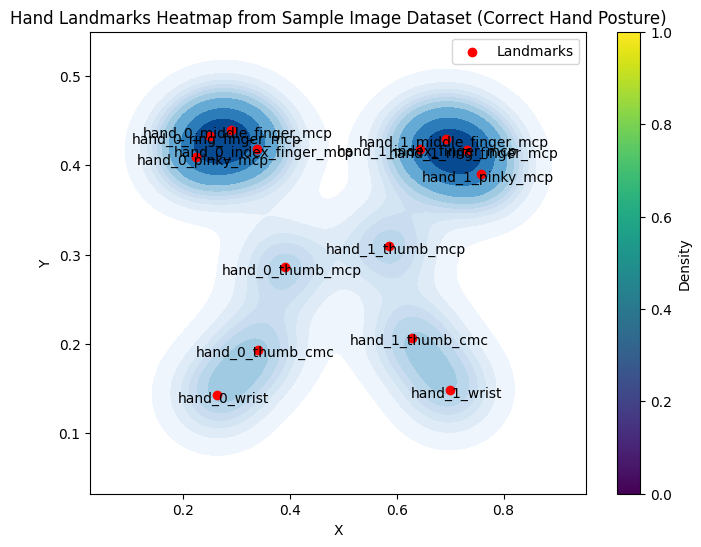

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 24 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct24.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.393182,0.244017,3.353725e-07,0
1,hand_0_thumb_cmc,0.471726,0.276419,1.093011e-03,0
2,hand_0_thumb_mcp,0.514184,0.342524,-8.279457e-03,0
3,hand_0_index_finger_mcp,0.473340,0.417994,-7.267666e-02,0
4,hand_0_middle_finger_mcp,0.422612,0.432733,-6.670142e-02,0
5,hand_0_ring_finger_mcp,0.379794,0.430536,-5.492612e-02,0
6,hand_0_pinky_mcp,0.348220,0.418857,-3.965137e-02,0
7,hand_1_wrist,0.774561,0.196303,7.311917e-07,1
8,hand_1_thumb_cmc,0.708512,0.223069,-3.116484e-02,1
9,hand_1_thumb_mcp,0.663787,0.281355,-5.312720e-02,1


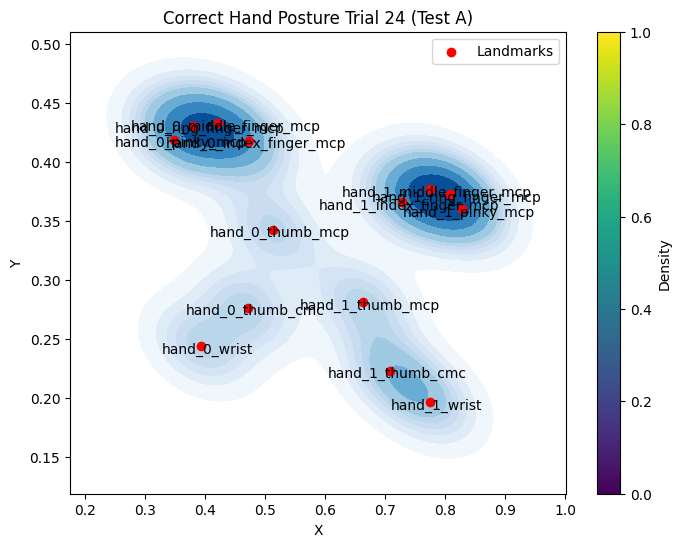

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 24 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 19.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.705595,0.116955,4.898138e-07,0
1,hand_0_thumb_cmc,0.634106,0.177852,-1.257064e-02,0
2,hand_0_thumb_mcp,0.590642,0.276011,-2.113556e-02,0
3,hand_0_index_finger_mcp,0.653789,0.390112,-3.493305e-02,0
4,hand_0_middle_finger_mcp,0.704388,0.399598,-2.791877e-02,0
5,hand_0_ring_finger_mcp,0.741779,0.385179,-1.999336e-02,0
6,hand_0_pinky_mcp,0.767697,0.358129,-1.257066e-02,0
7,hand_1_wrist,0.314757,0.225710,1.796426e-07,1
8,hand_1_thumb_cmc,0.391572,0.267815,-6.293367e-03,1
9,hand_1_thumb_mcp,0.438101,0.358568,-1.286772e-02,1


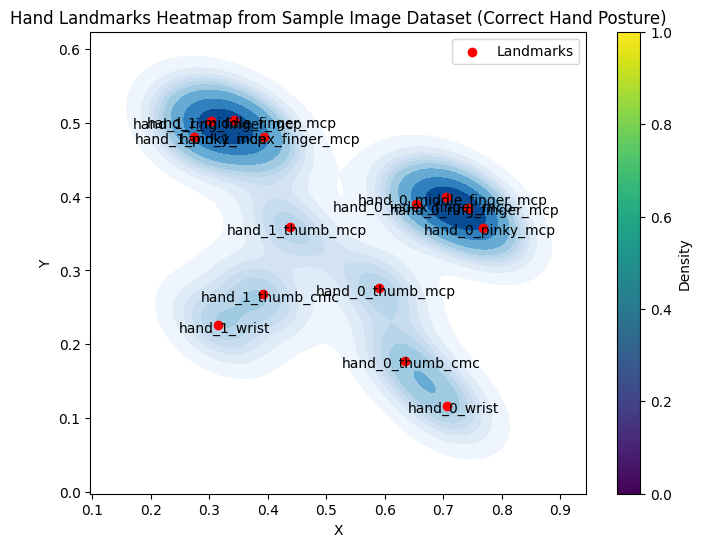

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 25 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct25.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.758318,0.221819,6.247833e-07,0
1,hand_0_thumb_cmc,0.690825,0.251202,-2.755005e-02,0
2,hand_0_thumb_mcp,0.653013,0.321233,-4.465221e-02,0
3,hand_0_index_finger_mcp,0.708729,0.392198,-7.212086e-02,0
4,hand_0_middle_finger_mcp,0.757844,0.402899,-5.720034e-02,0
5,hand_0_ring_finger_mcp,0.792612,0.398213,-4.063131e-02,0
6,hand_0_pinky_mcp,0.814070,0.386453,-2.486230e-02,0
7,hand_1_wrist,0.421447,0.191657,2.652368e-07,1
8,hand_1_thumb_cmc,0.500451,0.225465,-1.465061e-03,1
9,hand_1_thumb_mcp,0.538542,0.302467,-8.839436e-03,1


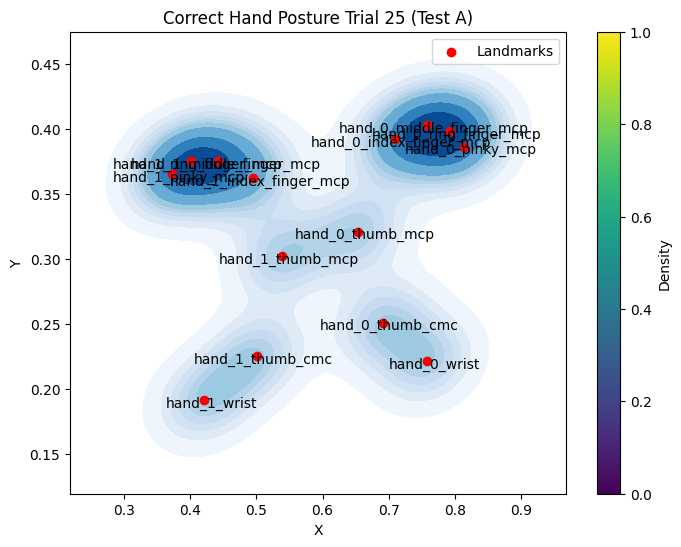

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 25 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 25.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.284986,0.062052,1.424631e-07,0
1,hand_0_thumb_cmc,0.360148,0.114791,-4.296422e-03,0
2,hand_0_thumb_mcp,0.405633,0.207913,-1.189297e-02,0
3,hand_0_index_finger_mcp,0.353871,0.320629,-4.474024e-02,0
4,hand_0_middle_finger_mcp,0.302442,0.338818,-3.938750e-02,0
5,hand_0_ring_finger_mcp,0.263300,0.334663,-3.012481e-02,0
6,hand_0_pinky_mcp,0.236207,0.312152,-1.892237e-02,0
7,hand_1_wrist,0.698927,0.148238,5.284319e-07,1
8,hand_1_thumb_cmc,0.627073,0.208775,-8.955491e-03,1
9,hand_1_thumb_mcp,0.584804,0.307038,-1.549287e-02,1


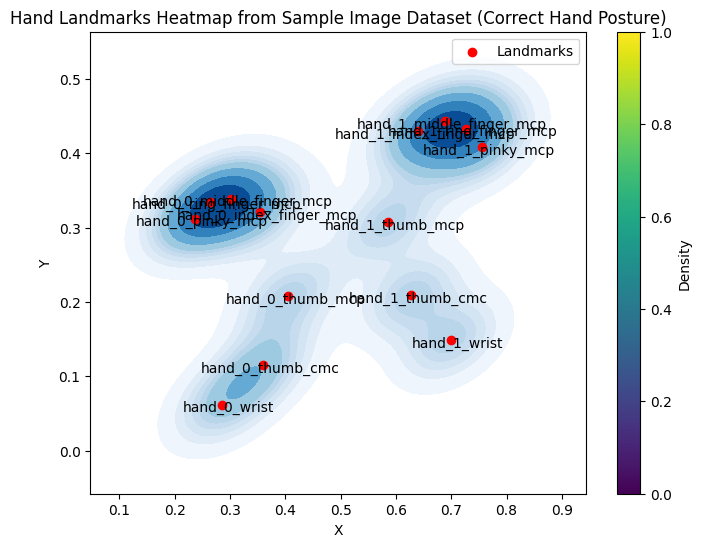

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 26 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct26.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.752601,0.264971,5.909147e-07,0
1,hand_0_thumb_cmc,0.682637,0.299850,-1.779686e-02,0
2,hand_0_thumb_mcp,0.646144,0.371258,-2.741111e-02,0
3,hand_0_index_finger_mcp,0.697933,0.446046,-5.031114e-02,0
4,hand_0_middle_finger_mcp,0.745642,0.457797,-3.969629e-02,0
5,hand_0_ring_finger_mcp,0.780130,0.451521,-2.759669e-02,0
6,hand_0_pinky_mcp,0.803931,0.435086,-1.569306e-02,0
7,hand_1_wrist,0.425683,0.197270,1.783165e-07,1
8,hand_1_thumb_cmc,0.504563,0.230557,4.462894e-03,1
9,hand_1_thumb_mcp,0.544131,0.302082,-1.040429e-03,1


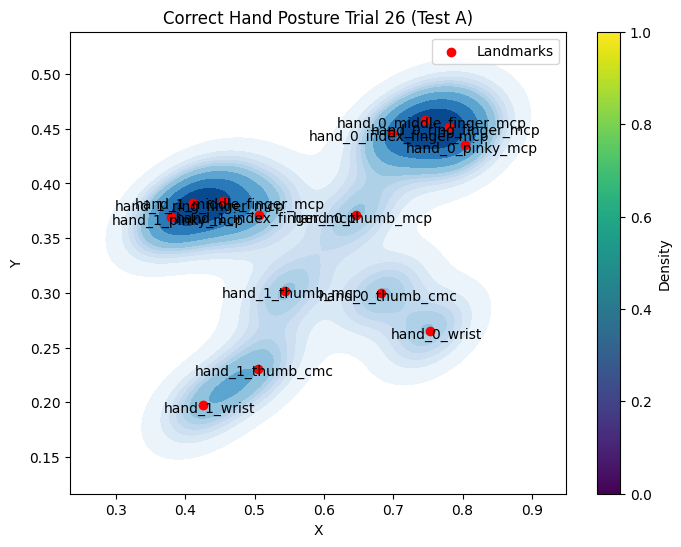

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 26 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct25.png'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.758318,0.221819,6.247833e-07,0
1,hand_0_thumb_cmc,0.690825,0.251202,-2.755005e-02,0
2,hand_0_thumb_mcp,0.653013,0.321233,-4.465221e-02,0
3,hand_0_index_finger_mcp,0.708729,0.392198,-7.212086e-02,0
4,hand_0_middle_finger_mcp,0.757844,0.402899,-5.720034e-02,0
5,hand_0_ring_finger_mcp,0.792612,0.398213,-4.063131e-02,0
6,hand_0_pinky_mcp,0.814070,0.386453,-2.486230e-02,0
7,hand_1_wrist,0.421447,0.191657,2.652368e-07,1
8,hand_1_thumb_cmc,0.500451,0.225465,-1.465061e-03,1
9,hand_1_thumb_mcp,0.538542,0.302467,-8.839436e-03,1


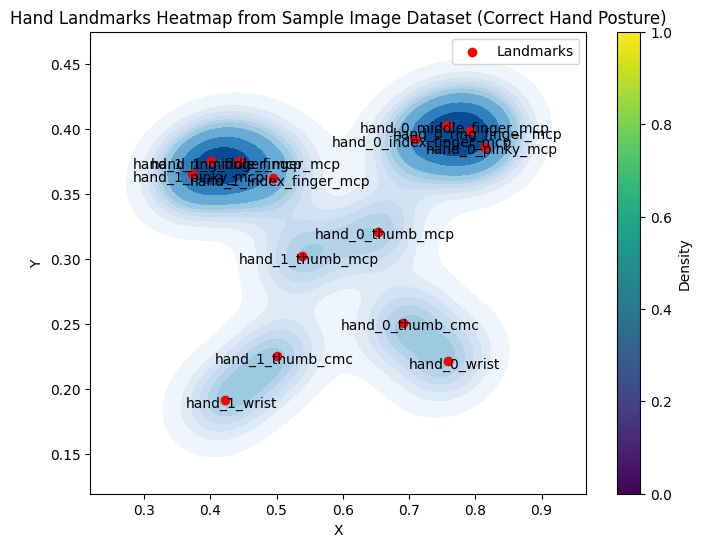

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 27 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct27.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.431918,0.200154,2.216447e-07,0
1,hand_0_thumb_cmc,0.512224,0.225077,1.876090e-03,0
2,hand_0_thumb_mcp,0.554337,0.293309,-2.865882e-03,0
3,hand_0_index_finger_mcp,0.520488,0.366887,-5.050448e-02,0
4,hand_0_middle_finger_mcp,0.469264,0.385181,-4.952187e-02,0
5,hand_0_ring_finger_mcp,0.426080,0.387761,-4.422808e-02,0
6,hand_0_pinky_mcp,0.393791,0.377752,-3.674114e-02,0
7,hand_1_wrist,0.753076,0.247714,5.849973e-07,1
8,hand_1_thumb_cmc,0.684329,0.279979,-2.276013e-02,1
9,hand_1_thumb_mcp,0.646452,0.348548,-3.618141e-02,1


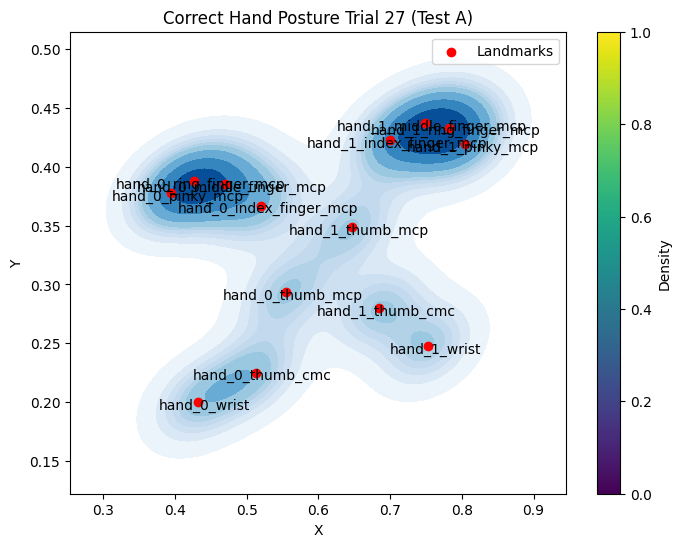

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 27 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct6.png'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305541,0.198368,2.154283e-07,0
1,hand_0_thumb_cmc,0.380151,0.252196,4.027098e-04,0
2,hand_0_thumb_mcp,0.418215,0.320821,-7.040887e-03,0
3,hand_0_index_finger_mcp,0.366692,0.386858,-7.473288e-02,0
4,hand_0_middle_finger_mcp,0.317436,0.394318,-6.214141e-02,0
5,hand_0_ring_finger_mcp,0.279494,0.388410,-4.135333e-02,0
6,hand_0_pinky_mcp,0.254360,0.375464,-1.636796e-02,0
7,hand_1_wrist,0.824603,0.225797,6.135598e-07,1
8,hand_1_thumb_cmc,0.764085,0.266082,-2.785635e-02,1
9,hand_1_thumb_mcp,0.730147,0.337281,-4.685477e-02,1


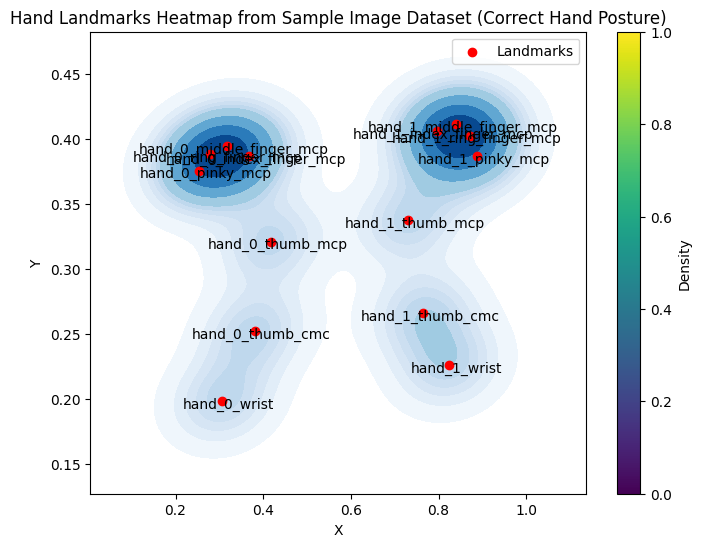

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 28 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct28.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.432833,0.204497,2.113857e-07,0
1,hand_0_thumb_cmc,0.514794,0.231039,4.605107e-03,0
2,hand_0_thumb_mcp,0.558291,0.297014,-1.191319e-03,0
3,hand_0_index_finger_mcp,0.523528,0.371722,-5.842399e-02,0
4,hand_0_middle_finger_mcp,0.472646,0.390028,-5.634952e-02,0
5,hand_0_ring_finger_mcp,0.429337,0.393471,-4.874742e-02,0
6,hand_0_pinky_mcp,0.396660,0.384912,-3.840174e-02,0
7,hand_1_wrist,0.753324,0.247086,5.519357e-07,1
8,hand_1_thumb_cmc,0.684304,0.278440,-1.859473e-02,1
9,hand_1_thumb_mcp,0.646862,0.346319,-2.887520e-02,1


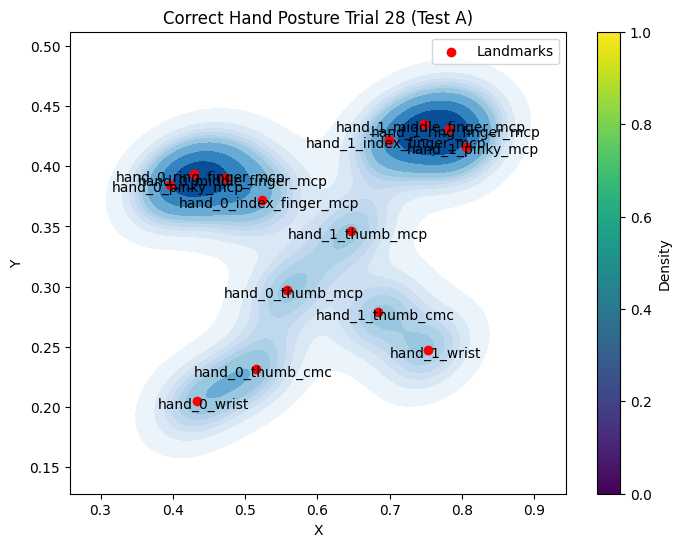

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 28 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 28.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.256269,0.144378,1.320311e-07,0
1,hand_0_thumb_cmc,0.332304,0.181236,-9.003459e-03,0
2,hand_0_thumb_mcp,0.378866,0.267467,-1.797547e-02,0
3,hand_0_index_finger_mcp,0.324853,0.387706,-4.694020e-02,0
4,hand_0_middle_finger_mcp,0.274067,0.408080,-4.038484e-02,0
5,hand_0_ring_finger_mcp,0.236324,0.404265,-3.097400e-02,0
6,hand_0_pinky_mcp,0.210745,0.383183,-2.007485e-02,0
7,hand_1_wrist,0.640638,0.182842,4.171847e-07,1
8,hand_1_thumb_cmc,0.570550,0.250681,-1.111424e-02,1
9,hand_1_thumb_mcp,0.530459,0.360087,-1.869328e-02,1


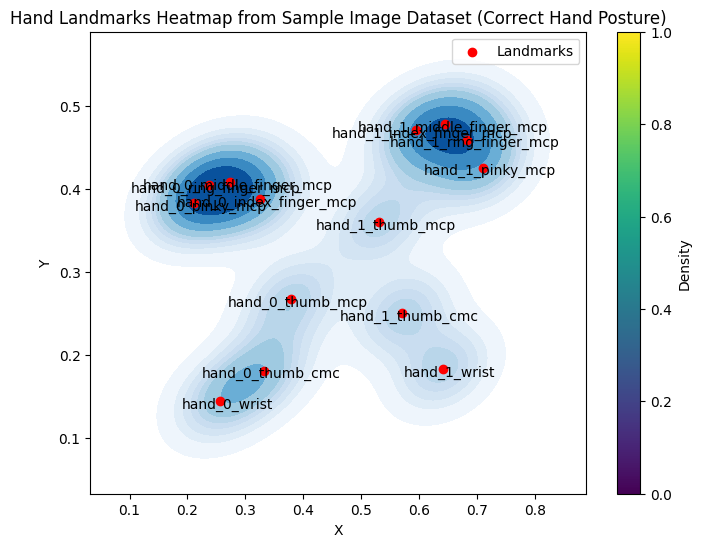

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 29 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct29.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.748398,0.265158,5.283482e-07,0
1,hand_0_thumb_cmc,0.681545,0.305613,-1.761666e-02,0
2,hand_0_thumb_mcp,0.645972,0.377159,-2.753905e-02,0
3,hand_0_index_finger_mcp,0.703472,0.454798,-4.768341e-02,0
4,hand_0_middle_finger_mcp,0.750109,0.462047,-3.739254e-02,0
5,hand_0_ring_finger_mcp,0.785272,0.451381,-2.562214e-02,0
6,hand_0_pinky_mcp,0.808034,0.430931,-1.419119e-02,0
7,hand_1_wrist,0.455672,0.227372,1.654310e-07,1
8,hand_1_thumb_cmc,0.530836,0.255250,4.890455e-03,1
9,hand_1_thumb_mcp,0.572688,0.324386,3.518982e-03,1


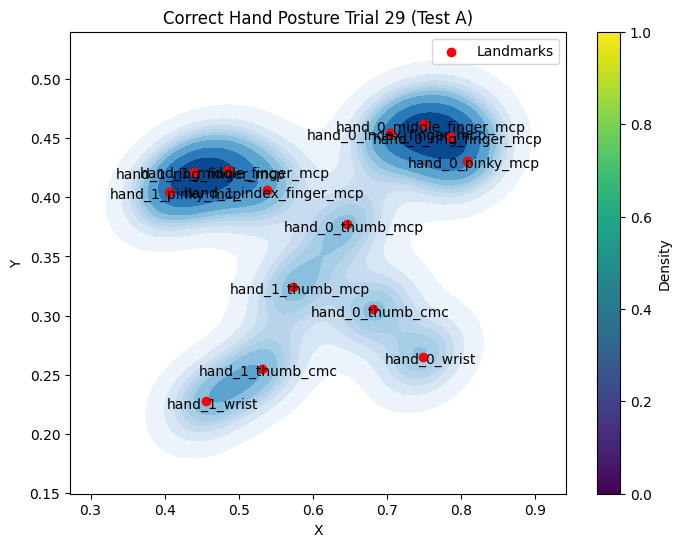

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 29 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 29.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.650775,0.187674,3.709516e-07,0
1,hand_0_thumb_cmc,0.579039,0.253249,-5.914858e-03,0
2,hand_0_thumb_mcp,0.540646,0.362399,-1.068448e-02,0
3,hand_0_index_finger_mcp,0.598582,0.468409,-3.312343e-02,0
4,hand_0_middle_finger_mcp,0.649711,0.477525,-2.816562e-02,0
5,hand_0_ring_finger_mcp,0.688222,0.462016,-2.113394e-02,0
6,hand_0_pinky_mcp,0.716521,0.431545,-1.358550e-02,0
7,hand_1_wrist,0.273291,0.123476,1.100871e-07,1
8,hand_1_thumb_cmc,0.349628,0.167928,-5.478024e-03,1
9,hand_1_thumb_mcp,0.395656,0.257139,-1.337436e-02,1


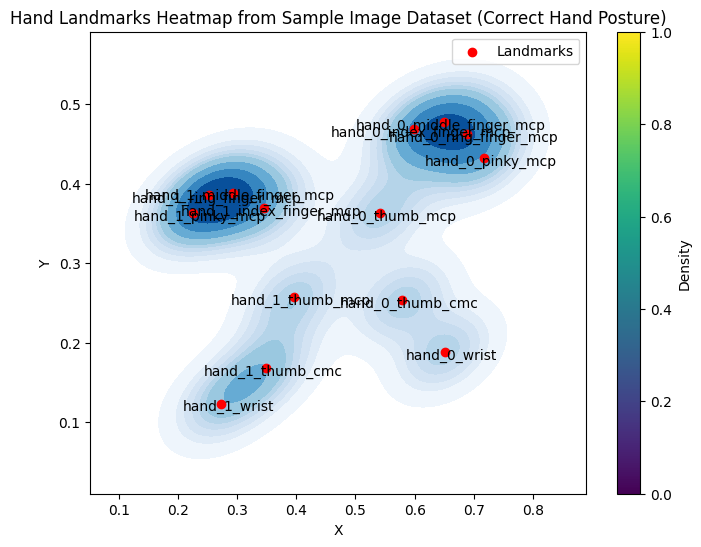

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 30 Comparison**

Trial 5

In [ ]:
correct_trial6 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Testing/.Correct/Rotated Images/Correct/TestA_correct30.png'

In [ ]:
test6_landmarks = extract_landmarks(correct_trial6)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
correct_trial6_data = []
for hand_idx, hand_landmarks in enumerate(test6_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial6_data = pd.DataFrame(data)
    first_trial6_data['Hand'] = hand_idx
    trial6_data = correct_trial6_data.append(first_trial6_data)

trial6_data = pd.concat(correct_trial6_data, ignore_index=True)
print("Correct Hand Posture Trial 1 (Test A)")
trial6_data

Correct Hand Posture Trial 1 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.430237,0.203432,1.957811e-07,0
1,hand_0_thumb_cmc,0.514334,0.229409,6.468733e-03,0
2,hand_0_thumb_mcp,0.556879,0.293568,4.134113e-04,0
3,hand_0_index_finger_mcp,0.526895,0.366907,-6.430991e-02,0
4,hand_0_middle_finger_mcp,0.473930,0.387206,-6.449983e-02,0
5,hand_0_ring_finger_mcp,0.430241,0.391344,-5.753910e-02,0
6,hand_0_pinky_mcp,0.397707,0.380911,-4.724182e-02,0
7,hand_1_wrist,0.763640,0.261053,5.676727e-07,1
8,hand_1_thumb_cmc,0.695105,0.295731,-1.900716e-02,1
9,hand_1_thumb_mcp,0.657727,0.365349,-2.980291e-02,1


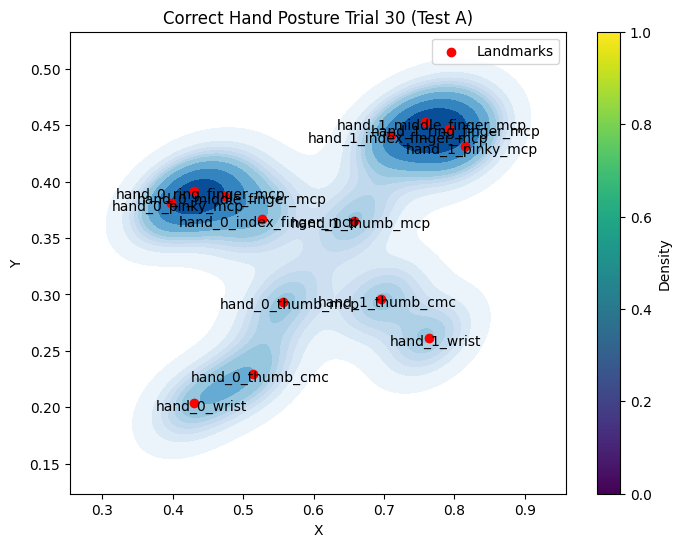

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=trial6_data['X'], y=trial6_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(trial6_data['X'], trial6_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(trial6_data['Landmark']):
    plt.annotate(landmark, (trial6_data['X'][i], trial6_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Correct Hand Posture Trial 30 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_correct5 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Correct/Sample Trial 21.jpg'
sample_correct5_landmarks = extract_landmarks(sample_correct5)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_correct5_data = []
for hand_idx, hand_landmarks in enumerate(sample_correct5_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial5_data = pd.DataFrame(data)
    sample_trial5_data['Hand'] = hand_idx
    sample5_data = sample_correct5_data.append(sample_trial5_data)

sample5_data = pd.concat(sample_correct5_data, ignore_index=True)
print("Correct Hand Posture from the Dataset")
sample5_data

Correct Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.268631,0.145641,2.076986e-07,0
1,hand_0_thumb_cmc,0.344453,0.187076,-1.220561e-02,0
2,hand_0_thumb_mcp,0.394678,0.275423,-1.916789e-02,0
3,hand_0_index_finger_mcp,0.341806,0.411449,-4.512191e-02,0
4,hand_0_middle_finger_mcp,0.292339,0.435508,-3.136138e-02,0
5,hand_0_ring_finger_mcp,0.256629,0.431996,-1.402766e-02,0
6,hand_0_pinky_mcp,0.234518,0.413593,4.991916e-03,0
7,hand_1_wrist,0.714047,0.130586,4.292368e-07,1
8,hand_1_thumb_cmc,0.639653,0.193370,-2.014430e-03,1
9,hand_1_thumb_mcp,0.595786,0.300581,-1.949756e-03,1


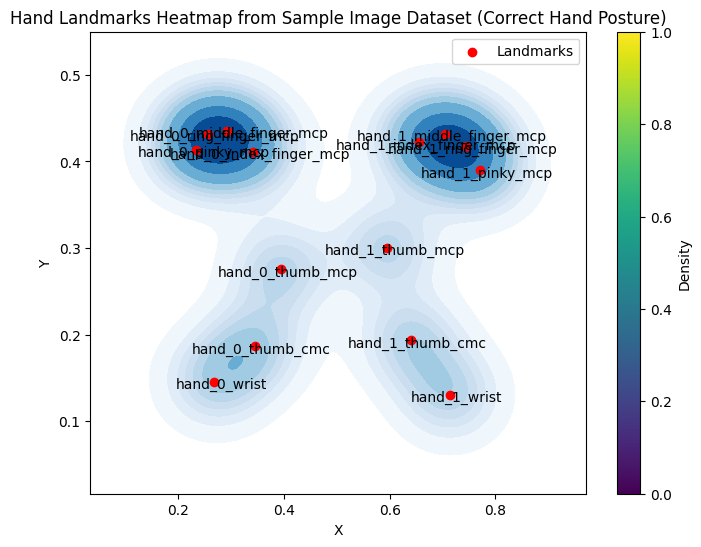

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=sample5_data['X'], y=sample5_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(sample5_data['X'], sample5_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(sample5_data['Landmark']):
    plt.annotate(landmark, (sample5_data['X'][i], sample5_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Correct Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

##**Incorrect**

###**Trial 1 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect1.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.328806,0.191037,-6.166620e-08,0
1,hand_0_thumb_cmc,0.415076,0.218380,1.791060e-02,0
2,hand_0_thumb_mcp,0.456672,0.285852,3.626711e-02,0
3,hand_0_index_finger_mcp,0.412357,0.406876,2.279462e-02,0
4,hand_0_middle_finger_mcp,0.355679,0.417905,2.876871e-02,0
5,hand_0_ring_finger_mcp,0.311973,0.404879,3.786775e-02,0
6,hand_0_pinky_mcp,0.274537,0.370324,4.902998e-02,0
7,hand_1_wrist,0.826356,0.181722,3.629835e-07,1
8,hand_1_thumb_cmc,0.753043,0.211721,-5.499810e-04,1
9,hand_1_thumb_mcp,0.711769,0.280060,2.466325e-03,1


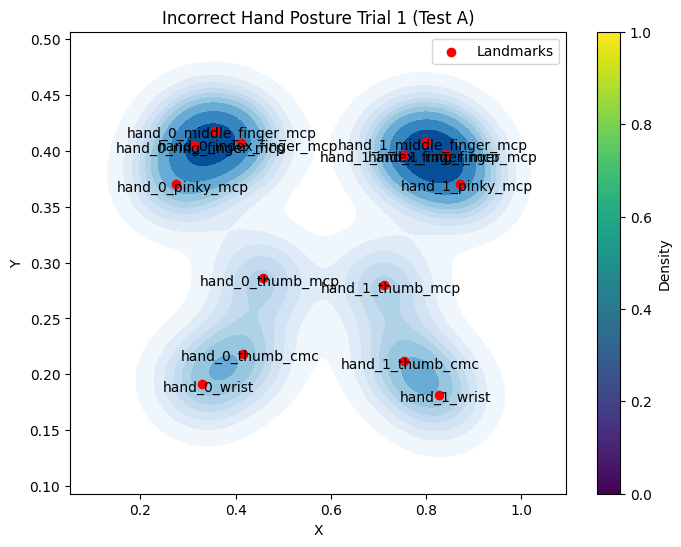

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 1 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_1.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.390550,0.320927,-4.215460e-07,0
1,hand_0_thumb_cmc,0.468232,0.341054,9.923948e-03,0
2,hand_0_thumb_mcp,0.505884,0.424527,2.160611e-02,0
3,hand_0_index_finger_mcp,0.476543,0.625806,2.409763e-03,0
4,hand_0_middle_finger_mcp,0.417668,0.642734,3.168843e-03,0
5,hand_0_ring_finger_mcp,0.370487,0.625862,6.007053e-03,0
6,hand_0_pinky_mcp,0.333826,0.583147,1.022367e-02,0
7,hand_1_wrist,0.814079,0.328414,-8.416026e-08,1
8,hand_1_thumb_cmc,0.730167,0.362705,4.521624e-02,1
9,hand_1_thumb_mcp,0.702588,0.447965,8.397099e-02,1


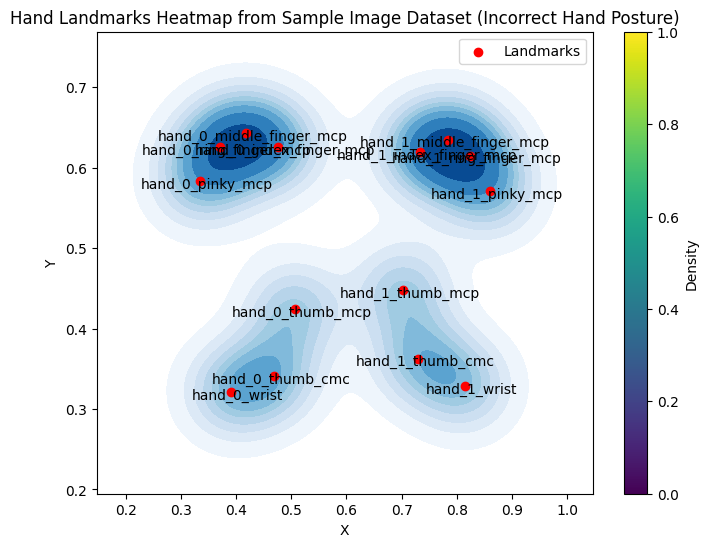

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 2 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_2.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.701741,0.186920,5.175564e-07,0
1,hand_0_thumb_cmc,0.630840,0.268277,-1.289716e-02,0
2,hand_0_thumb_mcp,0.606262,0.395734,-1.967911e-02,0
3,hand_0_index_finger_mcp,0.686174,0.488140,-3.880149e-02,0
4,hand_0_middle_finger_mcp,0.739894,0.470338,-3.120873e-02,0
5,hand_0_ring_finger_mcp,0.776974,0.432208,-2.243220e-02,0
6,hand_0_pinky_mcp,0.800396,0.385080,-1.379381e-02,0
7,hand_1_wrist,0.322896,0.187261,2.382061e-07,1
8,hand_1_thumb_cmc,0.389936,0.289527,-7.927480e-03,1
9,hand_1_thumb_mcp,0.408033,0.417460,-1.427957e-02,1


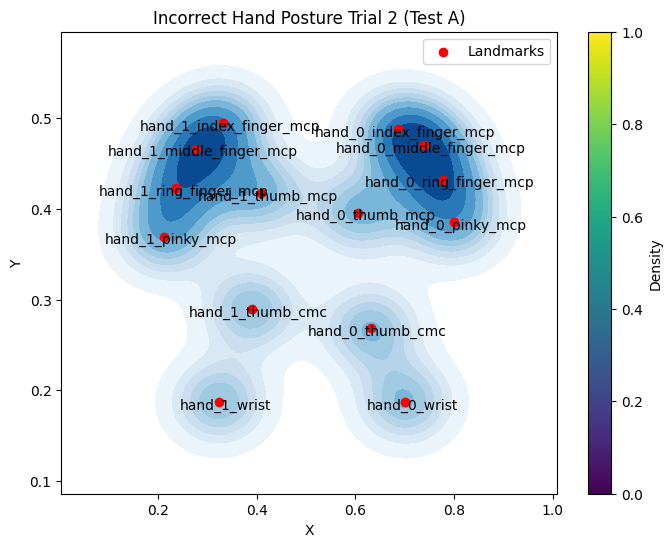

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 2 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_2.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.763958,0.262910,3.589062e-07,0
1,hand_0_thumb_cmc,0.703271,0.348473,-2.443745e-03,0
2,hand_0_thumb_mcp,0.681418,0.466291,-2.309185e-03,0
3,hand_0_index_finger_mcp,0.750728,0.550260,-1.719926e-02,0
4,hand_0_middle_finger_mcp,0.797783,0.532971,-1.158074e-02,0
5,hand_0_ring_finger_mcp,0.829332,0.496789,-4.523749e-03,0
6,hand_0_pinky_mcp,0.849246,0.449069,3.011403e-03,0
7,hand_1_wrist,0.481927,0.301074,2.202569e-07,1
8,hand_1_thumb_cmc,0.546263,0.383145,-4.350664e-03,1
9,hand_1_thumb_mcp,0.571556,0.498378,-8.996205e-03,1


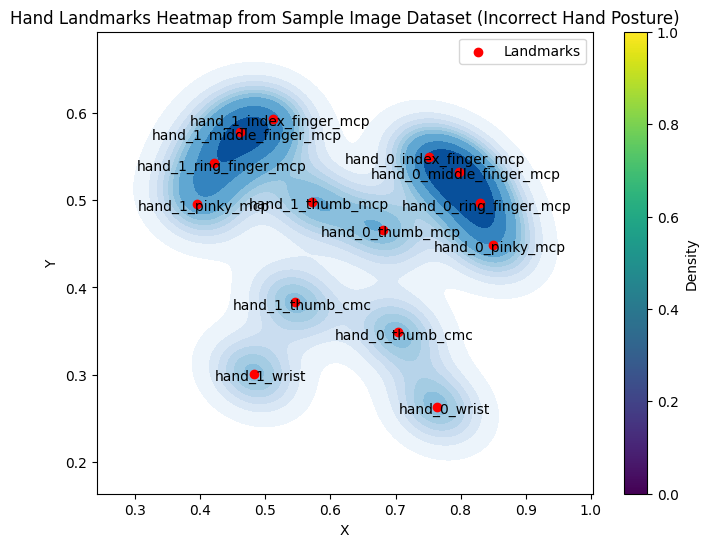

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 3 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_3.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.599513,0.237786,4.124378e-07,0
1,hand_0_thumb_cmc,0.528533,0.332866,-5.189236e-03,0
2,hand_0_thumb_mcp,0.501731,0.462845,-7.900517e-03,0
3,hand_0_index_finger_mcp,0.585342,0.564301,-2.402655e-02,0
4,hand_0_middle_finger_mcp,0.640286,0.543130,-1.868014e-02,0
5,hand_0_ring_finger_mcp,0.678575,0.502361,-1.210091e-02,0
6,hand_0_pinky_mcp,0.704115,0.445189,-5.167325e-03,0
7,hand_1_wrist,0.243821,0.275206,1.036791e-07,1
8,hand_1_thumb_cmc,0.306370,0.379139,-9.046447e-03,1
9,hand_1_thumb_mcp,0.324093,0.506811,-1.432566e-02,1


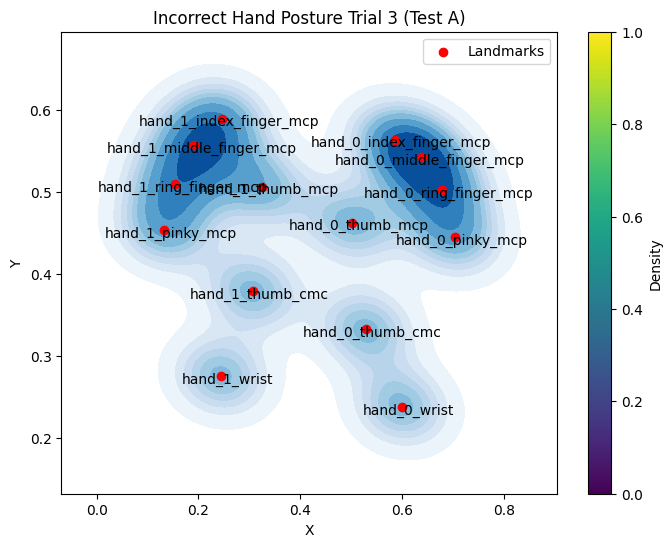

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 3 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_3.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.759650,0.274129,3.362495e-07,0
1,hand_0_thumb_cmc,0.696901,0.360348,3.235498e-03,0
2,hand_0_thumb_mcp,0.677838,0.475143,7.962281e-03,0
3,hand_0_index_finger_mcp,0.748385,0.566653,-3.212643e-03,0
4,hand_0_middle_finger_mcp,0.794966,0.546447,2.984076e-03,0
5,hand_0_ring_finger_mcp,0.826714,0.508108,1.044021e-02,0
6,hand_0_pinky_mcp,0.846962,0.456745,1.866517e-02,0
7,hand_1_wrist,0.485485,0.304677,2.359209e-07,1
8,hand_1_thumb_cmc,0.549653,0.390529,-3.306922e-03,1
9,hand_1_thumb_mcp,0.573649,0.506500,-6.873181e-03,1


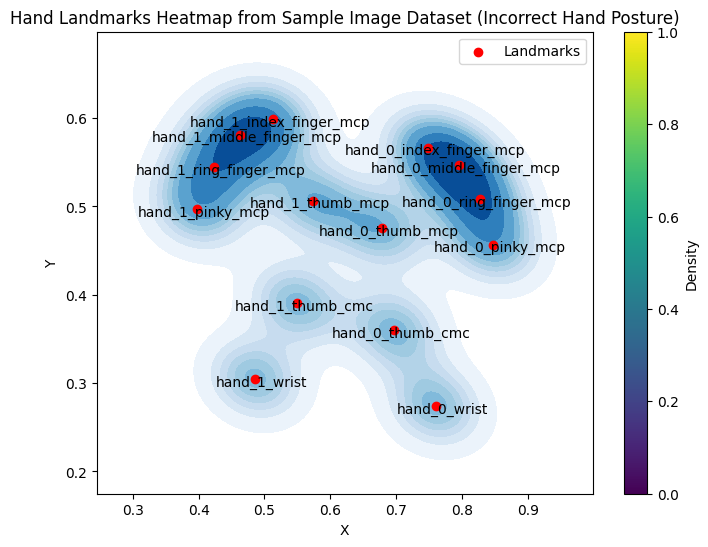

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 4 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect4.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.818098,0.277410,5.368266e-07,0
1,hand_0_thumb_cmc,0.746172,0.283325,-1.788536e-02,0
2,hand_0_thumb_mcp,0.694404,0.328909,-2.823726e-02,0
3,hand_0_index_finger_mcp,0.733610,0.416375,-5.264599e-02,0
4,hand_0_middle_finger_mcp,0.773360,0.449840,-4.258722e-02,0
5,hand_0_ring_finger_mcp,0.803738,0.464473,-3.081442e-02,0
6,hand_0_pinky_mcp,0.826936,0.465180,-1.907928e-02,0
7,hand_1_wrist,0.365601,0.254283,1.283298e-07,1
8,hand_1_thumb_cmc,0.448373,0.227410,7.705163e-03,1
9,hand_1_thumb_mcp,0.505317,0.269582,7.738939e-03,1


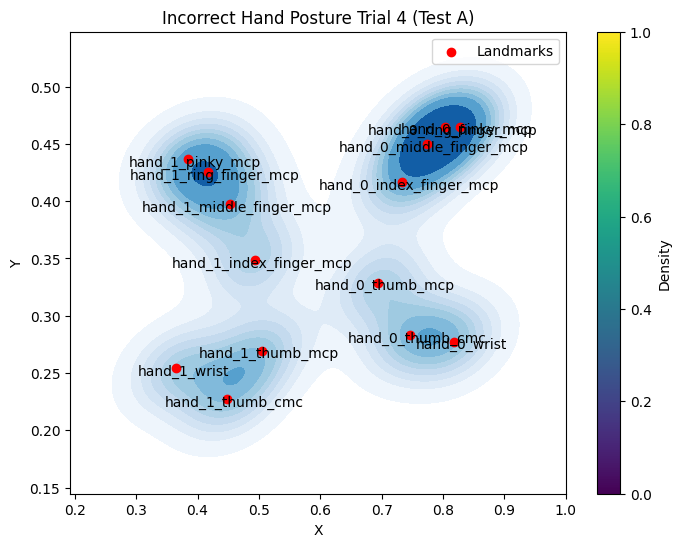

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 4 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_4.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.283886,0.250849,-8.394591e-09,0
1,hand_0_thumb_cmc,0.363761,0.240348,-6.250648e-03,0
2,hand_0_thumb_mcp,0.418572,0.309736,-9.512666e-03,0
3,hand_0_index_finger_mcp,0.382165,0.447686,-4.481883e-02,0
4,hand_0_middle_finger_mcp,0.335777,0.499072,-3.955702e-02,0
5,hand_0_ring_finger_mcp,0.299140,0.518958,-3.076433e-02,0
6,hand_0_pinky_mcp,0.271069,0.516583,-2.018274e-02,0
7,hand_1_wrist,0.816930,0.283970,4.977987e-07,1
8,hand_1_thumb_cmc,0.741379,0.275414,-1.501418e-02,1
9,hand_1_thumb_mcp,0.677640,0.327831,-2.843781e-02,1


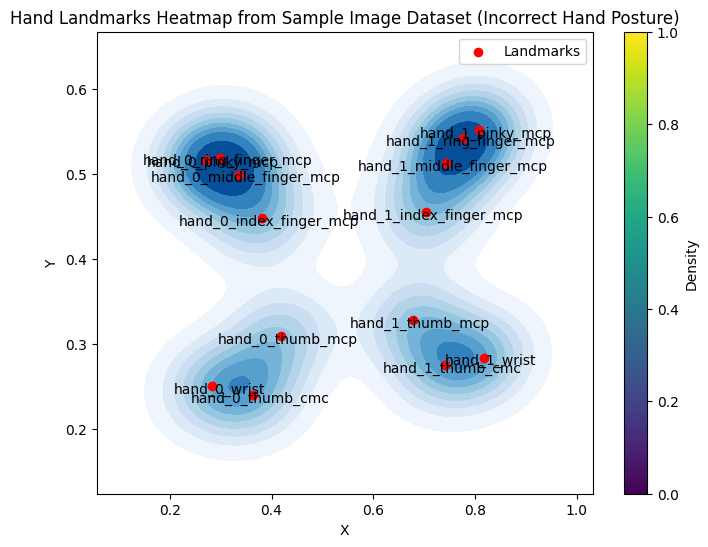

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 5 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_6.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.278351,0.273352,1.634060e-08,0
1,hand_0_thumb_cmc,0.364787,0.265527,-3.658755e-03,0
2,hand_0_thumb_mcp,0.421644,0.341793,-7.838445e-03,0
3,hand_0_index_finger_mcp,0.390420,0.448748,-6.464500e-02,0
4,hand_0_middle_finger_mcp,0.345020,0.512931,-5.795852e-02,0
5,hand_0_ring_finger_mcp,0.312012,0.540084,-4.801034e-02,0
6,hand_0_pinky_mcp,0.288624,0.545204,-3.591491e-02,0
7,hand_1_wrist,0.788063,0.303146,5.928014e-07,1
8,hand_1_thumb_cmc,0.708040,0.293935,-1.795502e-02,1
9,hand_1_thumb_mcp,0.647156,0.350140,-2.904074e-02,1


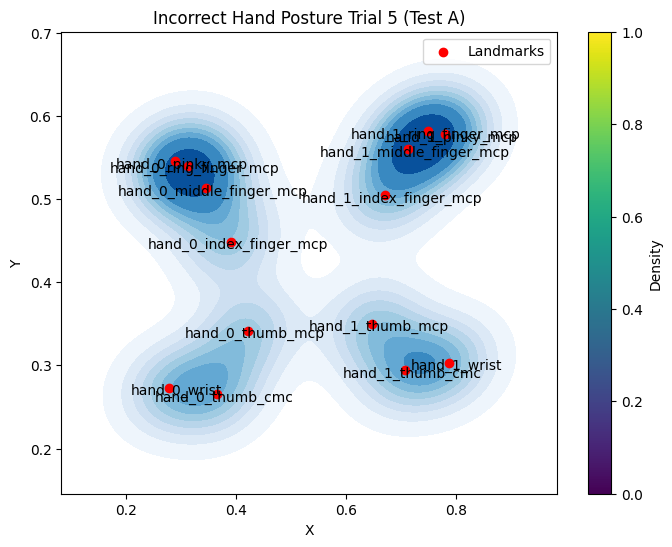

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 5 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_6.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.801977,0.548726,5.242899e-07,0
1,hand_0_thumb_cmc,0.738212,0.529535,-2.214707e-02,0
2,hand_0_thumb_mcp,0.675606,0.564172,-3.529252e-02,0
3,hand_0_index_finger_mcp,0.708126,0.716411,-4.371195e-02,0
4,hand_0_middle_finger_mcp,0.739881,0.770533,-3.429501e-02,0
5,hand_0_ring_finger_mcp,0.766262,0.796990,-2.423374e-02,0
6,hand_0_pinky_mcp,0.787642,0.803737,-1.477381e-02,0
7,hand_1_wrist,0.333244,0.465146,5.540359e-08,1
8,hand_1_thumb_cmc,0.405686,0.448078,-9.927512e-03,1
9,hand_1_thumb_mcp,0.460340,0.503349,-1.820689e-02,1


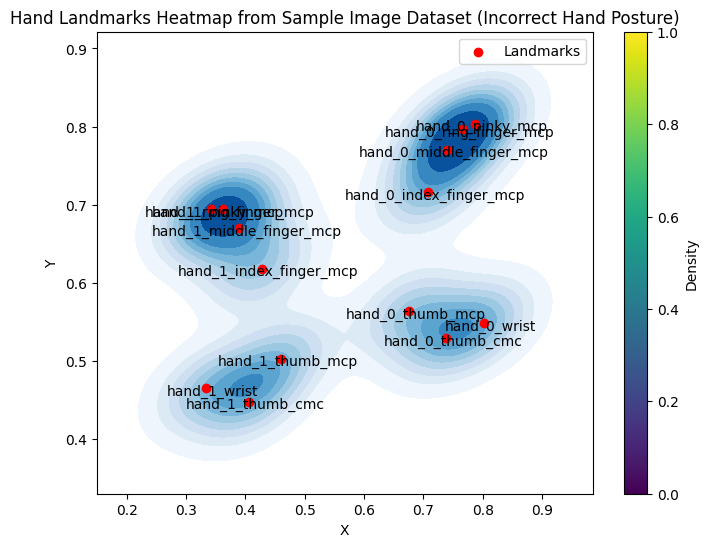

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 6 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_6.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.801977,0.548726,5.242899e-07,0
1,hand_0_thumb_cmc,0.738212,0.529535,-2.214707e-02,0
2,hand_0_thumb_mcp,0.675606,0.564172,-3.529252e-02,0
3,hand_0_index_finger_mcp,0.708126,0.716411,-4.371195e-02,0
4,hand_0_middle_finger_mcp,0.739881,0.770533,-3.429501e-02,0
5,hand_0_ring_finger_mcp,0.766262,0.796990,-2.423374e-02,0
6,hand_0_pinky_mcp,0.787642,0.803737,-1.477381e-02,0
7,hand_1_wrist,0.333244,0.465146,5.540359e-08,1
8,hand_1_thumb_cmc,0.405686,0.448078,-9.927512e-03,1
9,hand_1_thumb_mcp,0.460340,0.503349,-1.820689e-02,1


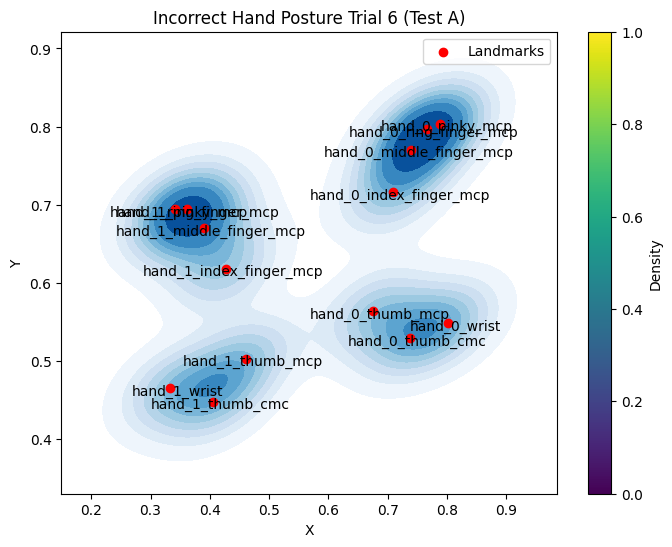

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 6 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_7.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.844155,0.488598,5.570848e-07,0
1,hand_0_thumb_cmc,0.783324,0.472511,-2.670550e-02,0
2,hand_0_thumb_mcp,0.718460,0.509169,-4.317306e-02,0
3,hand_0_index_finger_mcp,0.756199,0.653655,-5.650742e-02,0
4,hand_0_middle_finger_mcp,0.786150,0.713533,-4.611214e-02,0
5,hand_0_ring_finger_mcp,0.809807,0.744361,-3.483858e-02,0
6,hand_0_pinky_mcp,0.826804,0.750044,-2.431255e-02,0
7,hand_1_wrist,0.366257,0.454691,2.306967e-07,1
8,hand_1_thumb_cmc,0.439127,0.429053,-1.019398e-02,1
9,hand_1_thumb_mcp,0.495082,0.480930,-2.202351e-02,1


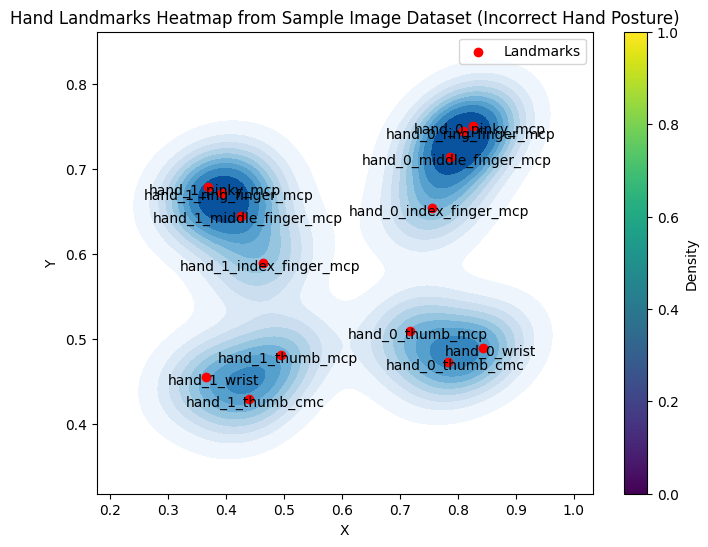

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 7 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect8.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.759176,0.184396,4.093229e-07,0
1,hand_0_thumb_cmc,0.694271,0.242142,-8.408974e-03,0
2,hand_0_thumb_mcp,0.663112,0.325419,-1.531278e-02,0
3,hand_0_index_finger_mcp,0.727857,0.388410,-3.552475e-02,0
4,hand_0_middle_finger_mcp,0.776715,0.383148,-2.954412e-02,0
5,hand_0_ring_finger_mcp,0.812709,0.361541,-2.185851e-02,0
6,hand_0_pinky_mcp,0.835776,0.332219,-1.387965e-02,0
7,hand_1_wrist,0.384351,0.196018,1.920399e-07,1
8,hand_1_thumb_cmc,0.459140,0.266016,1.151396e-02,1
9,hand_1_thumb_mcp,0.489109,0.346329,1.267326e-02,1


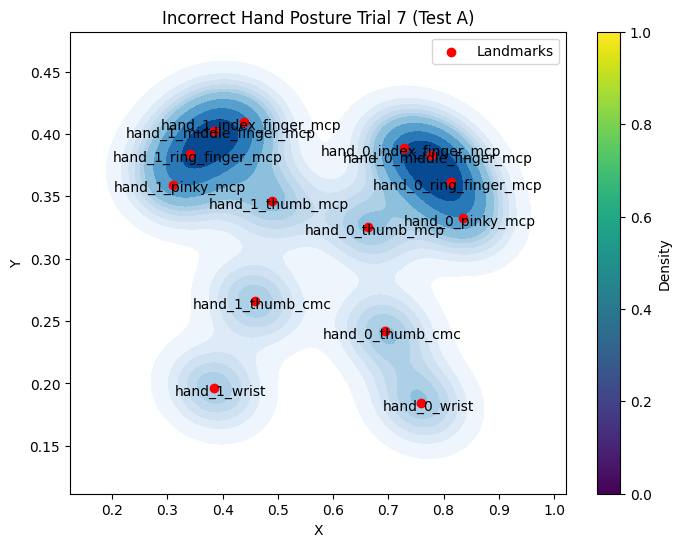

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 7 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect9.png'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.826231,0.178768,3.401189e-07,0
1,hand_0_thumb_cmc,0.752760,0.211313,1.156435e-03,0
2,hand_0_thumb_mcp,0.712136,0.281154,4.913090e-03,0
3,hand_0_index_finger_mcp,0.752981,0.396872,6.723722e-03,0
4,hand_0_middle_finger_mcp,0.801201,0.407724,1.153097e-02,0
5,hand_0_ring_finger_mcp,0.841898,0.396458,1.707322e-02,0
6,hand_0_pinky_mcp,0.871687,0.370105,2.264167e-02,0
7,hand_1_wrist,0.328121,0.188596,-7.320600e-08,1
8,hand_1_thumb_cmc,0.415888,0.218403,2.297574e-02,1
9,hand_1_thumb_mcp,0.457209,0.287455,4.582493e-02,1


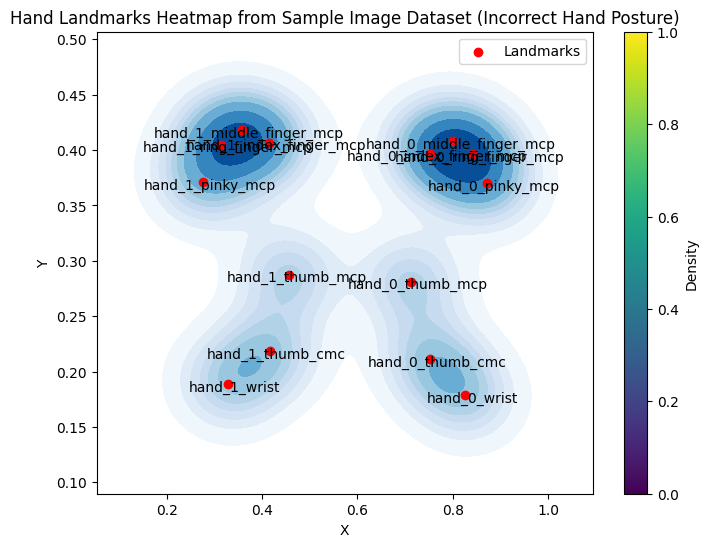

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 8 Comparison**

Trial 1

In [ ]:
trial2_inc =  '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_7.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.844155,0.488598,5.570848e-07,0
1,hand_0_thumb_cmc,0.783324,0.472511,-2.670550e-02,0
2,hand_0_thumb_mcp,0.718460,0.509169,-4.317306e-02,0
3,hand_0_index_finger_mcp,0.756199,0.653655,-5.650742e-02,0
4,hand_0_middle_finger_mcp,0.786150,0.713533,-4.611214e-02,0
5,hand_0_ring_finger_mcp,0.809807,0.744361,-3.483858e-02,0
6,hand_0_pinky_mcp,0.826804,0.750044,-2.431255e-02,0
7,hand_1_wrist,0.366257,0.454691,2.306967e-07,1
8,hand_1_thumb_cmc,0.439127,0.429053,-1.019398e-02,1
9,hand_1_thumb_mcp,0.495082,0.480930,-2.202351e-02,1


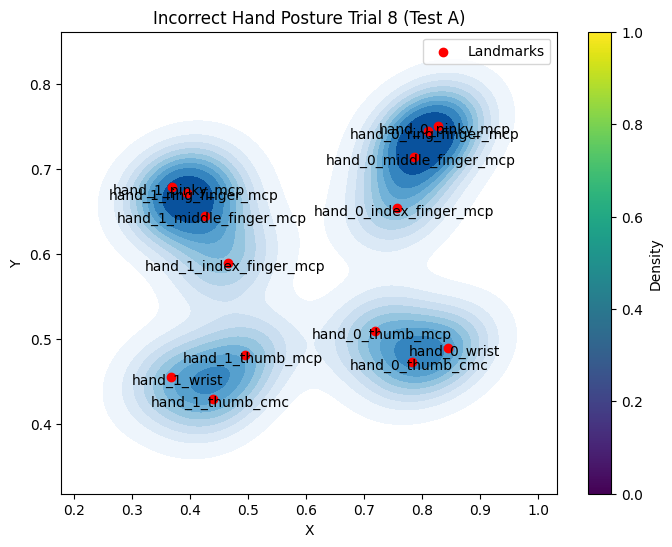

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 8 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_8.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.849948,0.439714,6.719991e-07,0
1,hand_0_thumb_cmc,0.781548,0.419731,-3.382518e-02,0
2,hand_0_thumb_mcp,0.720006,0.461541,-5.180526e-02,0
3,hand_0_index_finger_mcp,0.746934,0.638358,-6.073000e-02,0
4,hand_0_middle_finger_mcp,0.780609,0.700259,-4.403571e-02,0
5,hand_0_ring_finger_mcp,0.807532,0.726350,-2.694348e-02,0
6,hand_0_pinky_mcp,0.826423,0.725842,-1.098339e-02,0
7,hand_1_wrist,0.312944,0.469086,2.050202e-07,1
8,hand_1_thumb_cmc,0.388966,0.421801,-2.874489e-02,1
9,hand_1_thumb_mcp,0.453140,0.460302,-4.408221e-02,1


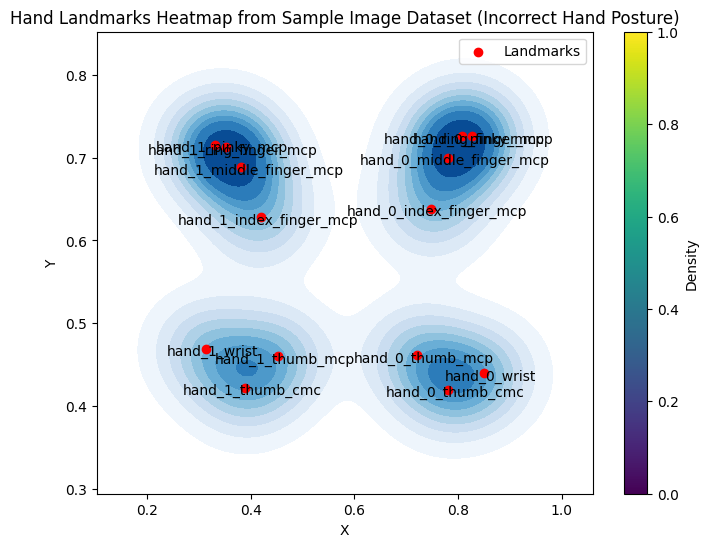

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 9 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect9.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.826231,0.178768,3.401189e-07,0
1,hand_0_thumb_cmc,0.752760,0.211313,1.156435e-03,0
2,hand_0_thumb_mcp,0.712136,0.281154,4.913090e-03,0
3,hand_0_index_finger_mcp,0.752981,0.396872,6.723722e-03,0
4,hand_0_middle_finger_mcp,0.801201,0.407724,1.153097e-02,0
5,hand_0_ring_finger_mcp,0.841898,0.396458,1.707322e-02,0
6,hand_0_pinky_mcp,0.871687,0.370105,2.264167e-02,0
7,hand_1_wrist,0.328121,0.188596,-7.320600e-08,1
8,hand_1_thumb_cmc,0.415888,0.218403,2.297574e-02,1
9,hand_1_thumb_mcp,0.457209,0.287455,4.582493e-02,1


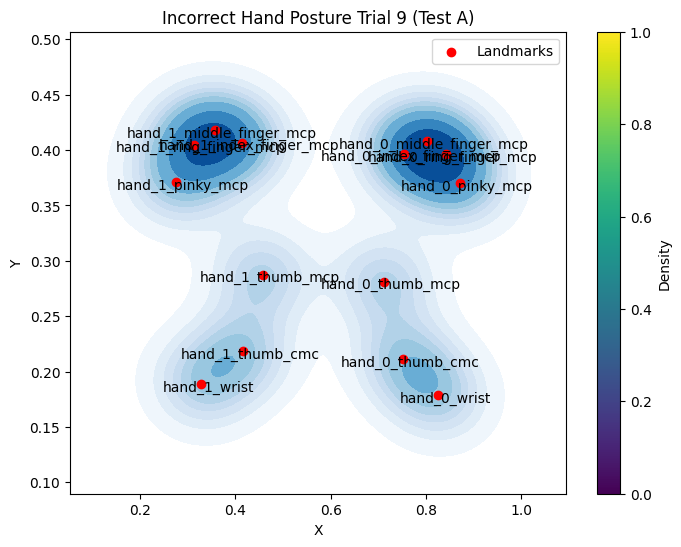

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 9 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_10.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.456060,0.245226,2.199789e-07,0
1,hand_0_thumb_cmc,0.527526,0.317277,-9.595617e-03,0
2,hand_0_thumb_mcp,0.565495,0.427751,-1.581587e-02,0
3,hand_0_index_finger_mcp,0.492664,0.549072,-2.234834e-02,0
4,hand_0_middle_finger_mcp,0.443633,0.535951,-2.068423e-02,0
5,hand_0_ring_finger_mcp,0.405661,0.504314,-1.894617e-02,0
6,hand_0_pinky_mcp,0.379772,0.463536,-1.721598e-02,0
7,hand_1_wrist,0.714880,0.326476,2.280226e-07,1
8,hand_1_thumb_cmc,0.658694,0.422935,-5.325958e-03,1
9,hand_1_thumb_mcp,0.648932,0.547717,-3.593557e-03,1


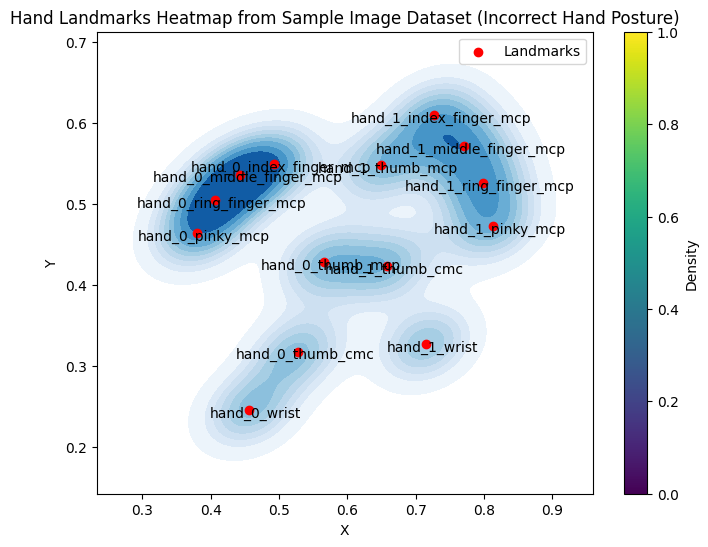

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 10 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect11.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.790930,0.195452,3.500854e-07,0
1,hand_0_thumb_cmc,0.718415,0.237686,3.088414e-04,0
2,hand_0_thumb_mcp,0.680698,0.312798,1.891901e-03,0
3,hand_0_index_finger_mcp,0.735263,0.408808,-1.202466e-02,0
4,hand_0_middle_finger_mcp,0.784894,0.415267,-2.205314e-03,0
5,hand_0_ring_finger_mcp,0.823456,0.399893,1.009443e-02,0
6,hand_0_pinky_mcp,0.849559,0.371972,2.297976e-02,0
7,hand_1_wrist,0.379374,0.199245,-8.396135e-08,1
8,hand_1_thumb_cmc,0.465903,0.244895,4.067748e-02,1
9,hand_1_thumb_mcp,0.502045,0.311141,6.918125e-02,1


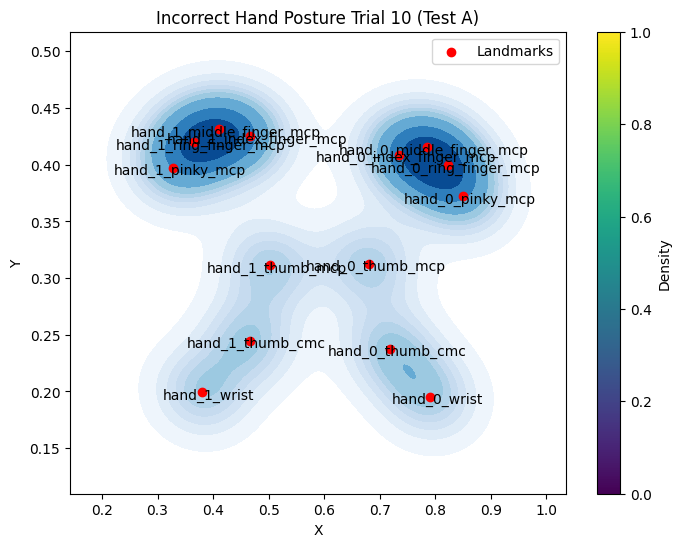

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 10 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_11.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.321381,0.440511,-2.288689e-07,0
1,hand_0_thumb_cmc,0.397207,0.464296,8.065195e-03,0
2,hand_0_thumb_mcp,0.437754,0.540662,1.750548e-02,0
3,hand_0_index_finger_mcp,0.397029,0.734643,4.774738e-03,0
4,hand_0_middle_finger_mcp,0.339958,0.742345,8.090476e-03,0
5,hand_0_ring_finger_mcp,0.297417,0.721437,1.296269e-02,0
6,hand_0_pinky_mcp,0.266177,0.679204,1.909676e-02,0
7,hand_1_wrist,0.758589,0.404104,3.757489e-08,1
8,hand_1_thumb_cmc,0.679404,0.446534,5.406078e-03,1
9,hand_1_thumb_mcp,0.641634,0.540768,1.108237e-02,1


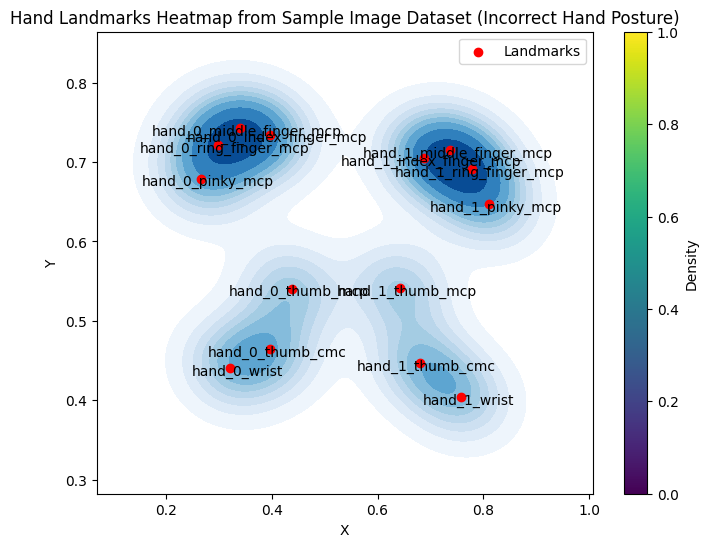

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 11 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect11.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.790930,0.195452,3.500854e-07,0
1,hand_0_thumb_cmc,0.718415,0.237686,3.088414e-04,0
2,hand_0_thumb_mcp,0.680698,0.312798,1.891901e-03,0
3,hand_0_index_finger_mcp,0.735263,0.408808,-1.202466e-02,0
4,hand_0_middle_finger_mcp,0.784894,0.415267,-2.205314e-03,0
5,hand_0_ring_finger_mcp,0.823456,0.399893,1.009443e-02,0
6,hand_0_pinky_mcp,0.849559,0.371972,2.297976e-02,0
7,hand_1_wrist,0.379374,0.199245,-8.396135e-08,1
8,hand_1_thumb_cmc,0.465903,0.244895,4.067748e-02,1
9,hand_1_thumb_mcp,0.502045,0.311141,6.918125e-02,1


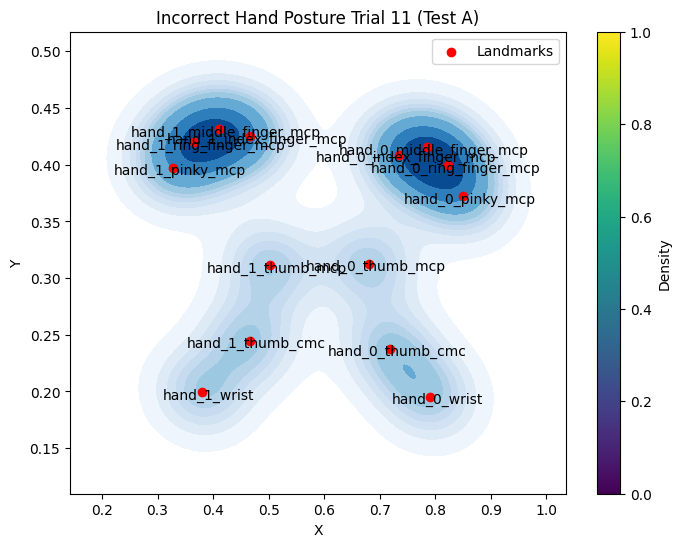

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 11 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial11.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.270552,0.320842,-9.773621e-08,0
1,hand_0_thumb_cmc,0.353552,0.341371,1.377886e-02,0
2,hand_0_thumb_mcp,0.396936,0.430052,2.968859e-02,0
3,hand_0_index_finger_mcp,0.357928,0.607501,1.791083e-02,0
4,hand_0_middle_finger_mcp,0.301752,0.622741,2.765612e-02,0
5,hand_0_ring_finger_mcp,0.258579,0.601478,4.010751e-02,0
6,hand_0_pinky_mcp,0.227427,0.554662,5.447242e-02,0
7,hand_1_wrist,0.736714,0.278218,-2.457084e-08,1
8,hand_1_thumb_cmc,0.651177,0.316553,3.632252e-02,1
9,hand_1_thumb_mcp,0.625071,0.418773,7.271154e-02,1


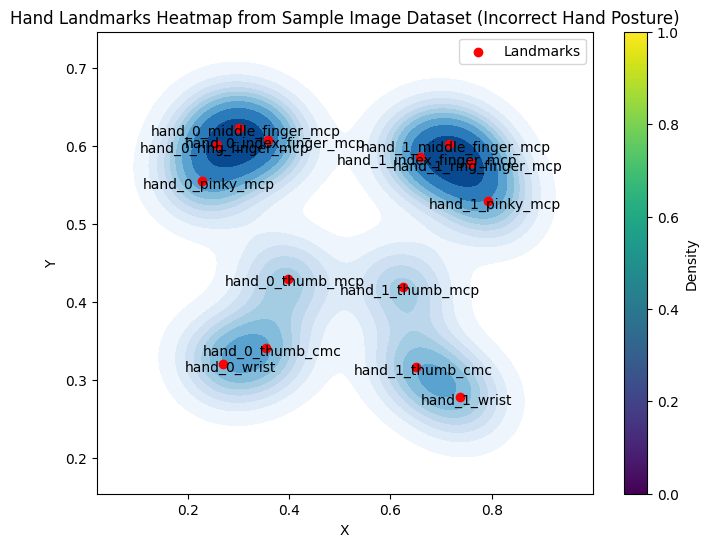

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 12 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect12.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.785777,0.189198,3.366447e-07,0
1,hand_0_thumb_cmc,0.713732,0.227567,1.878118e-03,0
2,hand_0_thumb_mcp,0.675208,0.301161,4.448472e-03,0
3,hand_0_index_finger_mcp,0.726397,0.402978,-1.170008e-02,0
4,hand_0_middle_finger_mcp,0.774711,0.412224,-4.642882e-03,0
5,hand_0_ring_finger_mcp,0.813263,0.398746,5.308106e-03,0
6,hand_0_pinky_mcp,0.840195,0.371403,1.609087e-02,0
7,hand_1_wrist,0.399298,0.197950,-5.579710e-08,1
8,hand_1_thumb_cmc,0.484585,0.234675,3.421950e-02,1
9,hand_1_thumb_mcp,0.517722,0.304951,5.734692e-02,1


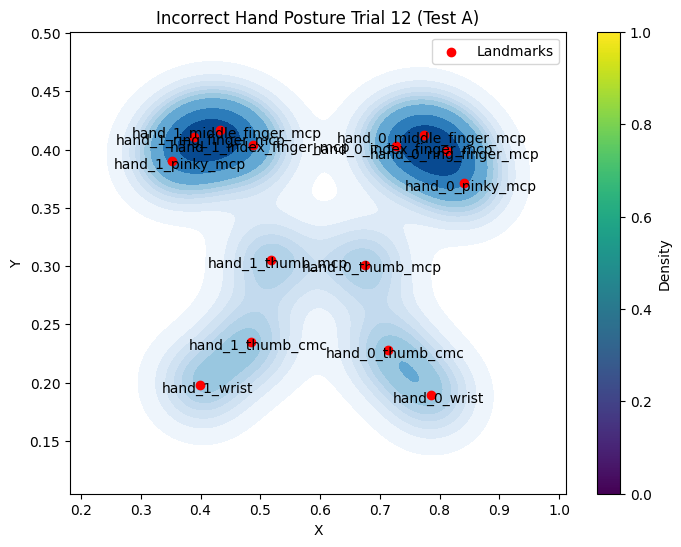

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 12 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_12.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.232745,0.321554,-1.094378e-07,0
1,hand_0_thumb_cmc,0.312845,0.344366,1.310800e-02,0
2,hand_0_thumb_mcp,0.356880,0.430257,2.637859e-02,0
3,hand_0_index_finger_mcp,0.314699,0.609973,1.540564e-02,0
4,hand_0_middle_finger_mcp,0.261582,0.627370,2.359963e-02,0
5,hand_0_ring_finger_mcp,0.220145,0.610308,3.457905e-02,0
6,hand_0_pinky_mcp,0.188977,0.566398,4.723977e-02,0
7,hand_1_wrist,0.701510,0.272803,-2.293264e-07,1
8,hand_1_thumb_cmc,0.618032,0.299855,4.253275e-02,1
9,hand_1_thumb_mcp,0.585760,0.382135,7.538594e-02,1


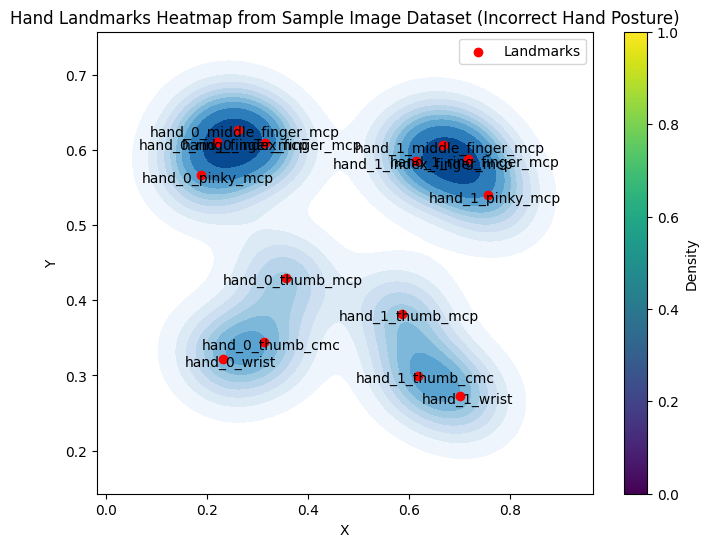

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 13 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect13.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.814622,0.176492,3.452057e-07,0
1,hand_0_thumb_cmc,0.740971,0.217624,-4.394491e-03,0
2,hand_0_thumb_mcp,0.699170,0.294357,-3.749989e-03,0
3,hand_0_index_finger_mcp,0.751770,0.405001,-6.853683e-03,0
4,hand_0_middle_finger_mcp,0.799285,0.412555,2.267948e-03,0
5,hand_0_ring_finger_mcp,0.837295,0.396305,1.361238e-02,0
6,hand_0_pinky_mcp,0.863053,0.364266,2.512660e-02,0
7,hand_1_wrist,0.386155,0.192052,-2.119094e-07,1
8,hand_1_thumb_cmc,0.472721,0.221176,3.296565e-02,1
9,hand_1_thumb_mcp,0.508238,0.289627,5.680595e-02,1


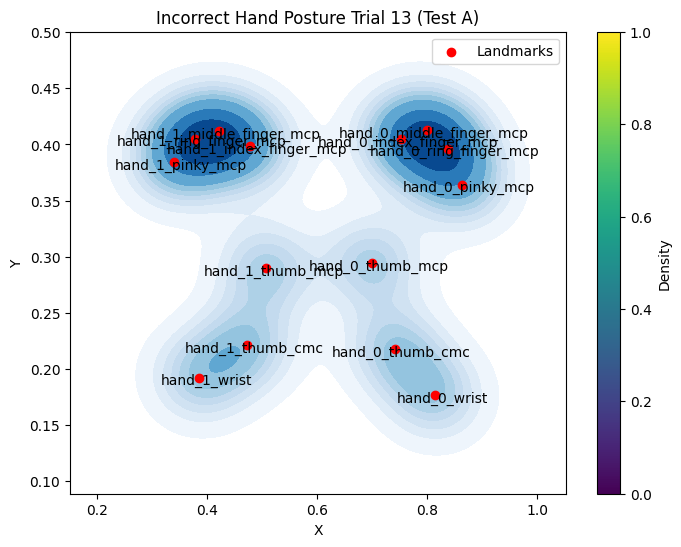

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 13 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_13.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.223405,0.321444,-4.172104e-07,0
1,hand_0_thumb_cmc,0.305213,0.342291,9.840993e-03,0
2,hand_0_thumb_mcp,0.354492,0.418451,2.150037e-02,0
3,hand_0_index_finger_mcp,0.313392,0.631676,1.645072e-02,0
4,hand_0_middle_finger_mcp,0.260480,0.645263,2.584874e-02,0
5,hand_0_ring_finger_mcp,0.217865,0.625898,3.844308e-02,0
6,hand_0_pinky_mcp,0.186298,0.587342,5.271903e-02,0
7,hand_1_wrist,0.725812,0.241026,1.563423e-07,1
8,hand_1_thumb_cmc,0.637406,0.256059,1.029619e-02,1
9,hand_1_thumb_mcp,0.595270,0.348813,2.568571e-02,1


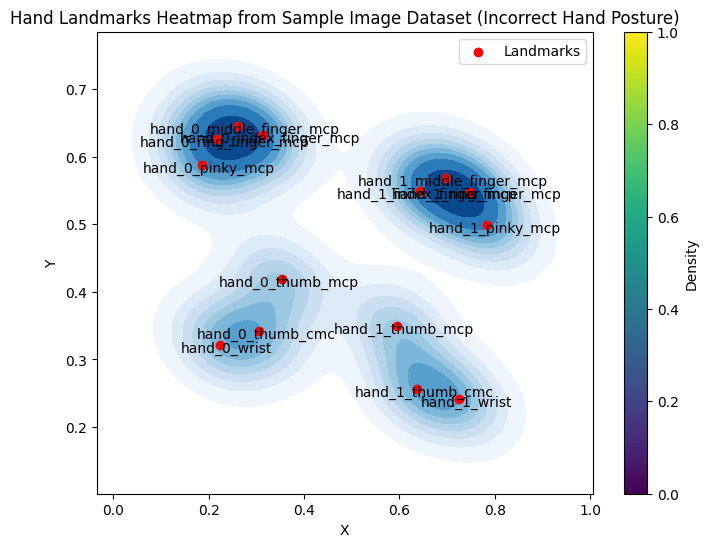

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 14 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect14.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.770871,0.190781,3.066985e-08,0
1,hand_0_thumb_cmc,0.706773,0.274637,1.595369e-02,0
2,hand_0_thumb_mcp,0.690934,0.363605,2.551948e-02,0
3,hand_0_index_finger_mcp,0.764315,0.443590,2.343168e-02,0
4,hand_0_middle_finger_mcp,0.813259,0.424308,2.519893e-02,0
5,hand_0_ring_finger_mcp,0.848025,0.389894,2.959498e-02,0
6,hand_0_pinky_mcp,0.868549,0.348655,3.491719e-02,0
7,hand_1_wrist,0.352850,0.211860,1.522482e-07,1
8,hand_1_thumb_cmc,0.426020,0.292824,2.339401e-02,1
9,hand_1_thumb_mcp,0.443456,0.378979,3.783308e-02,1


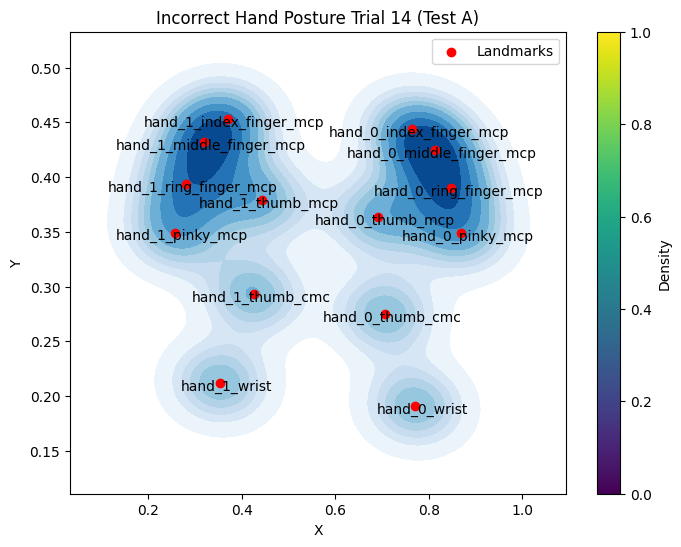

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 14 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_28.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.588556,0.071538,2.860371e-07,0
1,hand_0_thumb_cmc,0.540081,0.162721,-1.924556e-03,0
2,hand_0_thumb_mcp,0.522782,0.265533,-7.464602e-03,0
3,hand_0_index_finger_mcp,0.585997,0.317483,-4.157072e-02,0
4,hand_0_middle_finger_mcp,0.629377,0.293994,-3.894723e-02,0
5,hand_0_ring_finger_mcp,0.660091,0.258579,-3.338895e-02,0
6,hand_0_pinky_mcp,0.678407,0.215210,-2.666275e-02,0
7,hand_1_wrist,0.321821,0.072335,2.888922e-07,1
8,hand_1_thumb_cmc,0.377994,0.147053,-1.800605e-02,1
9,hand_1_thumb_mcp,0.401307,0.239428,-2.993636e-02,1


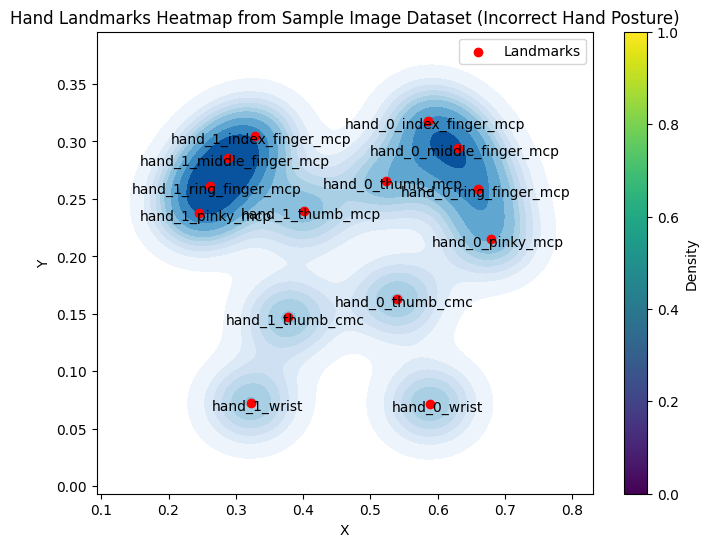

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 15 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect15.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.343934,0.217265,1.855834e-07,0
1,hand_0_thumb_cmc,0.413531,0.307872,3.674765e-02,0
2,hand_0_thumb_mcp,0.429990,0.394055,5.999062e-02,0
3,hand_0_index_finger_mcp,0.352542,0.466607,4.125780e-02,0
4,hand_0_middle_finger_mcp,0.305515,0.441100,4.603902e-02,0
5,hand_0_ring_finger_mcp,0.271690,0.401124,5.421680e-02,0
6,hand_0_pinky_mcp,0.249665,0.356322,6.636516e-02,0
7,hand_1_wrist,0.789117,0.207892,2.323539e-07,1
8,hand_1_thumb_cmc,0.727112,0.275339,-8.949655e-04,1
9,hand_1_thumb_mcp,0.709728,0.356655,-7.116515e-04,1


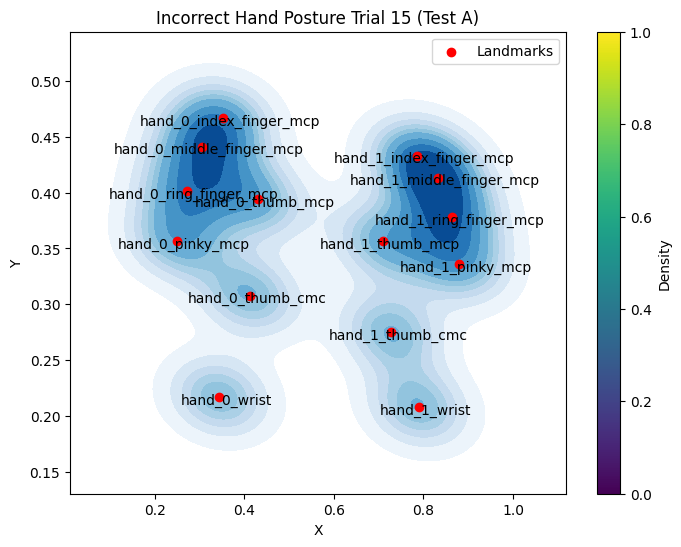

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 15 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_15.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.305513,0.125082,4.447697e-07,0
1,hand_0_thumb_cmc,0.366141,0.216447,-1.726699e-02,0
2,hand_0_thumb_mcp,0.388558,0.333118,-2.448059e-02,0
3,hand_0_index_finger_mcp,0.308904,0.417551,-2.179692e-02,0
4,hand_0_middle_finger_mcp,0.266524,0.393727,-8.525466e-03,0
5,hand_0_ring_finger_mcp,0.239593,0.356330,4.736715e-03,0
6,hand_0_pinky_mcp,0.224217,0.320397,1.846714e-02,0
7,hand_1_wrist,0.666298,0.119194,2.136964e-07,1
8,hand_1_thumb_cmc,0.603097,0.218078,8.894335e-03,1
9,hand_1_thumb_mcp,0.584745,0.341289,1.689930e-02,1


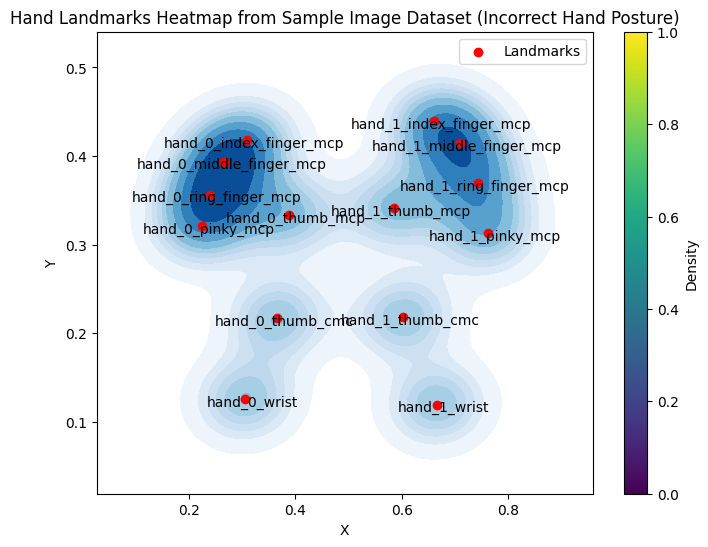

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 16 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect5.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.386583,0.233260,1.559003e-07,0
1,hand_0_thumb_cmc,0.466381,0.208122,7.456792e-03,0
2,hand_0_thumb_mcp,0.523342,0.247460,5.927432e-03,0
3,hand_0_index_finger_mcp,0.509294,0.327349,-4.663305e-02,0
4,hand_0_middle_finger_mcp,0.469357,0.374550,-4.555459e-02,0
5,hand_0_ring_finger_mcp,0.433465,0.401727,-3.924266e-02,0
6,hand_0_pinky_mcp,0.401284,0.412886,-2.990853e-02,0
7,hand_1_wrist,0.813389,0.271869,5.704695e-07,1
8,hand_1_thumb_cmc,0.744801,0.267358,-2.185730e-02,1
9,hand_1_thumb_mcp,0.694363,0.315390,-3.449201e-02,1


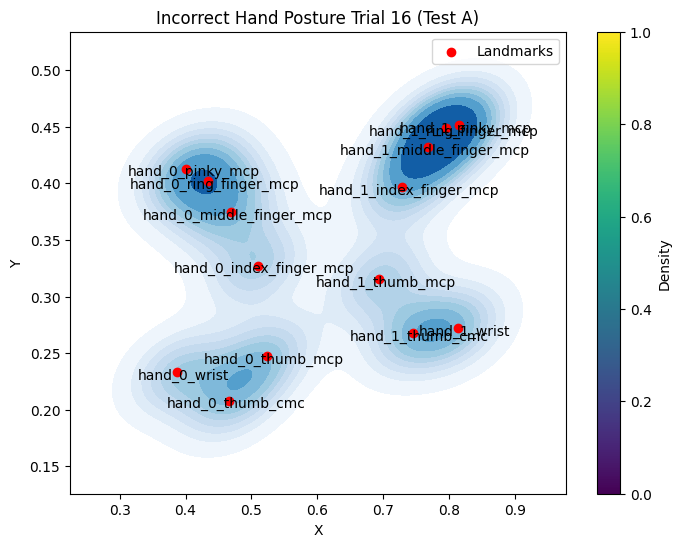

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 16 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_16.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.221571,0.203250,1.401075e-07,0
1,hand_0_thumb_cmc,0.295586,0.225551,-2.133494e-02,0
2,hand_0_thumb_mcp,0.351420,0.298139,-3.427551e-02,0
3,hand_0_index_finger_mcp,0.298302,0.426756,-6.242017e-02,0
4,hand_0_middle_finger_mcp,0.255222,0.469617,-4.958379e-02,0
5,hand_0_ring_finger_mcp,0.226396,0.483060,-3.353821e-02,0
6,hand_0_pinky_mcp,0.209991,0.474839,-1.649486e-02,0
7,hand_1_wrist,0.759158,0.259884,6.169387e-07,1
8,hand_1_thumb_cmc,0.693940,0.278335,-2.874100e-02,1
9,hand_1_thumb_mcp,0.639068,0.345264,-4.604254e-02,1


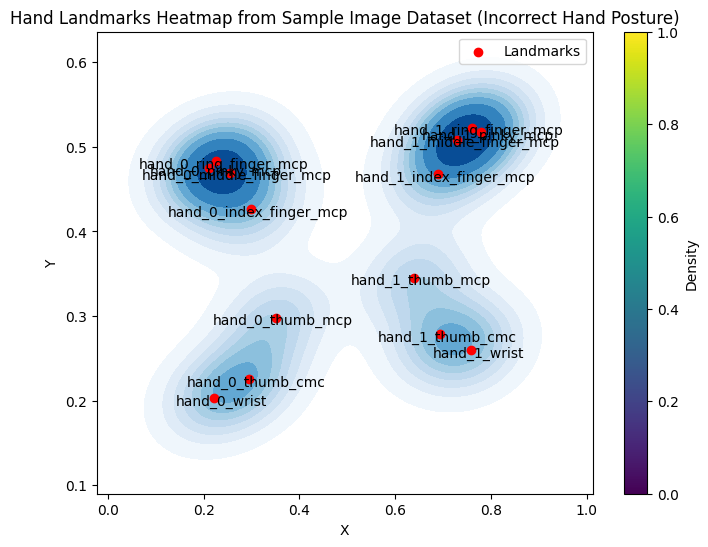

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 17 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect17.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.358157,0.216097,5.746669e-08,0
1,hand_0_thumb_cmc,0.448496,0.220146,2.455643e-02,0
2,hand_0_thumb_mcp,0.497491,0.265006,3.297582e-02,0
3,hand_0_index_finger_mcp,0.480862,0.362546,-3.864544e-02,0
4,hand_0_middle_finger_mcp,0.432875,0.398645,-3.525317e-02,0
5,hand_0_ring_finger_mcp,0.393357,0.412585,-2.203605e-02,0
6,hand_0_pinky_mcp,0.360411,0.413118,-3.253397e-03,0
7,hand_1_wrist,0.790683,0.270754,5.765644e-07,1
8,hand_1_thumb_cmc,0.715726,0.287203,-1.425874e-02,1
9,hand_1_thumb_mcp,0.669705,0.345353,-2.123930e-02,1


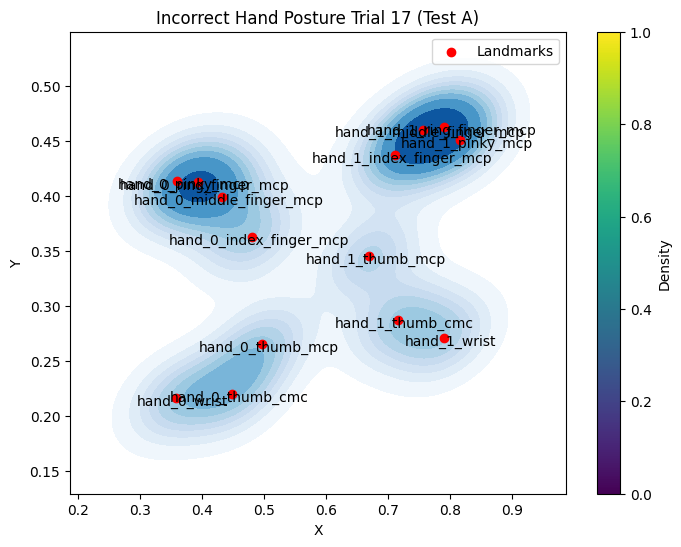

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 17 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_17.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.249080,0.236154,-4.820354e-08,0
1,hand_0_thumb_cmc,0.322104,0.265971,-1.521470e-02,0
2,hand_0_thumb_mcp,0.373236,0.348834,-2.910119e-02,0
3,hand_0_index_finger_mcp,0.327666,0.440931,-7.440128e-02,0
4,hand_0_middle_finger_mcp,0.283270,0.481842,-6.534092e-02,0
5,hand_0_ring_finger_mcp,0.249258,0.499412,-5.233878e-02,0
6,hand_0_pinky_mcp,0.226254,0.493911,-3.839520e-02,0
7,hand_1_wrist,0.726138,0.334221,4.537627e-07,1
8,hand_1_thumb_cmc,0.657324,0.343111,-1.021852e-02,1
9,hand_1_thumb_mcp,0.602139,0.410237,-2.134844e-02,1


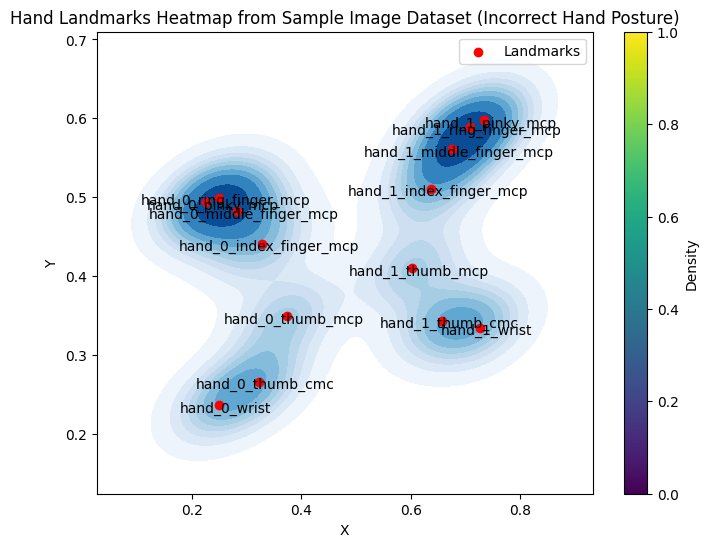

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 18 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect18.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.362557,0.216679,-5.486500e-08,0
1,hand_0_thumb_cmc,0.450863,0.210033,1.409010e-02,0
2,hand_0_thumb_mcp,0.505277,0.258028,2.350030e-02,0
3,hand_0_index_finger_mcp,0.492608,0.352897,-1.885511e-02,0
4,hand_0_middle_finger_mcp,0.451868,0.395259,-1.404689e-02,0
5,hand_0_ring_finger_mcp,0.416681,0.414094,-2.793273e-03,0
6,hand_0_pinky_mcp,0.384689,0.419109,1.198992e-02,0
7,hand_1_wrist,0.797195,0.260751,3.674688e-07,1
8,hand_1_thumb_cmc,0.721725,0.285973,3.091390e-03,1
9,hand_1_thumb_mcp,0.673827,0.346224,8.207770e-03,1


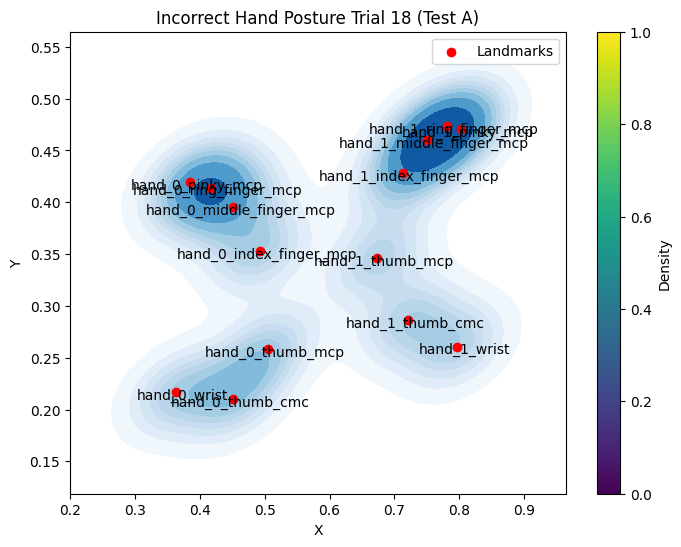

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 18 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_17.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.249080,0.236154,-4.820354e-08,0
1,hand_0_thumb_cmc,0.322104,0.265971,-1.521470e-02,0
2,hand_0_thumb_mcp,0.373236,0.348834,-2.910119e-02,0
3,hand_0_index_finger_mcp,0.327666,0.440931,-7.440128e-02,0
4,hand_0_middle_finger_mcp,0.283270,0.481842,-6.534092e-02,0
5,hand_0_ring_finger_mcp,0.249258,0.499412,-5.233878e-02,0
6,hand_0_pinky_mcp,0.226254,0.493911,-3.839520e-02,0
7,hand_1_wrist,0.726138,0.334221,4.537627e-07,1
8,hand_1_thumb_cmc,0.657324,0.343111,-1.021852e-02,1
9,hand_1_thumb_mcp,0.602139,0.410237,-2.134844e-02,1


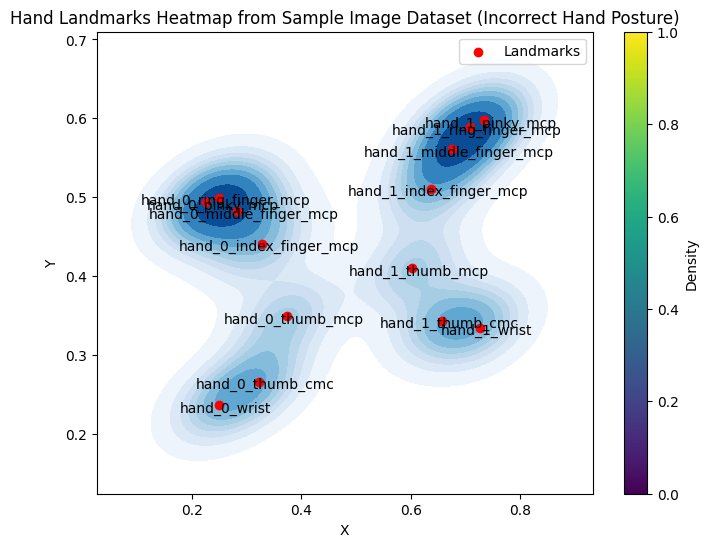

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 19 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect19.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.359567,0.206753,-1.679162e-08,0
1,hand_0_thumb_cmc,0.447059,0.197418,1.314773e-02,0
2,hand_0_thumb_mcp,0.504815,0.236855,2.209073e-02,0
3,hand_0_index_finger_mcp,0.489643,0.349364,-7.592843e-03,0
4,hand_0_middle_finger_mcp,0.447291,0.395187,-3.950644e-03,0
5,hand_0_ring_finger_mcp,0.411829,0.413700,5.142830e-03,0
6,hand_0_pinky_mcp,0.379102,0.411087,1.747997e-02,0
7,hand_1_wrist,0.797458,0.258006,3.942075e-07,1
8,hand_1_thumb_cmc,0.719665,0.276913,-3.526723e-03,1
9,hand_1_thumb_mcp,0.667268,0.334896,-2.311310e-03,1


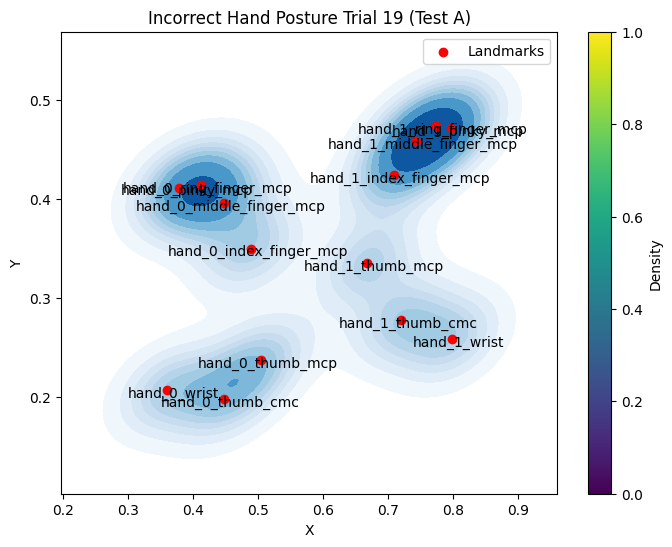

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 19 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_19.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.279607,0.258844,1.659505e-08,0
1,hand_0_thumb_cmc,0.355953,0.232976,-1.594661e-02,0
2,hand_0_thumb_mcp,0.416377,0.281383,-2.960046e-02,0
3,hand_0_index_finger_mcp,0.375952,0.389981,-6.620834e-02,0
4,hand_0_middle_finger_mcp,0.338234,0.453532,-5.969057e-02,0
5,hand_0_ring_finger_mcp,0.311718,0.489603,-4.966024e-02,0
6,hand_0_pinky_mcp,0.294169,0.498116,-3.820916e-02,0
7,hand_1_wrist,0.745487,0.352535,4.691549e-07,1
8,hand_1_thumb_cmc,0.680880,0.339330,-1.281844e-02,1
9,hand_1_thumb_mcp,0.625912,0.396110,-2.196011e-02,1


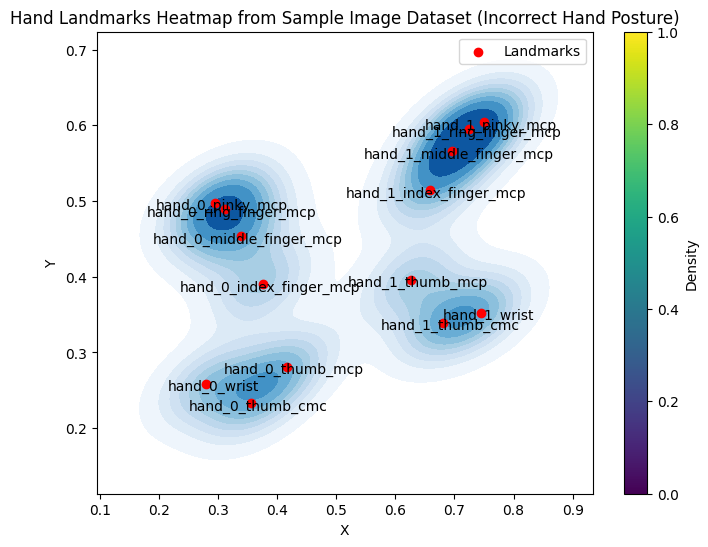

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 20 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect20.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.754951,0.200432,2.059527e-07,0
1,hand_0_thumb_cmc,0.694761,0.273487,5.718232e-03,0
2,hand_0_thumb_mcp,0.675920,0.360534,1.020674e-02,0
3,hand_0_index_finger_mcp,0.745843,0.424758,-1.545697e-03,0
4,hand_0_middle_finger_mcp,0.794514,0.409470,3.741866e-03,0
5,hand_0_ring_finger_mcp,0.828912,0.378325,1.140186e-02,0
6,hand_0_pinky_mcp,0.847481,0.339848,1.981450e-02,0
7,hand_1_wrist,0.371790,0.190942,2.197141e-07,1
8,hand_1_thumb_cmc,0.445589,0.278344,3.404842e-02,1
9,hand_1_thumb_mcp,0.467257,0.360696,4.854372e-02,1


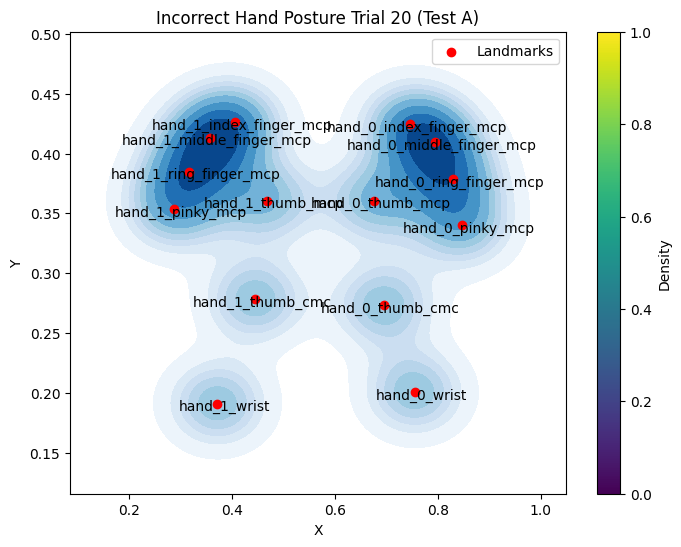

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 20 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_28.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.588556,0.071538,2.860371e-07,0
1,hand_0_thumb_cmc,0.540081,0.162721,-1.924556e-03,0
2,hand_0_thumb_mcp,0.522782,0.265533,-7.464602e-03,0
3,hand_0_index_finger_mcp,0.585997,0.317483,-4.157072e-02,0
4,hand_0_middle_finger_mcp,0.629377,0.293994,-3.894723e-02,0
5,hand_0_ring_finger_mcp,0.660091,0.258579,-3.338895e-02,0
6,hand_0_pinky_mcp,0.678407,0.215210,-2.666275e-02,0
7,hand_1_wrist,0.321821,0.072335,2.888922e-07,1
8,hand_1_thumb_cmc,0.377994,0.147053,-1.800605e-02,1
9,hand_1_thumb_mcp,0.401307,0.239428,-2.993636e-02,1


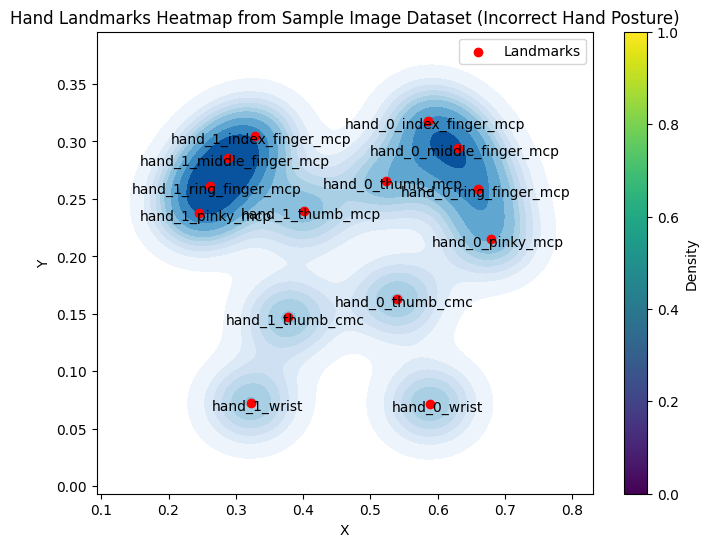

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 21 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect21.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.328453,0.238723,-2.056500e-07,0
1,hand_0_thumb_cmc,0.414810,0.270401,2.018374e-02,0
2,hand_0_thumb_mcp,0.455689,0.339371,3.601921e-02,0
3,hand_0_index_finger_mcp,0.407348,0.461004,2.206155e-02,0
4,hand_0_middle_finger_mcp,0.350345,0.469144,2.653603e-02,0
5,hand_0_ring_finger_mcp,0.306305,0.456096,3.414802e-02,0
6,hand_0_pinky_mcp,0.270999,0.423106,4.376320e-02,0
7,hand_1_wrist,0.853872,0.256020,2.327624e-07,1
8,hand_1_thumb_cmc,0.780192,0.289210,6.667266e-03,1
9,hand_1_thumb_mcp,0.737455,0.352786,1.777887e-02,1


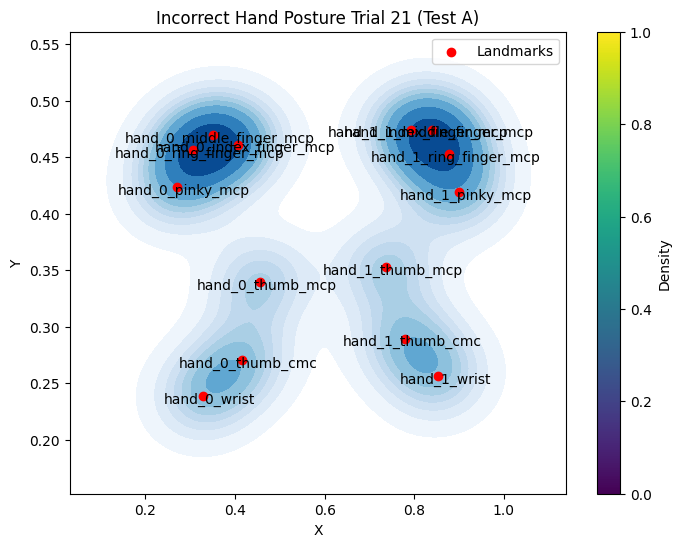

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 21 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_21.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.262140,0.251528,7.118839e-08,0
1,hand_0_thumb_cmc,0.335846,0.272857,5.835561e-03,0
2,hand_0_thumb_mcp,0.373441,0.362820,9.291819e-03,0
3,hand_0_index_finger_mcp,0.336070,0.511473,-1.180139e-02,0
4,hand_0_middle_finger_mcp,0.282843,0.525079,-9.814501e-03,0
5,hand_0_ring_finger_mcp,0.240869,0.510172,-6.028288e-03,0
6,hand_0_pinky_mcp,0.211026,0.473269,-8.870973e-04,0
7,hand_1_wrist,0.679730,0.199825,7.387958e-08,1
8,hand_1_thumb_cmc,0.607661,0.259189,1.354910e-02,1
9,hand_1_thumb_mcp,0.579885,0.355343,2.131868e-02,1


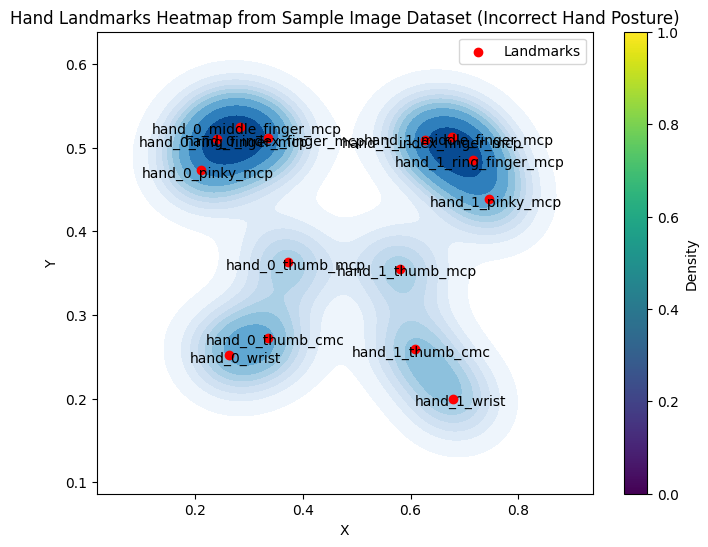

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 22 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect22.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.815668,0.204917,5.501843e-07,0
1,hand_0_thumb_cmc,0.755267,0.235949,-3.351916e-02,0
2,hand_0_thumb_mcp,0.712063,0.300996,-5.481422e-02,0
3,hand_0_index_finger_mcp,0.783248,0.340386,-8.175220e-02,0
4,hand_0_middle_finger_mcp,0.828145,0.353801,-6.694386e-02,0
5,hand_0_ring_finger_mcp,0.857358,0.361501,-5.020371e-02,0
6,hand_0_pinky_mcp,0.874282,0.364059,-3.470134e-02,0
7,hand_1_wrist,0.380371,0.206767,4.057037e-07,1
8,hand_1_thumb_cmc,0.458263,0.227585,-5.268909e-03,1
9,hand_1_thumb_mcp,0.507688,0.295832,-1.990167e-02,1


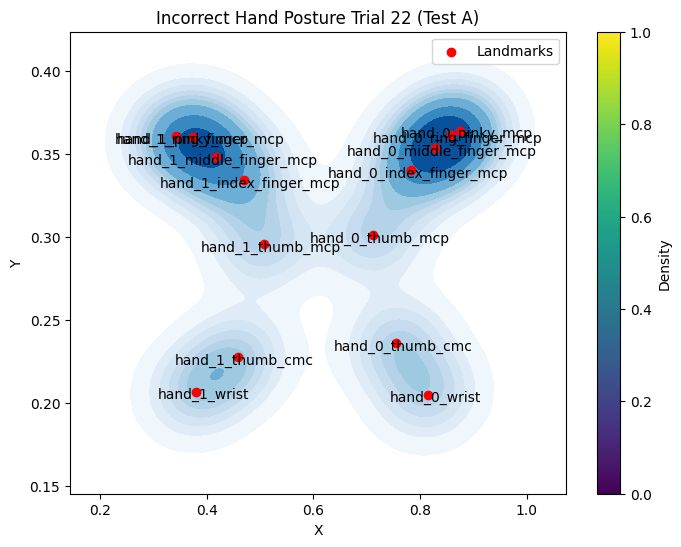

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 22 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_22.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.646799,0.153267,5.187538e-07,0
1,hand_0_thumb_cmc,0.585999,0.218127,-2.312162e-02,0
2,hand_0_thumb_mcp,0.541158,0.303337,-4.415759e-02,0
3,hand_0_index_finger_mcp,0.609143,0.334432,-8.816756e-02,0
4,hand_0_middle_finger_mcp,0.656521,0.341187,-7.988741e-02,0
5,hand_0_ring_finger_mcp,0.692625,0.342948,-6.805626e-02,0
6,hand_0_pinky_mcp,0.717651,0.336499,-5.663103e-02,0
7,hand_1_wrist,0.277554,0.156137,1.842729e-07,1
8,hand_1_thumb_cmc,0.340758,0.199091,-2.195488e-02,1
9,hand_1_thumb_mcp,0.379131,0.292680,-4.103962e-02,1


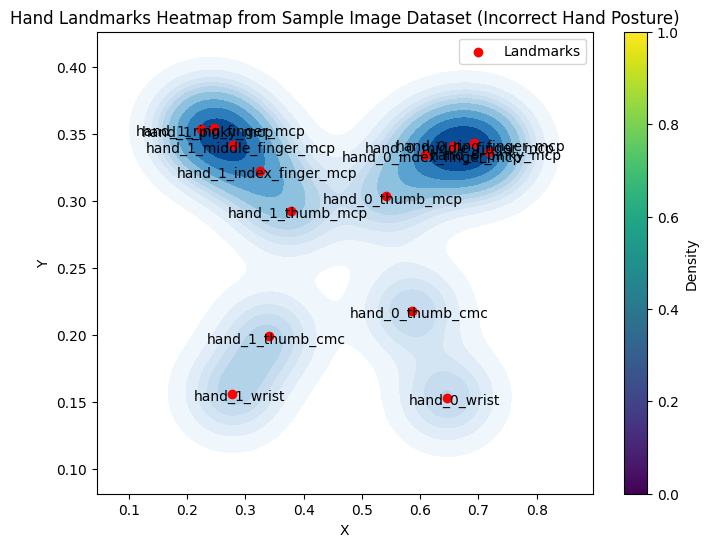

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 23 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect23.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.810537,0.199950,5.431698e-07,0
1,hand_0_thumb_cmc,0.750028,0.240973,-2.837306e-02,0
2,hand_0_thumb_mcp,0.709299,0.304678,-4.959056e-02,0
3,hand_0_index_finger_mcp,0.782157,0.353613,-7.167232e-02,0
4,hand_0_middle_finger_mcp,0.827129,0.364665,-5.984094e-02,0
5,hand_0_ring_finger_mcp,0.858630,0.366700,-4.621894e-02,0
6,hand_0_pinky_mcp,0.878410,0.363408,-3.375046e-02,0
7,hand_1_wrist,0.383117,0.207734,3.325289e-07,1
8,hand_1_thumb_cmc,0.461074,0.227192,-4.900888e-03,1
9,hand_1_thumb_mcp,0.509736,0.291009,-1.848389e-02,1


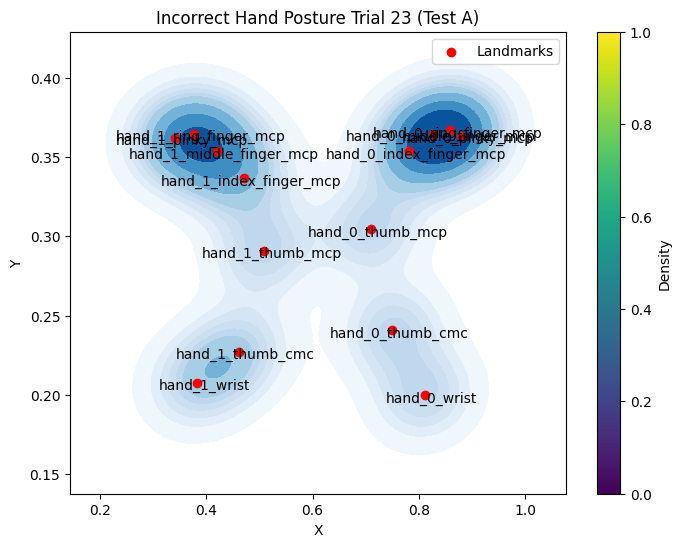

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 23 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_23.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.641252,0.126679,5.580998e-07,0
1,hand_0_thumb_cmc,0.582932,0.184493,-2.594783e-02,0
2,hand_0_thumb_mcp,0.542077,0.272594,-5.224584e-02,0
3,hand_0_index_finger_mcp,0.606664,0.280875,-1.109124e-01,0
4,hand_0_middle_finger_mcp,0.654644,0.284861,-1.032668e-01,0
5,hand_0_ring_finger_mcp,0.689976,0.285855,-9.184128e-02,0
6,hand_0_pinky_mcp,0.714755,0.281097,-8.070564e-02,0
7,hand_1_wrist,0.245483,0.175100,1.167039e-07,1
8,hand_1_thumb_cmc,0.302345,0.187833,-3.855608e-02,1
9,hand_1_thumb_mcp,0.356373,0.248597,-6.470603e-02,1


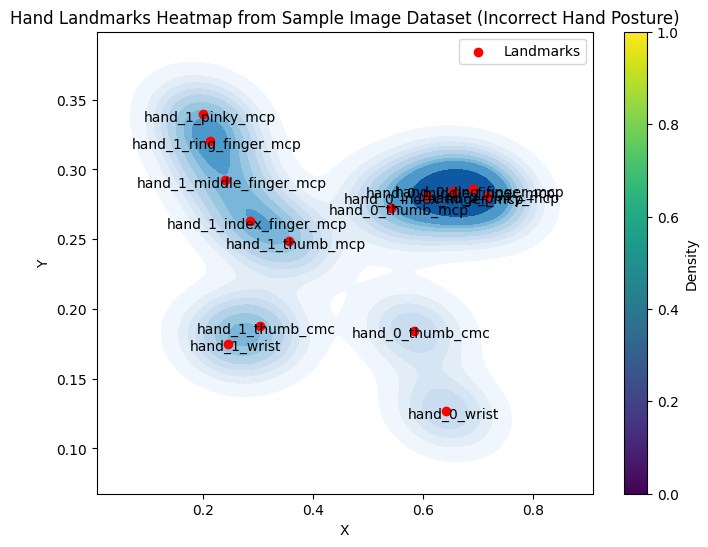

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 24 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_24.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.634093,0.127626,4.961032e-07,0
1,hand_0_thumb_cmc,0.574541,0.187707,-1.470942e-02,0
2,hand_0_thumb_mcp,0.534409,0.270764,-2.867918e-02,0
3,hand_0_index_finger_mcp,0.597153,0.349609,-5.401595e-02,0
4,hand_0_middle_finger_mcp,0.643155,0.355119,-5.015194e-02,0
5,hand_0_ring_finger_mcp,0.676897,0.344460,-4.444902e-02,0
6,hand_0_pinky_mcp,0.699790,0.321896,-3.916342e-02,0
7,hand_1_wrist,0.292022,0.139609,3.446586e-07,1
8,hand_1_thumb_cmc,0.339713,0.236503,-1.912202e-02,1
9,hand_1_thumb_mcp,0.355734,0.333581,-3.340580e-02,1


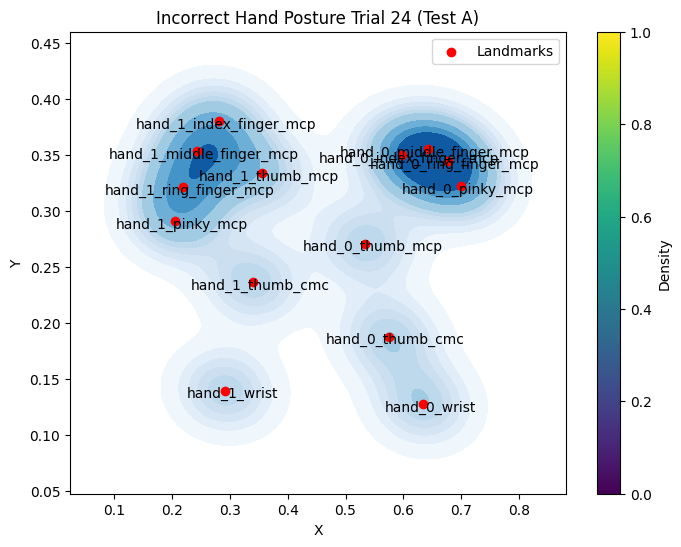

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 24 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_24.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.634093,0.127626,4.961032e-07,0
1,hand_0_thumb_cmc,0.574541,0.187707,-1.470942e-02,0
2,hand_0_thumb_mcp,0.534409,0.270764,-2.867918e-02,0
3,hand_0_index_finger_mcp,0.597153,0.349609,-5.401595e-02,0
4,hand_0_middle_finger_mcp,0.643155,0.355119,-5.015194e-02,0
5,hand_0_ring_finger_mcp,0.676897,0.344460,-4.444902e-02,0
6,hand_0_pinky_mcp,0.699790,0.321896,-3.916342e-02,0
7,hand_1_wrist,0.292022,0.139609,3.446586e-07,1
8,hand_1_thumb_cmc,0.339713,0.236503,-1.912202e-02,1
9,hand_1_thumb_mcp,0.355734,0.333581,-3.340580e-02,1


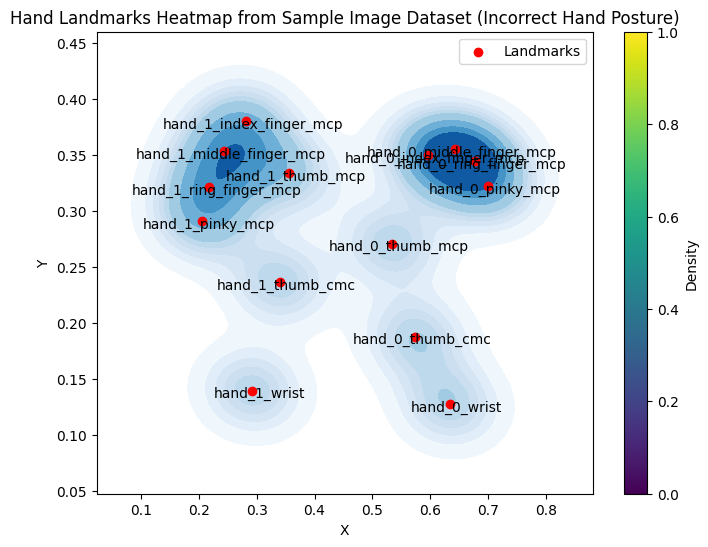

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 25 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect25.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.812032,0.220358,6.606236e-07,0
1,hand_0_thumb_cmc,0.747775,0.231897,-2.879993e-02,0
2,hand_0_thumb_mcp,0.699199,0.283486,-4.918768e-02,0
3,hand_0_index_finger_mcp,0.750972,0.341132,-7.921363e-02,0
4,hand_0_middle_finger_mcp,0.791955,0.370139,-6.738196e-02,0
5,hand_0_ring_finger_mcp,0.822369,0.385880,-5.375943e-02,0
6,hand_0_pinky_mcp,0.841125,0.390815,-4.063261e-02,0
7,hand_1_wrist,0.373599,0.209846,1.473952e-07,1
8,hand_1_thumb_cmc,0.448761,0.199059,-6.541701e-03,1
9,hand_1_thumb_mcp,0.505013,0.239776,-1.870107e-02,1


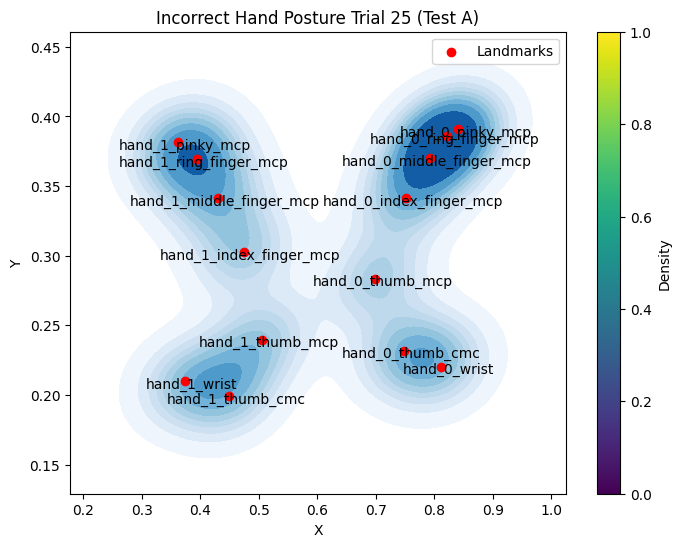

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 25 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect26.png'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.808253,0.219838,6.110891e-07,0
1,hand_0_thumb_cmc,0.749402,0.227663,-1.773224e-02,0
2,hand_0_thumb_mcp,0.706122,0.284065,-3.634727e-02,0
3,hand_0_index_finger_mcp,0.743226,0.327611,-7.696673e-02,0
4,hand_0_middle_finger_mcp,0.781685,0.361117,-7.039496e-02,0
5,hand_0_ring_finger_mcp,0.812335,0.382318,-6.103972e-02,0
6,hand_0_pinky_mcp,0.831816,0.391060,-5.131140e-02,0
7,hand_1_wrist,0.372528,0.207123,1.237539e-07,1
8,hand_1_thumb_cmc,0.446643,0.179858,-6.150045e-03,1
9,hand_1_thumb_mcp,0.503686,0.212557,-1.540411e-02,1


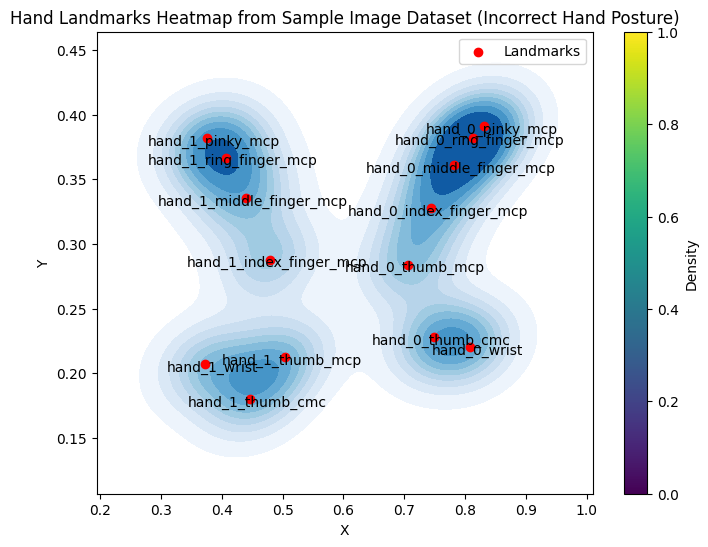

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 26 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_26.jpg'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.287404,0.302535,-1.695875e-07,0
1,hand_0_thumb_cmc,0.370887,0.283930,-2.233477e-02,0
2,hand_0_thumb_mcp,0.427446,0.348520,-3.069759e-02,0
3,hand_0_index_finger_mcp,0.386413,0.485981,-5.394302e-02,0
4,hand_0_middle_finger_mcp,0.354025,0.540578,-3.699313e-02,0
5,hand_0_ring_finger_mcp,0.330107,0.566158,-1.652887e-02,0
6,hand_0_pinky_mcp,0.314211,0.569489,4.473468e-03,0
7,hand_1_wrist,0.786845,0.325077,4.278096e-07,1
8,hand_1_thumb_cmc,0.710711,0.327212,-1.611914e-02,1
9,hand_1_thumb_mcp,0.650767,0.391164,-2.924389e-02,1


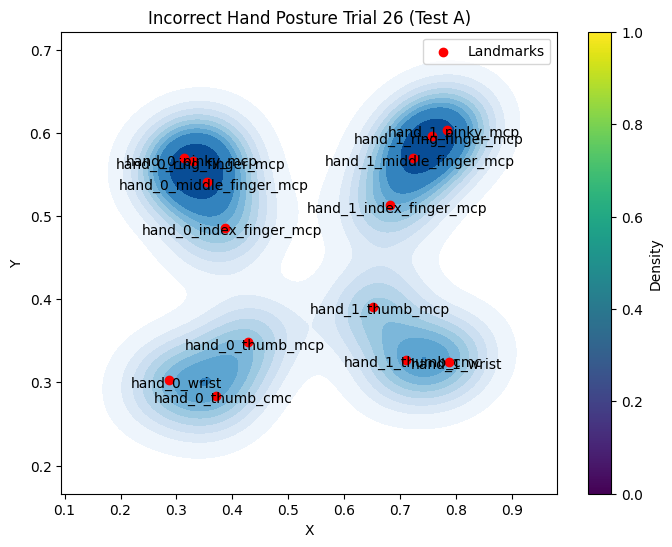

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 26 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_26.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.247541,0.076044,7.112953e-08,0
1,hand_0_thumb_cmc,0.309985,0.058157,-5.418939e-03,0
2,hand_0_thumb_mcp,0.359400,0.095304,-1.624586e-02,0
3,hand_0_index_finger_mcp,0.346540,0.167585,-5.559308e-02,0
4,hand_0_middle_finger_mcp,0.317231,0.225014,-5.677802e-02,0
5,hand_0_ring_finger_mcp,0.291956,0.269401,-5.500137e-02,0
6,hand_0_pinky_mcp,0.269646,0.296171,-5.184286e-02,0
7,hand_1_wrist,0.655357,0.138850,5.242775e-07,1
8,hand_1_thumb_cmc,0.598575,0.160053,-2.352802e-02,1
9,hand_1_thumb_mcp,0.550330,0.219604,-4.022190e-02,1


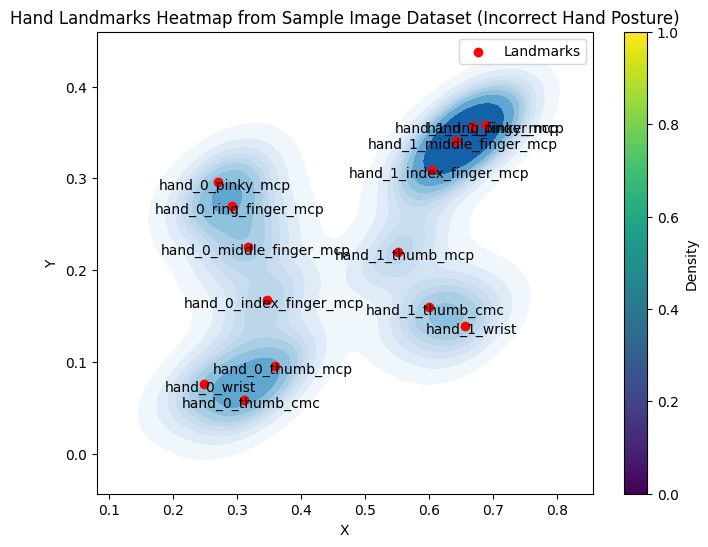

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 27 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect27.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.368883,0.196631,2.480456e-07,0
1,hand_0_thumb_cmc,0.433530,0.276575,-4.010598e-03,0
2,hand_0_thumb_mcp,0.453070,0.363476,-8.584991e-03,0
3,hand_0_index_finger_mcp,0.385455,0.406959,-3.960511e-02,0
4,hand_0_middle_finger_mcp,0.335111,0.390343,-3.561630e-02,0
5,hand_0_ring_finger_mcp,0.297914,0.363276,-2.834192e-02,0
6,hand_0_pinky_mcp,0.272299,0.330967,-1.985988e-02,0
7,hand_1_wrist,0.789112,0.199499,5.389766e-07,1
8,hand_1_thumb_cmc,0.732737,0.262359,-1.727892e-02,1
9,hand_1_thumb_mcp,0.708126,0.343220,-2.975253e-02,1


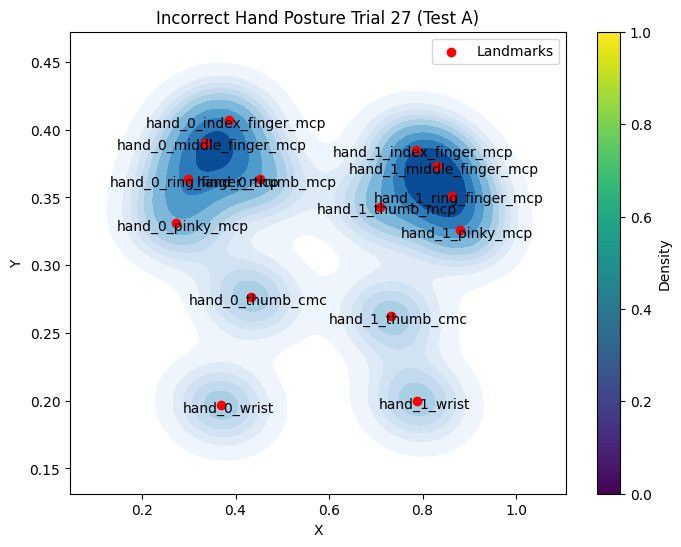

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 27 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_27.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.324497,0.165280,2.243871e-07,0
1,hand_0_thumb_cmc,0.396473,0.258607,-3.879253e-03,0
2,hand_0_thumb_mcp,0.421969,0.387383,-1.008742e-02,0
3,hand_0_index_finger_mcp,0.352993,0.478287,-4.323467e-02,0
4,hand_0_middle_finger_mcp,0.295619,0.462449,-4.143937e-02,0
5,hand_0_ring_finger_mcp,0.253919,0.426685,-3.701208e-02,0
6,hand_0_pinky_mcp,0.226064,0.380644,-3.102668e-02,0
7,hand_1_wrist,0.711953,0.151699,6.053054e-07,1
8,hand_1_thumb_cmc,0.642443,0.245338,-1.262429e-02,1
9,hand_1_thumb_mcp,0.612507,0.369630,-1.952440e-02,1


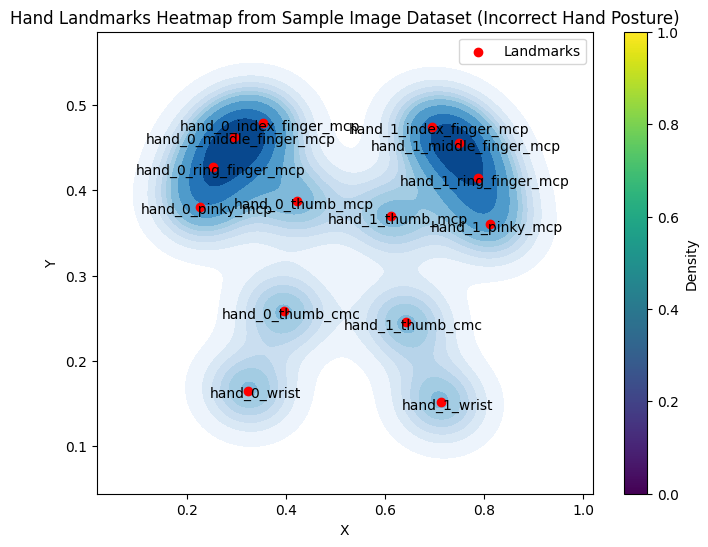

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 28 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect25.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.812032,0.220358,6.606236e-07,0
1,hand_0_thumb_cmc,0.747775,0.231897,-2.879993e-02,0
2,hand_0_thumb_mcp,0.699199,0.283486,-4.918768e-02,0
3,hand_0_index_finger_mcp,0.750972,0.341132,-7.921363e-02,0
4,hand_0_middle_finger_mcp,0.791955,0.370139,-6.738196e-02,0
5,hand_0_ring_finger_mcp,0.822369,0.385880,-5.375943e-02,0
6,hand_0_pinky_mcp,0.841125,0.390815,-4.063261e-02,0
7,hand_1_wrist,0.373599,0.209846,1.473952e-07,1
8,hand_1_thumb_cmc,0.448761,0.199059,-6.541701e-03,1
9,hand_1_thumb_mcp,0.505013,0.239776,-1.870107e-02,1


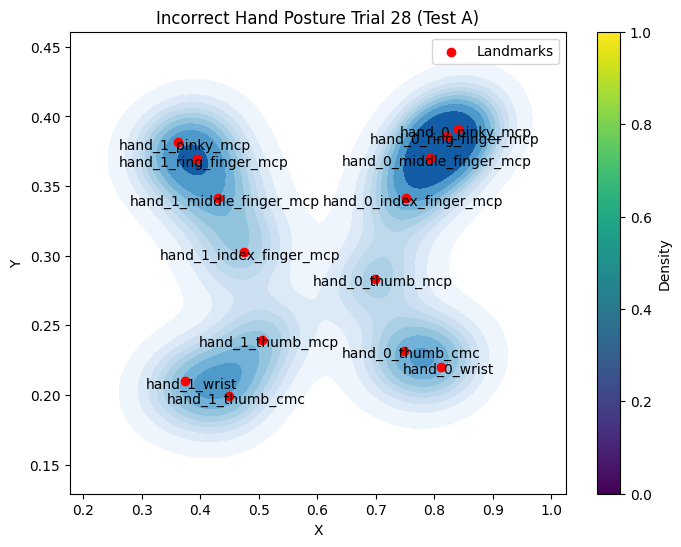

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 28 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_28.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.267102,0.131494,-2.533798e-08,0
1,hand_0_thumb_cmc,0.353554,0.122908,-9.780089e-03,0
2,hand_0_thumb_mcp,0.414047,0.195949,-1.949200e-02,0
3,hand_0_index_finger_mcp,0.375476,0.281068,-6.249581e-02,0
4,hand_0_middle_finger_mcp,0.333198,0.345174,-5.880834e-02,0
5,hand_0_ring_finger_mcp,0.301273,0.386954,-5.126857e-02,0
6,hand_0_pinky_mcp,0.277712,0.406072,-4.200283e-02,0
7,hand_1_wrist,0.791205,0.178886,5.297179e-07,1
8,hand_1_thumb_cmc,0.714666,0.207907,-1.418898e-02,1
9,hand_1_thumb_mcp,0.658108,0.283432,-2.943693e-02,1


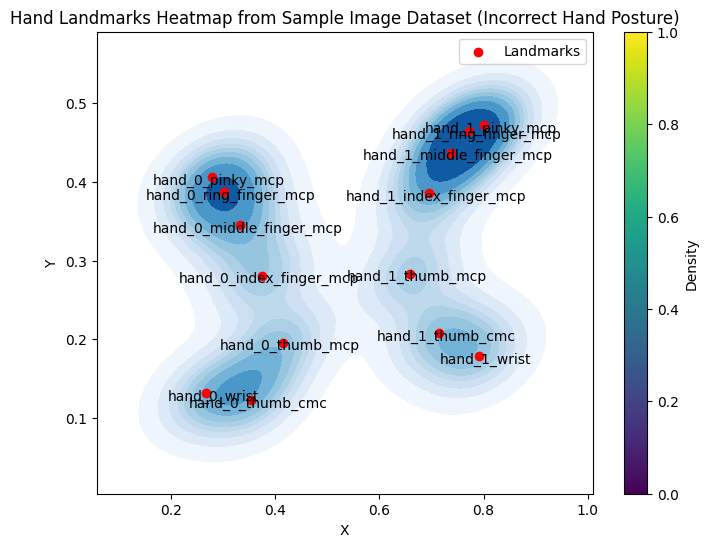

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 29 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect29.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.807668,0.227551,6.652644e-07,0
1,hand_0_thumb_cmc,0.745919,0.230024,-3.076808e-02,0
2,hand_0_thumb_mcp,0.695140,0.267809,-5.358271e-02,0
3,hand_0_index_finger_mcp,0.740741,0.351117,-8.175330e-02,0
4,hand_0_middle_finger_mcp,0.778379,0.383504,-6.773383e-02,0
5,hand_0_ring_finger_mcp,0.806053,0.400947,-5.165915e-02,0
6,hand_0_pinky_mcp,0.826984,0.404505,-3.592516e-02,0
7,hand_1_wrist,0.369593,0.201567,1.339783e-07,1
8,hand_1_thumb_cmc,0.444219,0.172149,-6.643275e-03,1
9,hand_1_thumb_mcp,0.500821,0.200582,-1.550826e-02,1


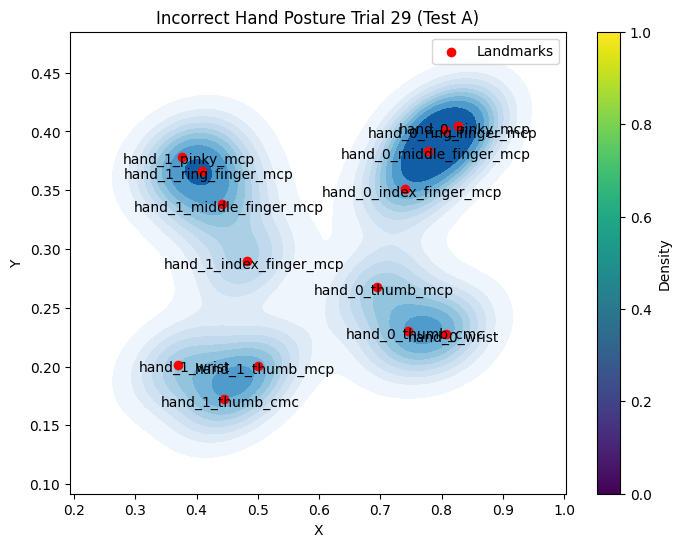

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 29 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/Inc_Trial_29.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.672654,0.114585,4.571574e-07,0
1,hand_0_thumb_cmc,0.616931,0.133838,-2.320038e-02,0
2,hand_0_thumb_mcp,0.565491,0.193331,-4.053844e-02,0
3,hand_0_index_finger_mcp,0.622153,0.292247,-7.089853e-02,0
4,hand_0_middle_finger_mcp,0.659038,0.323139,-6.038036e-02,0
5,hand_0_ring_finger_mcp,0.685015,0.337884,-4.766827e-02,0
6,hand_0_pinky_mcp,0.704072,0.335325,-3.523594e-02,0
7,hand_1_wrist,0.257168,0.099650,5.505121e-09,1
8,hand_1_thumb_cmc,0.323547,0.100151,-1.339394e-02,1
9,hand_1_thumb_mcp,0.373399,0.153014,-2.408130e-02,1


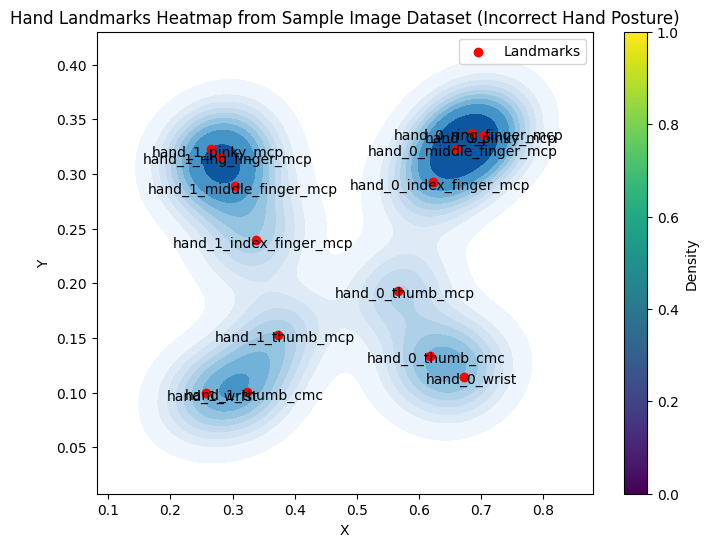

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

###**Trial 30 Comparison**

Trial 1

In [ ]:
trial2_inc = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Rotated Incorrect/TestA_incorrect21.png'

In [ ]:
test_inc2_landmarks = extract_landmarks(trial2_inc)

In [ ]:
import pandas as pd
incorrect_trial2_data = []
for hand_idx, hand_landmarks in enumerate(test_inc2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    first_trial2_data = pd.DataFrame(data)
    first_trial2_data['Hand'] = hand_idx
    trial2_data = incorrect_trial2_data.append(first_trial2_data)

inc_trial2_data = pd.concat(incorrect_trial2_data, ignore_index=True)
print("Incorrect Hand Posture Trial 2 (Test A)")
inc_trial2_data

Incorrect Hand Posture Trial 2 (Test A)


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.328453,0.238723,-2.056500e-07,0
1,hand_0_thumb_cmc,0.414810,0.270401,2.018374e-02,0
2,hand_0_thumb_mcp,0.455689,0.339371,3.601921e-02,0
3,hand_0_index_finger_mcp,0.407348,0.461004,2.206155e-02,0
4,hand_0_middle_finger_mcp,0.350345,0.469144,2.653603e-02,0
5,hand_0_ring_finger_mcp,0.306305,0.456096,3.414802e-02,0
6,hand_0_pinky_mcp,0.270999,0.423106,4.376320e-02,0
7,hand_1_wrist,0.853872,0.256020,2.327624e-07,1
8,hand_1_thumb_cmc,0.780192,0.289210,6.667266e-03,1
9,hand_1_thumb_mcp,0.737455,0.352786,1.777887e-02,1


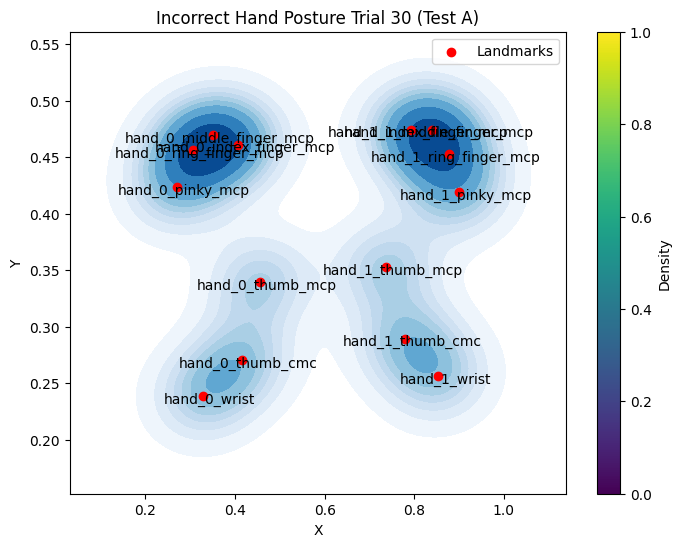

In [ ]:
# XY Coordinates
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_trial2_data['X'], y=inc_trial2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_trial2_data['X'], inc_trial2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_trial2_data['Landmark']):
    plt.annotate(landmark, (inc_trial2_data['X'][i], inc_trial2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Incorrect Hand Posture Trial 30 (Test A)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

Sample Dataset

In [ ]:
sample_incorrect2 = '/content/drive/MyDrive/TEAM 29 - FINALEST/Modified Hand Postures Dataset/Sample Incorrect/sample_trial_30.jpg'
sample_incorrect2_landmarks = extract_landmarks(sample_incorrect2)

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


In [ ]:
sample_incorrect2_data = []
for hand_idx, hand_landmarks in enumerate(sample_incorrect2_landmarks):
    data = {
        'Landmark': list(hand_landmarks.keys()),
        'X': [coords['X'] for coords in hand_landmarks.values()],
        'Y': [coords['Y'] for coords in hand_landmarks.values()],
        'Z': [coords['Z'] for coords in hand_landmarks.values()]
    }
    sample_trial2_data = pd.DataFrame(data)
    sample_trial2_data['Hand'] = hand_idx
    sample2_data = sample_incorrect2_data.append(sample_trial2_data)

inc_sample2_data = pd.concat(sample_incorrect2_data, ignore_index=True)
print("Incorrect Hand Posture from the Dataset")
inc_sample2_data

Incorrect Hand Posture from the Dataset


,Landmark,X,Y,Z,Hand
0,hand_0_wrist,0.218522,0.160483,-1.606161e-07,0
1,hand_0_thumb_cmc,0.301144,0.201667,2.868716e-03,0
2,hand_0_thumb_mcp,0.345972,0.299390,1.104504e-02,0
3,hand_0_index_finger_mcp,0.291296,0.495309,3.375106e-03,0
4,hand_0_middle_finger_mcp,0.230717,0.501922,1.219339e-02,0
5,hand_0_ring_finger_mcp,0.185412,0.475978,2.311390e-02,0
6,hand_0_pinky_mcp,0.152468,0.425150,3.517405e-02,0
7,hand_1_wrist,0.689515,0.150404,2.747963e-07,1
8,hand_1_thumb_cmc,0.604579,0.179960,1.049173e-02,1
9,hand_1_thumb_mcp,0.566549,0.287506,2.481099e-02,1


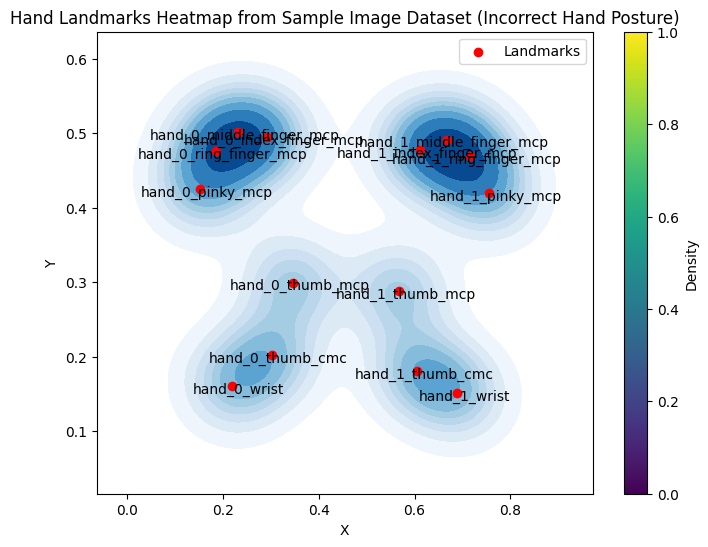

In [ ]:
plt.figure(figsize=(8, 6))
kde = sns.kdeplot(x=inc_sample2_data['X'], y=inc_sample2_data['Y'], fill=True, cmap="Blues", bw_adjust=0.5)
plt.scatter(inc_sample2_data['X'], inc_sample2_data['Y'], color='red', label='Landmarks')

# Annotate points
for i, landmark in enumerate(inc_sample2_data['Landmark']):
    plt.annotate(landmark, (inc_sample2_data['X'][i], inc_sample2_data['Y'][i]), textcoords="offset points", xytext=(5,-5), ha='center')

colorbar = plt.colorbar(kde.collections[0], ax=kde.axes)
colorbar.set_label('Density')

plt.title('Hand Landmarks Heatmap from Sample Image Dataset (Incorrect Hand Posture)')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()